#### Import required packages  


24-nov
    - add dbscan to basic clustering ...




<a name='toc'></a>  TOC

* <a href='#me.01.t1'> Modeling and Evaluation 1</a> :
            Train and adjust parameters  
            
  - <a href='#kmeans_lda'> Kmeans - LDA</a>
  - <a href='#kmeans_all_in'> Kmeans - all_in</a>
  - <a href='#DBScan'> DBScan</a>
  - <a href='#spectral_clustering'> Spectral Clustering</a>
  - <a href='#t-sne'> t-SNE</a>
  - <a href='#end_of_file'> end of file</a>


In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy

from pylab import rcParams
#import hdbscan

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

#### Read in cleaned  dataset from .csv file  

In [7]:
data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_03.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

#del df_cluster['data_channel']


# ... read in original data set to retreive 'shares' values


data_file = 'OnlineNewsPopularity.csv'

file_2_read = data_dir + data_file
df_ONP = pd.read_csv(file_2_read)

df_ONP.columns = df_ONP.columns.str.strip()

df_ONP = df_ONP[['shares']]

df_ONP['ln_shares'] = np.log(df_ONP['shares']+1)

df_ONP['popular'] = np.where(df_ONP['shares'] > 1400, True, False)


In [8]:

col_names = df_cluster.columns.values.tolist()
col_names
df_cluster.describe().T


col_names = df_cluster.columns.values.tolist()
col_names

['n_tokens_title',
 'num_keywords',
 'kw_avg_max',
 'weekday_is_monday',
 'weekday_is_tuesday',
 'weekday_is_wednesday',
 'weekday_is_thursday',
 'weekday_is_friday',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_data_channel_is_lifestyle',
 'ln_data_channel_is_entertainment',
 'ln_data_channel_is_socmed',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares']

,count,mean,std,min,25%,50%,75%,max
n_tokens_title,39644.0,10.398749,2.114037,2.0,9.000000,10.000000,12.000000,23.000000
num_keywords,39644.0,7.223767,1.909130,1.0,6.000000,7.000000,9.000000,10.000000
kw_avg_max,39644.0,1.913205,1.000000,0.0,1.271003,1.800325,2.442234,6.248298
weekday_is_monday,39644.0,0.168020,0.373889,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_tuesday,39644.0,0.186409,0.389441,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_wednesday,39644.0,0.187544,0.390353,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_thursday,39644.0,0.183306,0.386922,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_friday,39644.0,0.143805,0.350896,0.0,0.000000,0.000000,0.000000,1.000000
is_weekend,39644.0,0.130915,0.337312,0.0,0.000000,0.000000,0.000000,1.000000
global_subjectivity,39644.0,0.443370,0.116685,0.0,0.396167,0.453457,0.508333,1.000000


['n_tokens_title',
 'num_keywords',
 'kw_avg_max',
 'weekday_is_monday',
 'weekday_is_tuesday',
 'weekday_is_wednesday',
 'weekday_is_thursday',
 'weekday_is_friday',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_data_channel_is_lifestyle',
 'ln_data_channel_is_entertainment',
 'ln_data_channel_is_socmed',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares']

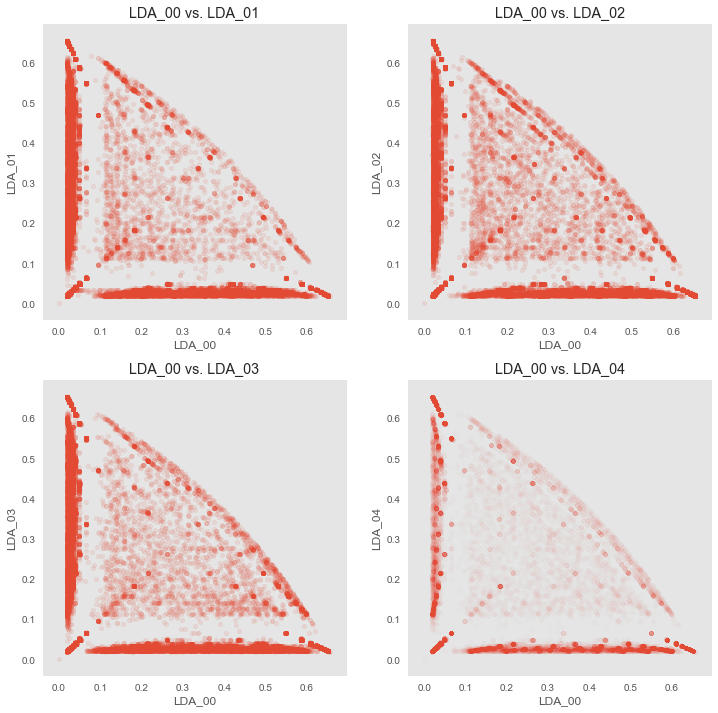

In [9]:
from matplotlib import pyplot as plt

plt.style.use("ggplot")

#%matplotlib inline

X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']].values


plt.figure(figsize = (12,12))
plt.subplot(221)

plt.scatter(X1[:, 1], X1[:, 0],
            s = 20,
           alpha = 0.10)
plt.xlabel('LDA_00'), plt.ylabel('LDA_01')
plt.grid()
plt.title('LDA_00 vs. LDA_01')


plt.subplot(222)
plt.scatter(X1[:, 2], X1[:, 0],
            s = 20,
           alpha = 0.10)
plt.xlabel('LDA_00'), plt.ylabel('LDA_02')
plt.grid()
plt.title('LDA_00 vs. LDA_02')


plt.subplot(223)
plt.scatter(X1[:, 3], X1[:, 0],
            s = 20,
            alpha = 0.10)
plt.xlabel('LDA_00'), plt.ylabel('LDA_03')
plt.grid()
plt.title('LDA_00 vs. LDA_03')


plt.subplot(224)
plt.scatter(X1[:, 4], X1[:, 0],
            s = 20,
           alpha = 0.01)
plt.xlabel('LDA_00'), plt.ylabel('LDA_04')
plt.grid()
plt.title('LDA_00 vs. LDA_04')

plt.show();



In [6]:
# set required variables for model comparison

comparison_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

<a href='#toc'> Table of Contents</a>

<a name='kmeans_lda'></a>
<font color="blue" size=3>  KMeans - LDA

### K-Means - LDA scores

In [81]:
X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]
type(X1)
X1.values

pandas.core.frame.DataFrame

array([[ 0.40568589,  0.32083557,  0.03922521,  0.04043406,  0.03933854],
       [ 0.58765093,  0.04883462,  0.04888183,  0.04888604,  0.04879084],
       [ 0.19703962,  0.03279091,  0.03280733,  0.03279002,  0.5200955 ],
       ..., 
       [ 0.14756142,  0.02471667,  0.02489488,  0.4970067 ,  0.13712368],
       [ 0.03922418,  0.03922407,  0.60975865,  0.03922273,  0.03922413],
       [ 0.04879137,  0.58741935,  0.04879056,  0.04941734,  0.04879077]])

n_lda =  2


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  6016.62121709
silhouette =  0.266625232023


(<matplotlib.text.Text at 0x7f8e3594a5c0>,
 <matplotlib.text.Text at 0x7f8e354d7160>)

(<matplotlib.text.Text at 0x7f8e354aec50>,
 <matplotlib.text.Text at 0x7f8e354bbe80>)

(<matplotlib.text.Text at 0x7f8e354ca7f0>,
 <matplotlib.text.Text at 0x7f8e35a9da58>)

(<matplotlib.text.Text at 0x7f8e35ae87f0>,
 <matplotlib.text.Text at 0x7f8e354276d8>)

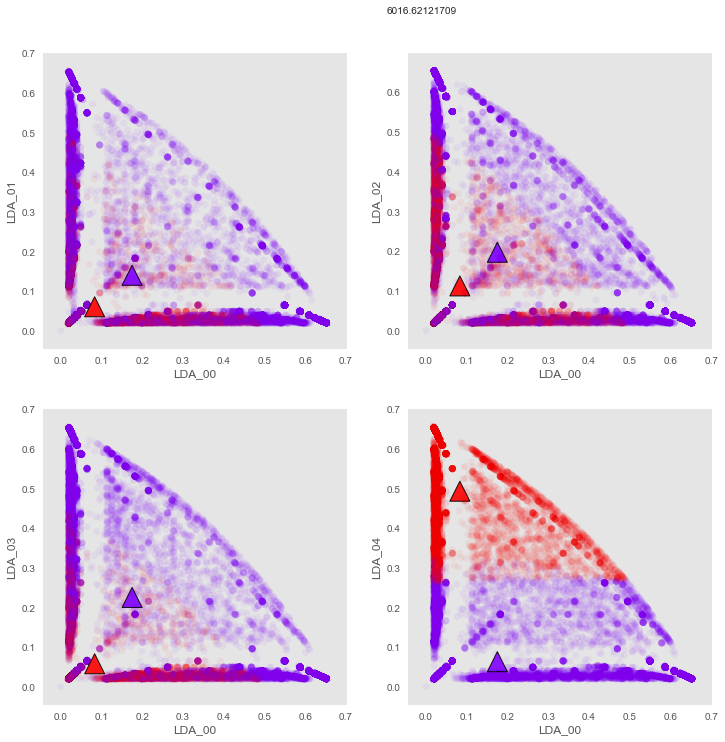

n_lda =  3


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  4120.02063847
silhouette =  0.384511692224


(<matplotlib.text.Text at 0x7f8e35b6c978>,
 <matplotlib.text.Text at 0x7f8e35bb9e80>)

(<matplotlib.text.Text at 0x7f8e359a1438>,
 <matplotlib.text.Text at 0x7f8e35b08f28>)

(<matplotlib.text.Text at 0x7f8e3425e358>,
 <matplotlib.text.Text at 0x7f8e35afc240>)

(<matplotlib.text.Text at 0x7f8e3424f5f8>,
 <matplotlib.text.Text at 0x7f8e341e7978>)

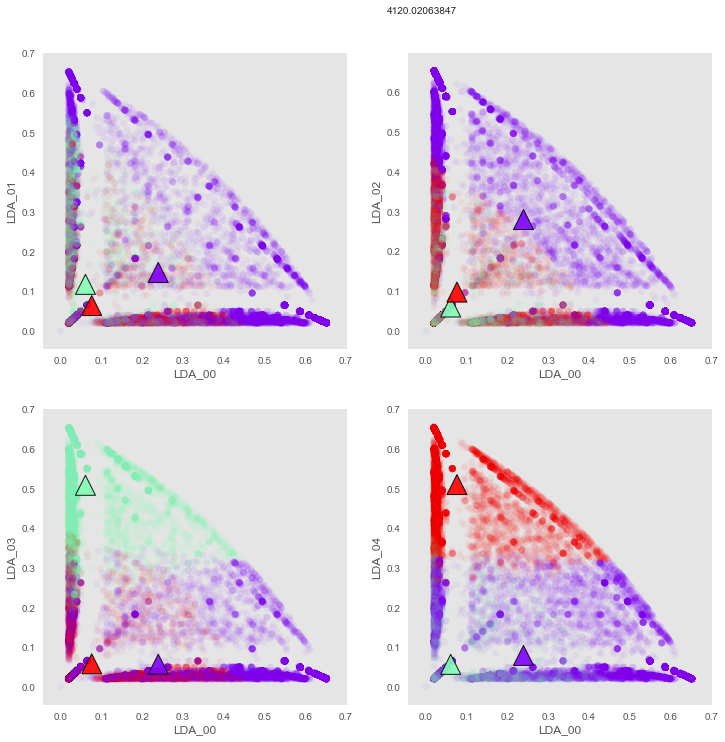

n_lda =  4


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  2523.83403252
silhouette =  0.501645423645


(<matplotlib.text.Text at 0x7f8e34129c18>,
 <matplotlib.text.Text at 0x7f8e34184c50>)

(<matplotlib.text.Text at 0x7f8e34109358>,
 <matplotlib.text.Text at 0x7f8e3406c278>)

(<matplotlib.text.Text at 0x7f8e2c706b00>,
 <matplotlib.text.Text at 0x7f8e3408d7b8>)

(<matplotlib.text.Text at 0x7f8e3421d048>,
 <matplotlib.text.Text at 0x7f8e34068278>)

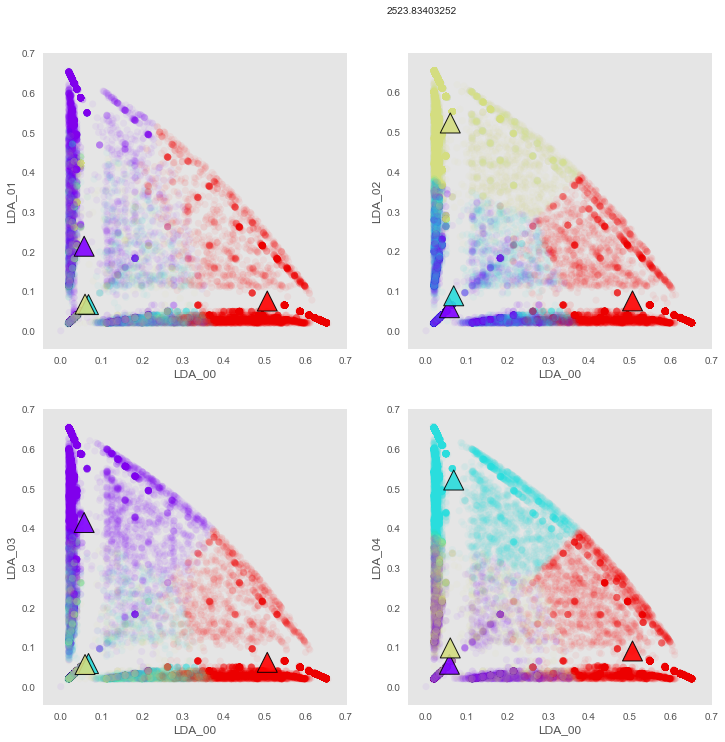

n_lda =  5


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  1418.81957692
silhouette =  0.564549085098


(<matplotlib.text.Text at 0x7f8e341f64a8>,
 <matplotlib.text.Text at 0x7f8e35435198>)

(<matplotlib.text.Text at 0x7f8e359ae438>,
 <matplotlib.text.Text at 0x7f8e35ac8eb8>)

(<matplotlib.text.Text at 0x7f8e35a1c4e0>,
 <matplotlib.text.Text at 0x7f8e35a48c88>)

(<matplotlib.text.Text at 0x7f8e35a691d0>,
 <matplotlib.text.Text at 0x7f8e359729e8>)

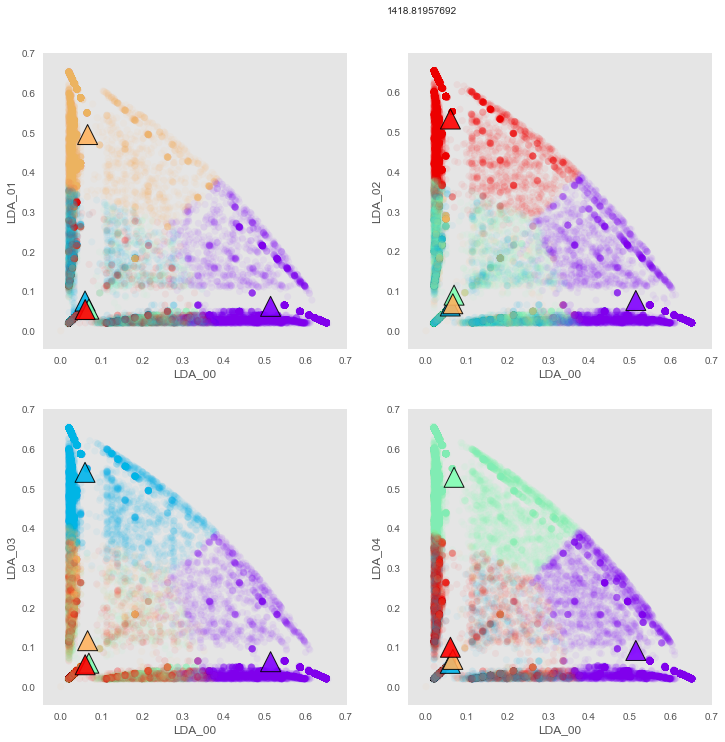

n_lda =  6


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  1257.64273723
silhouette =  0.521216884499


(<matplotlib.text.Text at 0x7f8e35a8ee48>,
 <matplotlib.text.Text at 0x7f8e2c741198>)

(<matplotlib.text.Text at 0x7f8e35446128>,
 <matplotlib.text.Text at 0x7f8e354221d0>)

(<matplotlib.text.Text at 0x7f8e3545c128>,
 <matplotlib.text.Text at 0x7f8e35514be0>)

(<matplotlib.text.Text at 0x7f8e2c6a13c8>,
 <matplotlib.text.Text at 0x7f8e2c68d5f8>)

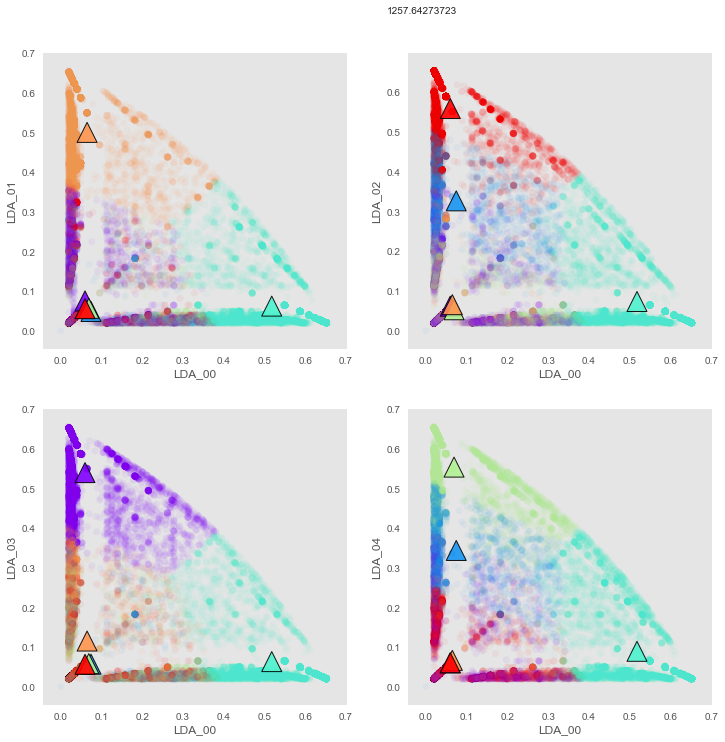

n_lda =  7


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  1135.46696089
silhouette =  0.506603738229


(<matplotlib.text.Text at 0x7f8e35a8ea20>,
 <matplotlib.text.Text at 0x7f8e2c741be0>)

(<matplotlib.text.Text at 0x7f8e35a5ba20>,
 <matplotlib.text.Text at 0x7f8e35addbe0>)

(<matplotlib.text.Text at 0x7f8e340b9198>,
 <matplotlib.text.Text at 0x7f8e35a1c128>)

(<matplotlib.text.Text at 0x7f8e35b9f940>,
 <matplotlib.text.Text at 0x7f8e3421b908>)

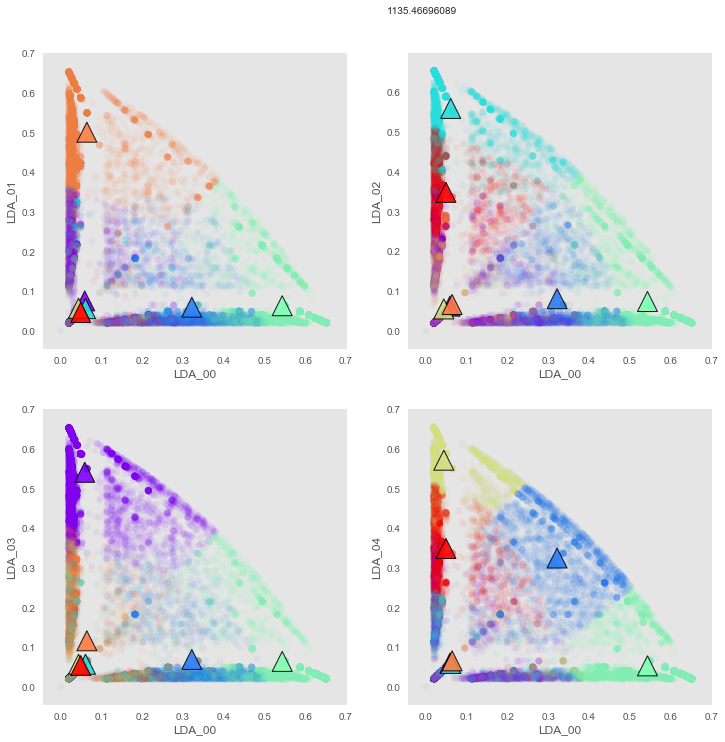

n_lda =  8


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  1023.64621652
silhouette =  0.470087897868


(<matplotlib.text.Text at 0x7f8e35a1f908>,
 <matplotlib.text.Text at 0x7f8e35a16fd0>)

(<matplotlib.text.Text at 0x7f8e3414a400>,
 <matplotlib.text.Text at 0x7f8e341d2240>)

(<matplotlib.text.Text at 0x7f8e340f5f98>,
 <matplotlib.text.Text at 0x7f8e341d1860>)

(<matplotlib.text.Text at 0x7f8e3405e278>,
 <matplotlib.text.Text at 0x7f8e340505f8>)

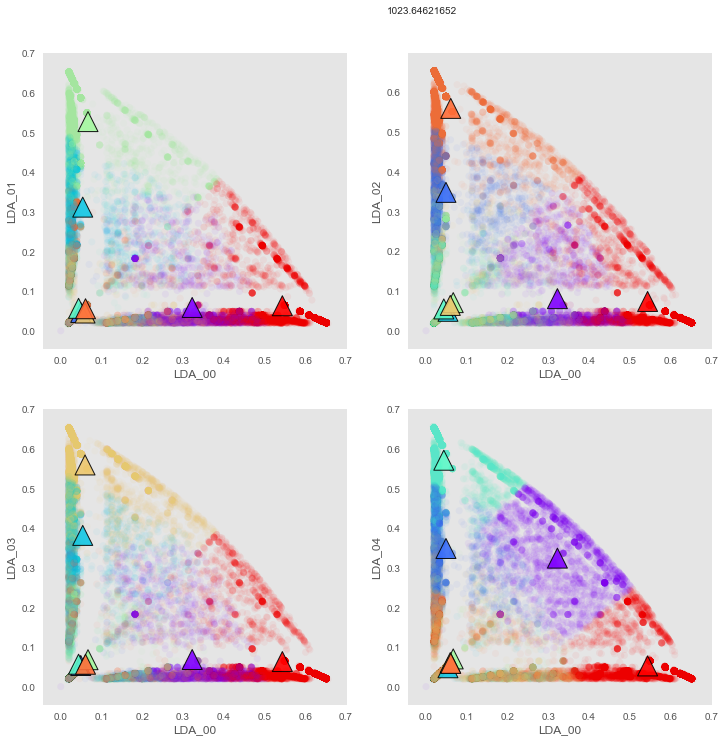

n_lda =  9


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  937.873675896
silhouette =  0.474417563079


(<matplotlib.text.Text at 0x7f8e35bba208>,
 <matplotlib.text.Text at 0x7f8e340617f0>)

(<matplotlib.text.Text at 0x7f8e35b26400>,
 <matplotlib.text.Text at 0x7f8e359ffdd8>)

(<matplotlib.text.Text at 0x7f8e3543ff28>,
 <matplotlib.text.Text at 0x7f8e34136828>)

(<matplotlib.text.Text at 0x7f8e35add860>,
 <matplotlib.text.Text at 0x7f8e35a7c390>)

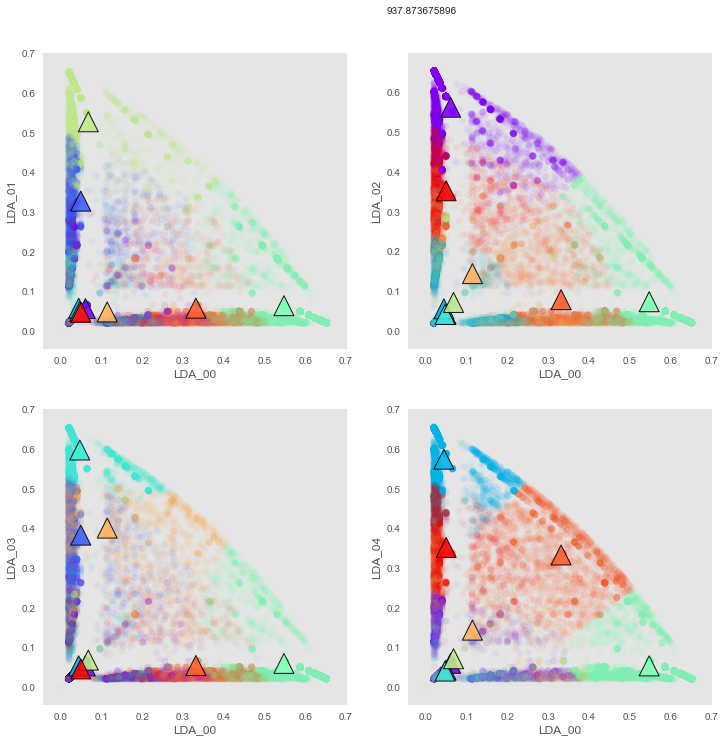

n_lda =  10


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  859.164016267
silhouette =  0.47973633816


(<matplotlib.text.Text at 0x7f8e35984550>,
 <matplotlib.text.Text at 0x7f8e341090f0>)

(<matplotlib.text.Text at 0x7f8e359d4be0>,
 <matplotlib.text.Text at 0x7f8e34109240>)

(<matplotlib.text.Text at 0x7f8e35a8f400>,
 <matplotlib.text.Text at 0x7f8e35ae8ba8>)

(<matplotlib.text.Text at 0x7f8e355046a0>,
 <matplotlib.text.Text at 0x7f8e355108d0>)

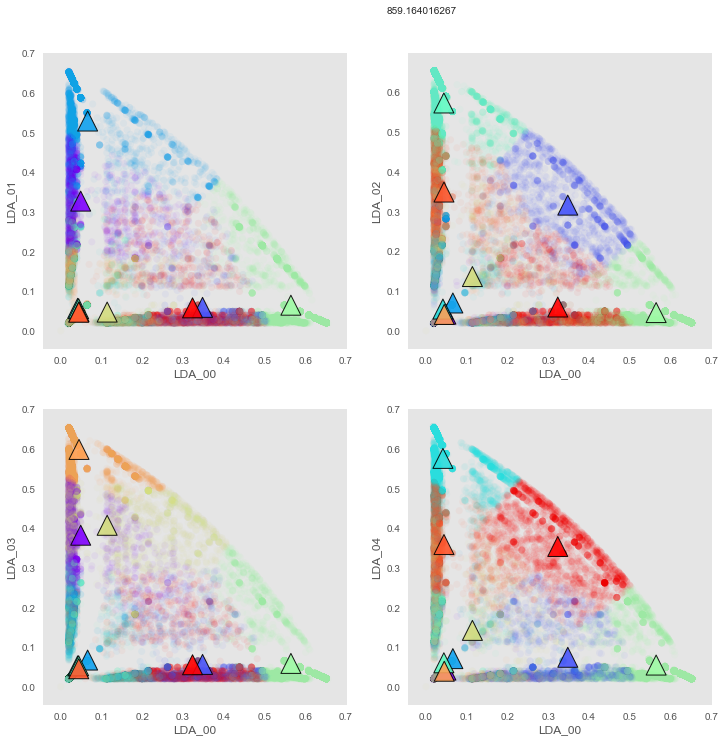

n_lda =  11


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  794.23042098
silhouette =  0.493377090487


(<matplotlib.text.Text at 0x7f8e3545c5f8>,
 <matplotlib.text.Text at 0x7f8e3592a470>)

(<matplotlib.text.Text at 0x7f8e359d4a58>,
 <matplotlib.text.Text at 0x7f8e359cecc0>)

(<matplotlib.text.Text at 0x7f8e35a1c828>,
 <matplotlib.text.Text at 0x7f8e35ae8400>)

(<matplotlib.text.Text at 0x7f8e36cf5b70>,
 <matplotlib.text.Text at 0x7f8e35b8ce48>)

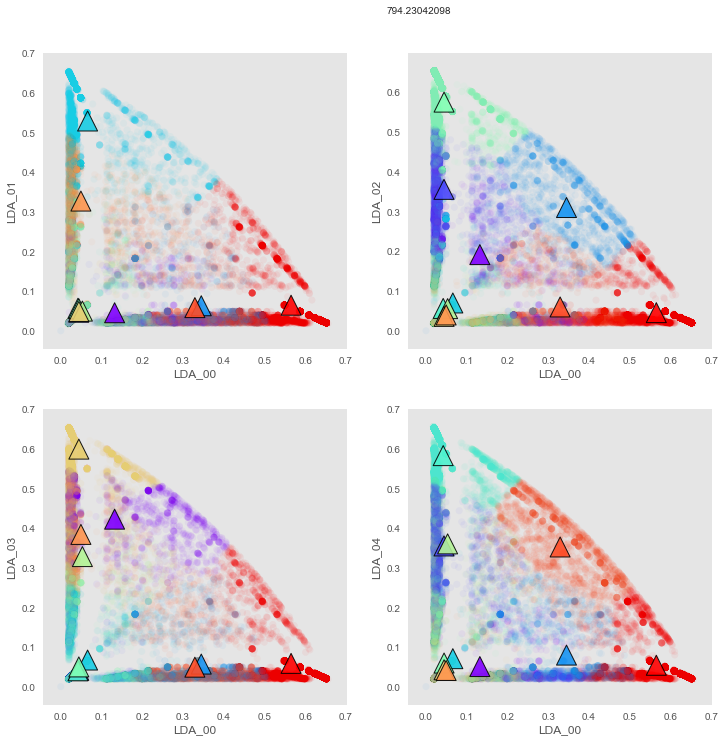

,model_name,n_clusters,inertia,silhouette,process_time
1,KMeans - LDA features,2,6016.621217,0.266625,2.7176
1,KMeans - LDA features,3,4120.020638,0.384512,2.9431
1,KMeans - LDA features,4,2523.834033,0.501645,3.0021
1,KMeans - LDA features,5,1418.819577,0.564549,3.1371
1,KMeans - LDA features,6,1257.642737,0.521217,3.9218
1,KMeans - LDA features,7,1135.466961,0.506604,4.3356
1,KMeans - LDA features,8,1023.646217,0.470088,4.4810
1,KMeans - LDA features,9,937.873676,0.474418,4.9386
1,KMeans - LDA features,10,859.164016,0.479736,4.6344
1,KMeans - LDA features,11,794.230421,0.493377,5.6503


In [7]:

for n_lda in range(2, 12):   

    tic = time.clock()
    
    print ("n_lda = ", n_lda)

    X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    
    cls_lda.fit(X1)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_

    kmeans_inertia = cls_lda.inertia_
    print ("inertia = ", kmeans_inertia)
    
    kmeans_silhouette = metrics.silhouette_score(X1,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'KMeans - LDA features',
    'n_clusters' : n_lda,
    'inertia': kmeans_inertia,
    'silhouette': kmeans_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    comparison_tbl = comparison_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize=(12, 12));
    plt.subplot(221);
    X1 = X1.values;
    plt.scatter(X1[:, 0], X1[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.text(0.8, 0.8,
             kmeans_inertia)
    
    plt.xlabel('LDA_00'), plt.ylabel('LDA_01');
    plt.grid();

    plt.subplot(222);
    plt.scatter(X1[:, 0], X1[:, 2],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 2],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('LDA_00'), plt.ylabel('LDA_02');
    plt.grid();

    plt.subplot(223);
    plt.scatter(X1[:, 0], X1[:, 3],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 3],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('LDA_00'), plt.ylabel('LDA_03');
    plt.grid();

    plt.subplot(224);
    plt.scatter(X1[:, 0], X1[:, 4],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 4],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('LDA_00'), plt.ylabel('LDA_04');
    plt.grid();

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - print out comparison table
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

comparison_tbl
    

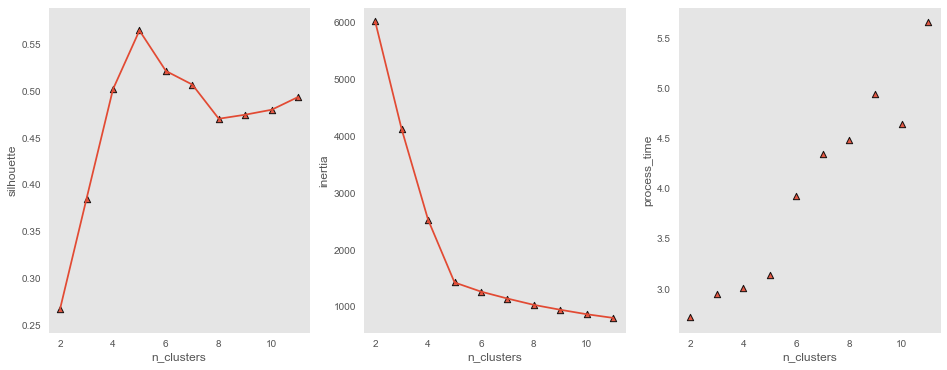

In [8]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(131);
plt.scatter(comparison_tbl['n_clusters'],
            comparison_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(comparison_tbl['n_clusters'],
         comparison_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.grid();

# ... inertia values

plt.subplot(132);
plt.scatter(comparison_tbl['n_clusters'],
            comparison_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(comparison_tbl['n_clusters'],
         comparison_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.grid();

# ... process time

plt.subplot(133);
plt.scatter(comparison_tbl['n_clusters'],
            comparison_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(comparison_tbl['n_clusters'],
#         comparison_tbl['process_time'])

plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.grid();


plt.show();


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  5 1418.81957692
silhouette =  0.567669007332


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


kmeans_labels            0         1         2         3         4
ln_LDA_00 mean    0.514983  0.059556  0.068896  0.065855  0.059937
          median  0.531157  0.028840  0.028220  0.032791  0.032790
          std     0.100783  0.069824  0.084086  0.078472  0.071643
ln_LDA_01 mean    0.061619  0.075059  0.054507  0.494508  0.053473
          median  0.032832  0.032808  0.028173  0.495017  0.028236
          std     0.068309  0.086205  0.067439  0.107092  0.065778
ln_LDA_02 mean    0.075931  0.062138  0.089335  0.067757  0.531125
          median  0.039221  0.028257  0.032791  0.032790  0.550041
          std     0.084826  0.076345  0.097787  0.081612  0.094318
ln_LDA_03 mean    0.062824  0.540089  0.059080  0.115776  0.055090
          median  0.032914  0.555596  0.028172  0.040008  0.029813
          std     0.074425  0.090233  0.075166  0.115127  0.067240
ln_LDA_04 mean    0.091096  0.058594  0.527892  0.068599  0.099219
          median  0.039222  0.028369  0.540225  0.032790  0.039223
          std     0.097795  0.072578  0.096568  0.082624  0.103681

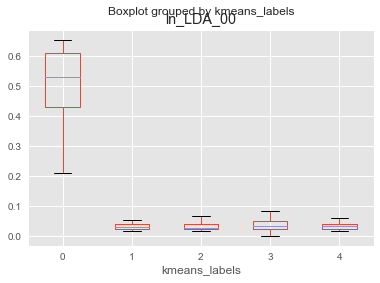

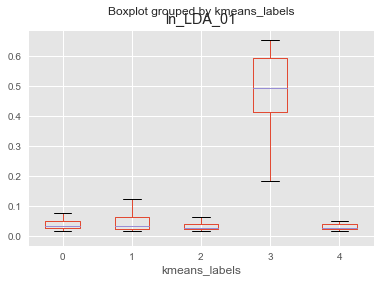

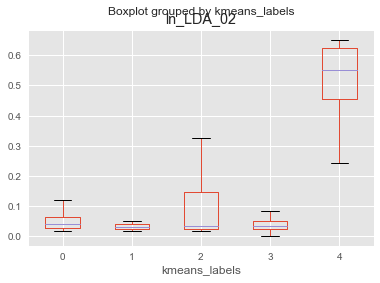

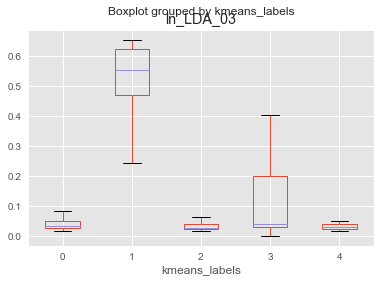

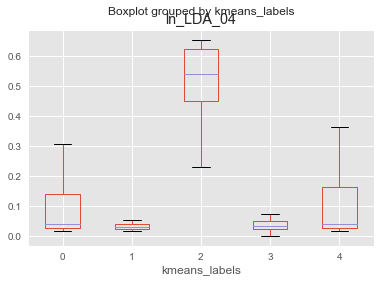

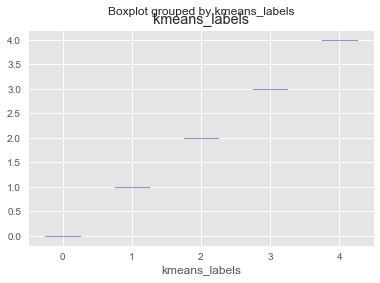

In [49]:


# ... recreate cluster model with max silhouette value

X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]

n_lda = 5

tic = time.clock()

cls_lda = KMeans(n_clusters = n_lda,
                 init = 'k-means++',
                 random_state = 1);
cls_lda.fit(X1);

kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
kmeans_centers = cls_lda.cluster_centers_
kmeans_inertia = cls_lda.inertia_

print ("n_lda, inertia ", n_lda, kmeans_inertia)

kmeans_silhouette = metrics.silhouette_score(X1,
                                             kmeans_labels,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", kmeans_silhouette)

toc =  time.clock()

X1['kmeans_labels'] = kmeans_labels

grouped = X1.groupby('kmeans_labels')

grouped.agg([np.mean, np.median, np.std]).T

# boxplot across clusters for each feature ...

col_names = X1.columns.values.tolist()

for col in col_names :
    fig = plt.figure()
    X1.boxplot(column = col, by = 'kmeans_labels')
#    ax.set_xticklabels(X1['kmeans_labels'], rotation=90)
    plt.show();

### K-Means - images & videos  


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  2
inertia =  49187.3739481
silhouette =  0.460287122859


(<matplotlib.text.Text at 0x7f8e341399b0>,
 <matplotlib.text.Text at 0x7f8e341af550>)

(<matplotlib.text.Text at 0x7f8e3403e4e0>,
 <matplotlib.text.Text at 0x7f8e34037b70>)

(<matplotlib.text.Text at 0x7f8e3417e710>,
 <matplotlib.text.Text at 0x7f8e3416a278>)

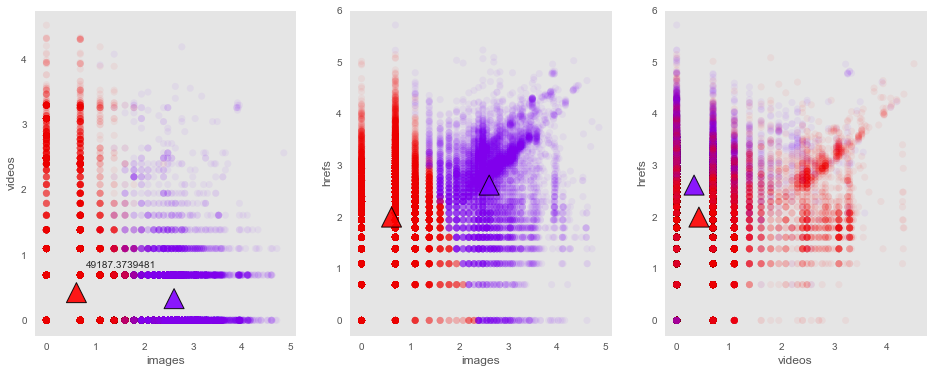

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  3
inertia =  37625.0279826
silhouette =  0.471461115021


(<matplotlib.text.Text at 0x7f8e34238208>,
 <matplotlib.text.Text at 0x7f8e2c57d4e0>)

(<matplotlib.text.Text at 0x7f8e35b955c0>,
 <matplotlib.text.Text at 0x7f8e2c63f3c8>)

(<matplotlib.text.Text at 0x7f8e35b245f8>,
 <matplotlib.text.Text at 0x7f8e2c710940>)

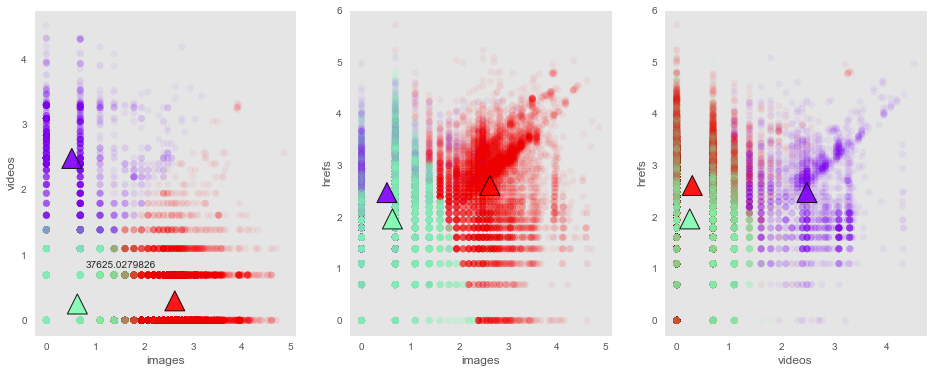

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  4
inertia =  28917.9668688
silhouette =  0.346091511814


(<matplotlib.text.Text at 0x7f8e35a69a20>,
 <matplotlib.text.Text at 0x7f8e359a1630>)

(<matplotlib.text.Text at 0x7f8e35a484a8>,
 <matplotlib.text.Text at 0x7f8e359a11d0>)

(<matplotlib.text.Text at 0x7f8e35e83748>,
 <matplotlib.text.Text at 0x7f8e35bc25c0>)

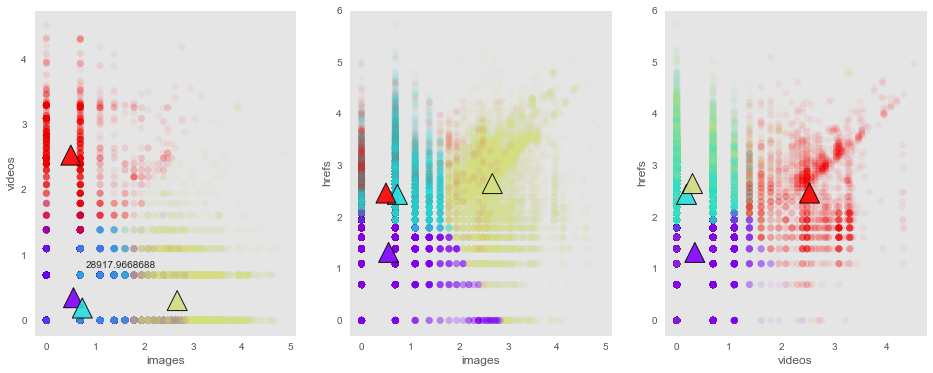

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  5
inertia =  24309.3293114
silhouette =  0.343589314837


(<matplotlib.text.Text at 0x7f8e2c62aa58>,
 <matplotlib.text.Text at 0x7f8e35ae3320>)

(<matplotlib.text.Text at 0x7f8e359ca2e8>,
 <matplotlib.text.Text at 0x7f8e35a71b70>)

(<matplotlib.text.Text at 0x7f8e2c58d390>,
 <matplotlib.text.Text at 0x7f8e35a909b0>)

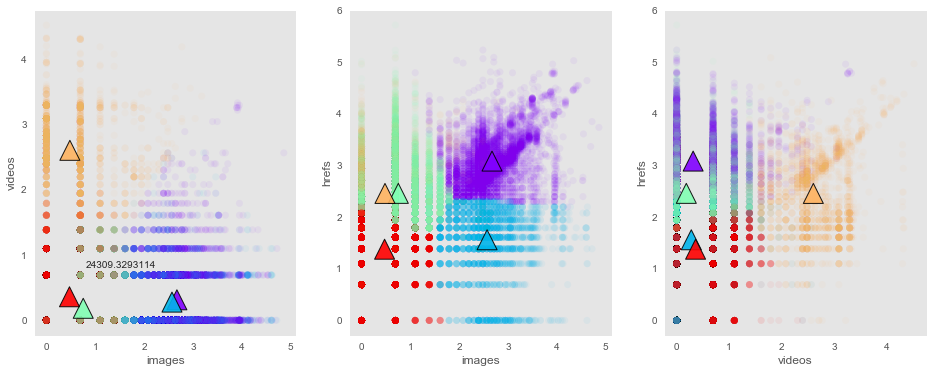

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  6
inertia =  21231.9882546
silhouette =  0.324759057672


(<matplotlib.text.Text at 0x7f8e35b83438>,
 <matplotlib.text.Text at 0x7f8e35bbeb00>)

(<matplotlib.text.Text at 0x7f8e35addd68>,
 <matplotlib.text.Text at 0x7f8e2c660898>)

(<matplotlib.text.Text at 0x7f8e35b4a1d0>,
 <matplotlib.text.Text at 0x7f8e35bbe550>)

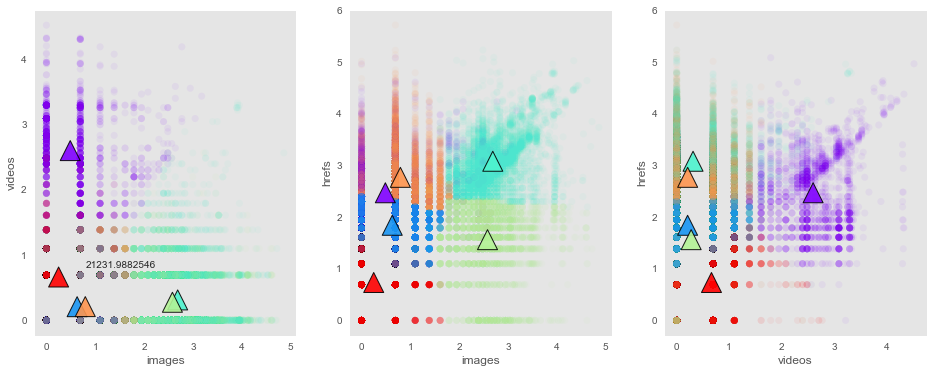

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  7
inertia =  18723.7392632
silhouette =  0.350159356293


(<matplotlib.text.Text at 0x7f8e2c63d748>,
 <matplotlib.text.Text at 0x7f8e35b4ecf8>)

(<matplotlib.text.Text at 0x7f8e340a6710>,
 <matplotlib.text.Text at 0x7f8e2c63e358>)

(<matplotlib.text.Text at 0x7f8e3596a5c0>,
 <matplotlib.text.Text at 0x7f8e35bba390>)

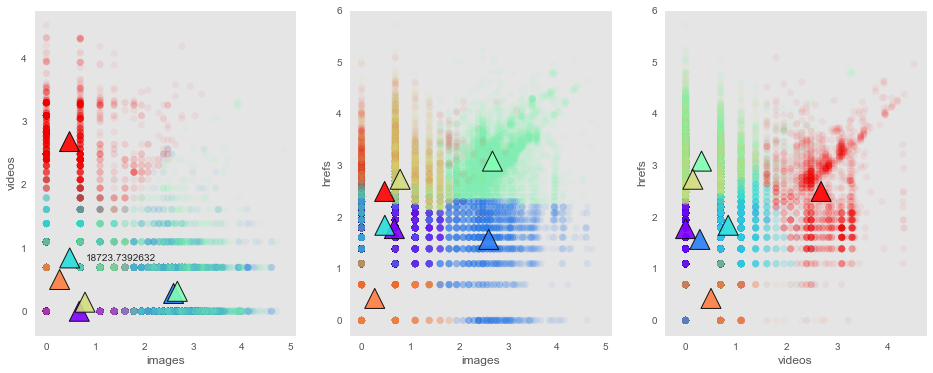

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  8
inertia =  17210.2410622
silhouette =  0.331527856696


(<matplotlib.text.Text at 0x7f8e35b37e48>,
 <matplotlib.text.Text at 0x7f8e34169d30>)

(<matplotlib.text.Text at 0x7f8e2c51f2b0>,
 <matplotlib.text.Text at 0x7f8e2c57def0>)

(<matplotlib.text.Text at 0x7f8e3596add8>,
 <matplotlib.text.Text at 0x7f8e35a12a58>)

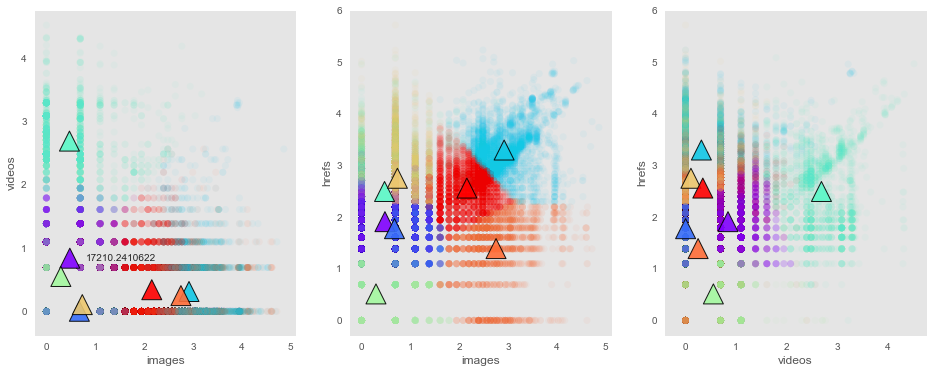

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  9
inertia =  15960.0254427
silhouette =  0.318011435102


(<matplotlib.text.Text at 0x7f8e3596a0f0>,
 <matplotlib.text.Text at 0x7f8e35c08278>)

(<matplotlib.text.Text at 0x7f8e35a69908>,
 <matplotlib.text.Text at 0x7f8e35a24d68>)

(<matplotlib.text.Text at 0x7f8e34127be0>,
 <matplotlib.text.Text at 0x7f8e35bd46d8>)

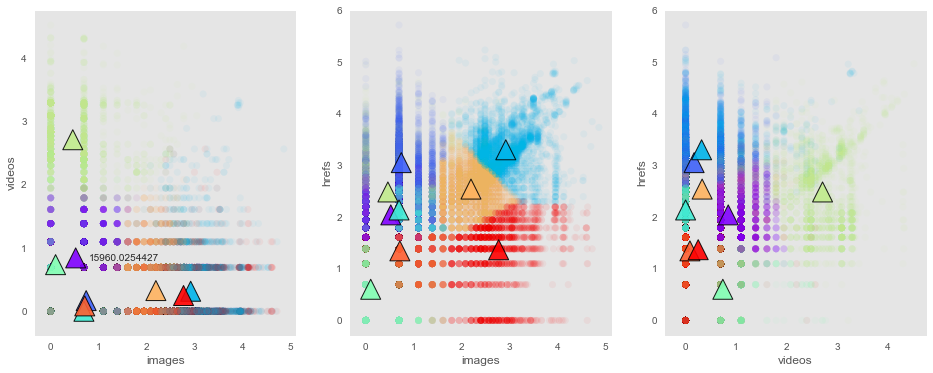

,model_name,n_clusters,inertia,silhouette,process_time
1,KMeans - LDA features,2,6016.621217,0.266625,2.7176
1,KMeans - LDA features,3,4120.020638,0.384512,2.9431
1,KMeans - LDA features,4,2523.834033,0.501645,3.0021
1,KMeans - LDA features,5,1418.819577,0.564549,3.1371
1,KMeans - LDA features,6,1257.642737,0.521217,3.9218
1,KMeans - LDA features,7,1135.466961,0.506604,4.3356
1,KMeans - LDA features,8,1023.646217,0.470088,4.4810
1,KMeans - LDA features,9,937.873676,0.474418,4.9386
1,KMeans - LDA features,10,859.164016,0.479736,4.6344
1,KMeans - LDA features,11,794.230421,0.493377,5.6503


In [9]:

for n_lda in range(2, 10):  
    
    tic = time.clock()

    X1 = df_cluster[['ln_num_imgs','ln_num_videos', 'ln_num_hrefs']] 

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1)
    
    cls_lda.fit(X1)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_
    kmeans_inertia = cls_lda.inertia_
    
    print ("n_lda = ", n_lda)
    print ("inertia = ", kmeans_inertia)

    kmeans_silhouette = metrics.silhouette_score(X1,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'KMeans - images_videos_hrefs features',
    'n_clusters' : n_lda,
    'inertia': kmeans_inertia,
    'silhouette': kmeans_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    comparison_tbl = comparison_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize = (16, 6));
    
    plt.subplot(131);
    X1 = X1.values;
    plt.scatter(X1[:, 0], X1[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.text(0.8, 0.8,
             kmeans_inertia)
    plt.xlabel('images'), plt.ylabel('videos');
    plt.grid();

    plt.subplot(132);
    plt.scatter(X1[:, 0], X1[:, 2],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 2],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('images'), plt.ylabel('hrefs');
    plt.grid();

    plt.subplot(133);
    plt.scatter(X1[:, 1], X1[:, 2],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 1], kmeans_centers[:, 2],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('videos'), plt.ylabel('hrefs');
    plt.grid();

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - print out comparison table
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

comparison_tbl



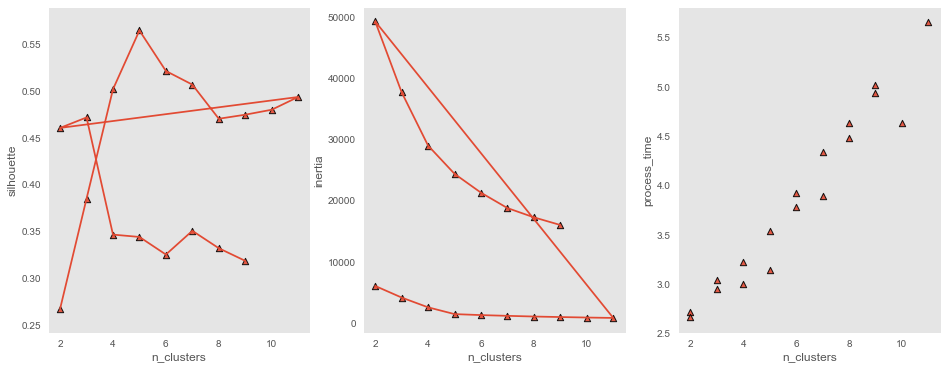

In [10]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(131);
plt.scatter(comparison_tbl['n_clusters'],
            comparison_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(comparison_tbl['n_clusters'],
         comparison_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.grid();

# ... inertia values

plt.subplot(132);
plt.scatter(comparison_tbl['n_clusters'],
            comparison_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(comparison_tbl['n_clusters'],
         comparison_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.grid();

# ... process time

plt.subplot(133);
plt.scatter(comparison_tbl['n_clusters'],
            comparison_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(comparison_tbl['n_clusters'],
#         comparison_tbl['process_time'])

plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.grid();


plt.show();


<a href='#toc'> Table of Contents</a>

<a name='kmeans_all_in'></a>
<font color="blue" size=3>  KMeans - all_in

### K-Means - All in  


In [11]:
# set required variables for model comparison

all_in_tbl = comparison_tbl.reset_index(drop = True)

all_in_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

In [12]:

X1 = df_cluster

for n_lda in range(2, 12):
    
    tic = time.clock()
    
    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    cls_lda.fit(X1);

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_
    kmeans_inertia = cls_lda.inertia_
    
    print ("n_lda, inertia ", n_lda, kmeans_inertia)

    kmeans_silhouette = metrics.silhouette_score(X1,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'KMeans - all_in',
    'n_clusters' : n_lda,
    'inertia': kmeans_inertia,
    'silhouette': kmeans_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    all_in_tbl = all_in_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

all_in_tbl

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  2 1400523.17552
silhouette =  0.340781525559


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  3 1144630.43362
silhouette =  0.347675692376


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  4 999391.40361
silhouette =  0.355824631818


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  5 920707.821029
silhouette =  0.262109105863


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  6 865749.225149
silhouette =  0.191145016442


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  7 826467.6524
silhouette =  0.18100865321


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  8 790950.316967
silhouette =  0.184835919155


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  9 760728.643599
silhouette =  0.190296465922


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  10 737976.545004
silhouette =  0.185645502704


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  11 707754.988617
silhouette =  0.18557980475


,model_name,n_clusters,inertia,silhouette,process_time
1,KMeans - all_in,2,1.400523e+06,0.340782,3.7438
1,KMeans - all_in,3,1.144630e+06,0.347676,3.7416
1,KMeans - all_in,4,9.993914e+05,0.355825,4.6129
1,KMeans - all_in,5,9.207078e+05,0.262109,5.8243
1,KMeans - all_in,6,8.657492e+05,0.191145,6.7605
1,KMeans - all_in,7,8.264677e+05,0.181009,8.1327
1,KMeans - all_in,8,7.909503e+05,0.184836,8.6197
1,KMeans - all_in,9,7.607286e+05,0.190296,10.4076
1,KMeans - all_in,10,7.379765e+05,0.185646,12.0887
1,KMeans - all_in,11,7.077550e+05,0.185580,13.4126


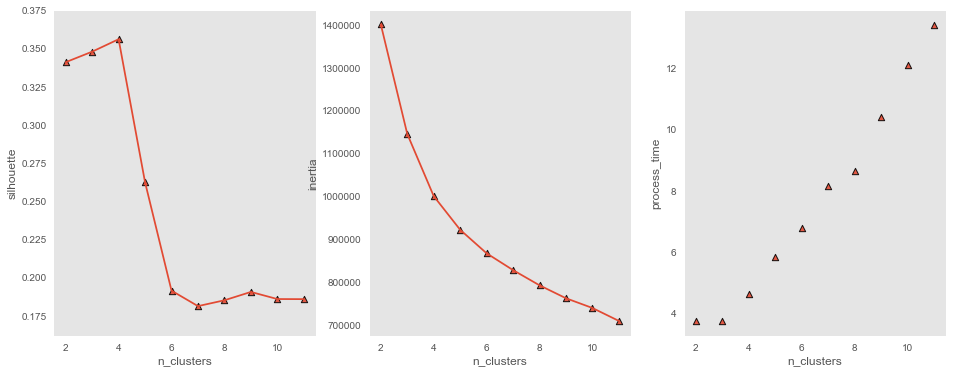

In [13]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(131);
plt.scatter(all_in_tbl['n_clusters'],
            all_in_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(all_in_tbl['n_clusters'],
         all_in_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.grid();

# ... inertia values

plt.subplot(132);
plt.scatter(all_in_tbl['n_clusters'],
            all_in_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(all_in_tbl['n_clusters'],
         all_in_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.grid();

# ... process time

plt.subplot(133);
plt.scatter(all_in_tbl['n_clusters'],
            all_in_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(all_in_tbl['n_clusters'],
#         all_in_tbl['process_time'])

plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.grid();


plt.show();


In [14]:


# ... recreate cluster model with max silhouette value

X1 = df_cluster

n_lda = 4

tic = time.clock()

cls_lda = KMeans(n_clusters = n_lda,
                 init = 'k-means++',
                 random_state = 1);
cls_lda.fit(X1);

kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
kmeans_centers = cls_lda.cluster_centers_
kmeans_inertia = cls_lda.inertia_

print ("n_lda, inertia ", n_lda, kmeans_inertia)

kmeans_silhouette = metrics.silhouette_score(X1,
                                             kmeans_labels,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", kmeans_silhouette)

toc =  time.clock()

kmeans_labels

len(kmeans_labels)

X1['kmeans_labels'] = kmeans_labels

col_names = X1.columns.values.tolist()



KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  4 999391.40361
silhouette =  0.357899895468


In [46]:
pd.options.display.max_rows = 999

grouped = X1.groupby('kmeans_labels')

grouped.agg([np.mean, np.median, np.std]).T


kmeans_labels                                   0          1          2  \
n_tokens_title                  mean    10.452100  10.467491  10.320638   
                                median  10.000000  10.000000  10.000000   
                                std      2.140902   2.098862   2.030432   
num_keywords                    mean     6.861258   7.698386   6.762251   
                                median   7.000000   8.000000   7.000000   
                                std      1.975838   1.675623   2.014037   
kw_avg_max                      mean     2.173935   1.636641   2.143115   
                                median   2.052661   1.571041   1.934420   
                                std      0.981161   0.853675   1.186846   
weekday_is_monday               mean     0.165594   0.177133   0.157939   
                                median   0.000000   0.000000   0.000000   
                                std      0.371726   0.381795   0.364735   
weekday_is_tuesday              mean     0.186643   0.188463   0.169700   
                                median   0.000000   0.000000   0.000000   
                                std      0.389635   0.391096   0.375422   
weekday_is_wednesday            mean     0.185007   0.189129   0.185102   
                                median   0.000000   0.000000   0.000000   
                                std      0.388314   0.391626   0.388435   
weekday_is_thursday             mean     0.178044   0.184612   0.192943   
                                median   0.000000   0.000000   0.000000   
                                std      0.382560   0.387997   0.394664   
weekday_is_friday               mean     0.145706   0.139514   0.145617   
                                median   0.000000   0.000000   0.000000   
                                std      0.352820   0.346495   0.352772   
is_weekend                      mean     0.139006   0.121149   0.148698   
                                median   0.000000   0.000000   0.000000   
                                std      0.345962   0.326313   0.355840   
LDA_00                          mean     0.178494   0.173953   0.217198   
                                median   0.040000   0.033334   0.040000   
                                std      0.251981   0.257372   0.298051   
LDA_01                          mean     0.141669   0.149068   0.125422   
                                median   0.034243   0.029911   0.033454   
                                std      0.215490   0.233111   0.202931   
LDA_02                          mean     0.206819   0.206952   0.258379   
                                median   0.040076   0.033393   0.040354   
                                std      0.275688   0.274303   0.315758   
LDA_03                          mean     0.243630   0.213942   0.226021   
                                median   0.040907   0.033378   0.040145   
                                std      0.304433   0.291103   0.298253   
LDA_04                          mean     0.229335   0.256085   0.172980   
                                median   0.050000   0.040006   0.040001   
                                std      0.287549   0.302232   0.242608   
global_subjectivity             mean     0.458798   0.456291   0.349147   
                                median   0.458048   0.455875   0.421263   
                                std      0.091288   0.087586   0.200749   
global_rate_positive_words      mean     0.040155   0.040252   0.035103   
                                median   0.038860   0.039144   0.037855   
                                std      0.016355   0.015573   0.024417   
rate_positive_words             mean     0.696409   0.706772   0.560034   
                                median   0.709677   0.722222   0.673469   
                                std      0.153097   0.148873   0.327241   
max_positive_polarity           mean     0.778896   0.776626   0.618352   
                         

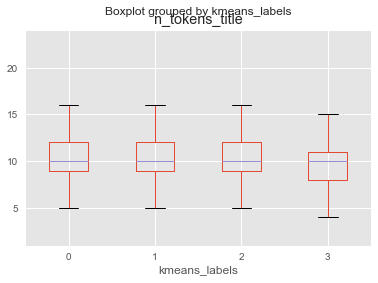

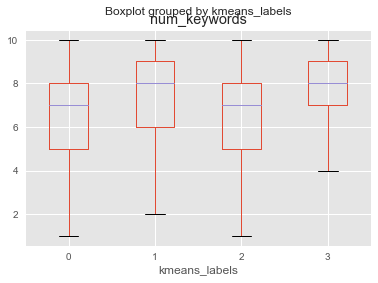

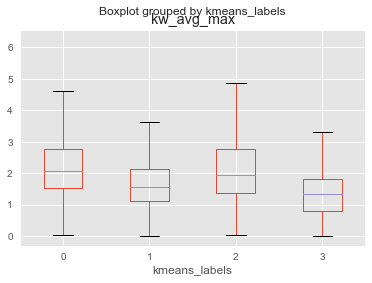

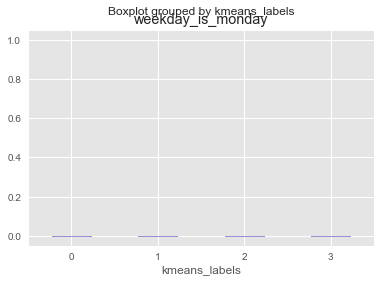

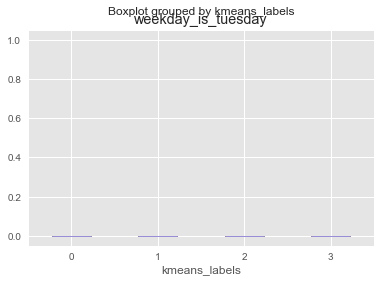

...

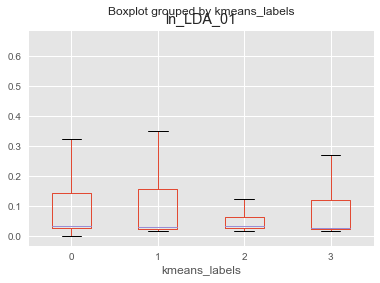

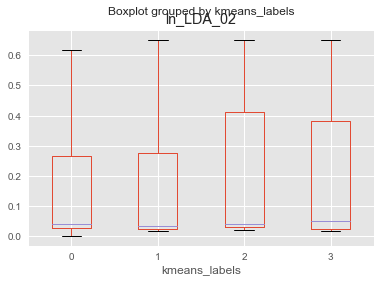

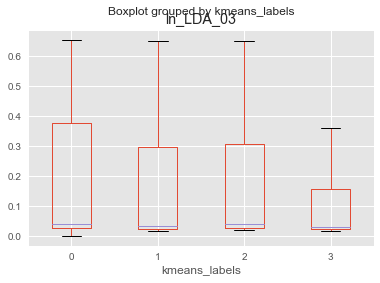

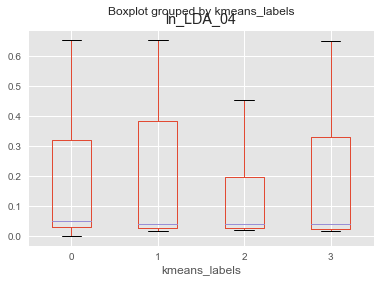

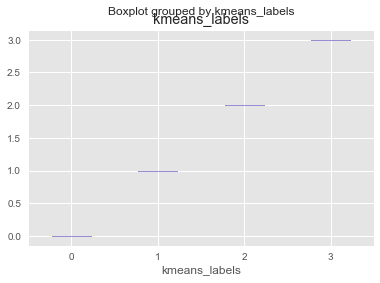

In [38]:

# boxplot across clusters for each feature ...

for col in col_names :
    fig = plt.figure()
    X1.boxplot(column = col, by = 'kmeans_labels')
#    ax.set_xticklabels(X1['kmeans_labels'], rotation=90)
    plt.show();

<a href='#toc'> Table of Contents</a>

<a name='DBScan'></a>
<font color="blue" size=3>  DBScan

### DBSCAN


http://hdbscan.readthedocs.io/en/latest/comparing_clustering_algorithms.html  

DBSCAN is a density based algorithm – it assumes clusters for dense regions. It is also the first actual clustering algorithm we’ve looked at: it doesn’t require that every point be assigned to a cluster and hence doesn’t partition the data, but instead extracts the ‘dense’ clusters and leaves sparse background classified as ‘noise’.  
In practice DBSCAN is related to agglomerative clustering.  
As a first step DBSCAN transforms the space according to the density of the data: points in dense regions are left alone, while points in sparse regions are moved further away. Applying single linkage clustering to the transformed space results in a dendrogram, which we cut according to a distance parameter (called epsilon or eps in many implementations) to get clusters. Importantly any singleton clusters at that cut level are deemed to be ‘noise’ and left unclustered. This provides several advantages: we get the manifold following behaviour of agglomerative clustering, and we get actual clustering as opposed to partitioning. Better yet, since we can frame the algorithm in terms of local region queries we can use various tricks such as kdtrees to get exceptionally good performance and scale to dataset sizes that are otherwise unapproachable with algorithms other than K-Means.  
There are some catches however. Obviously epsilon can be hard to pick; you can do some data analysis and get a good guess, but the algorithm can be quite sensitive to the choice of the parameter. The density based transformation depends on another parameter (min_samples in sklearn).  
Finally the combination of min_samples and eps amounts to a choice of density and the clustering only finds clusters at or above that density; if your data has variable density clusters then DBSCAN is either going to miss them, split them up, or lump some of them together depending on your parameter choices.  

So, in summary:  

   - __Don’t be wrong!__: Clusters don’t need to be globular, and won’t have noise lumped in; varying density clusters may cause problems, but that is more in the form of insufficient detail rather than explicitly wrong. DBSCAN is the first clustering algorithm we’ve looked at that actually meets the ‘Don’t be wrong!’ requirement.  
    - __Intuitive parameters__: Epsilon is a distance value, so you can survey the distribution of distances in your dataset to attempt to get an idea of where it should lie. In practice, however, this isn’t an especially intuitive parameter, nor is it easy to get right.  
    - __Stability__: DBSCAN is stable across runs (and to some extent subsampling if you re-parameterize well); stability over varying epsilon and min samples is not so good.  
    - __Performance__: This is DBSCAN’s other great strength; few clustering algorithms can tackle datasets as large as DBSCAN can.  

So how does it cluster our test dataset? I played with a few epsilon values until I got somethign reasonable, but there was little science to this – getting the parameters right can be hard.  

In [61]:
# set required variables for model comparison

dbscan_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'epsilon',
    'min_points',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

eps, min_pts, nclusters =  0.02 10 153
silhouette =  -0.0855960794612


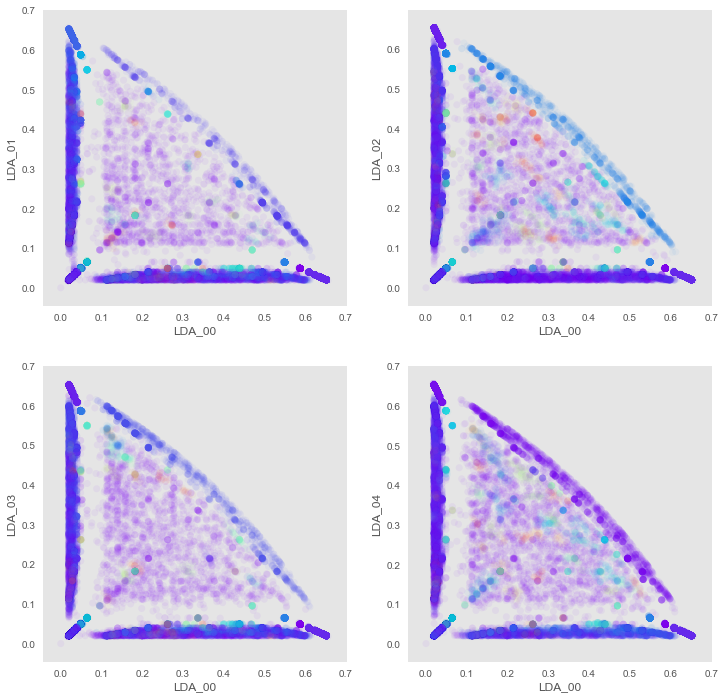

eps, min_pts, nclusters =  0.02 30 60
silhouette =  0.031905900258


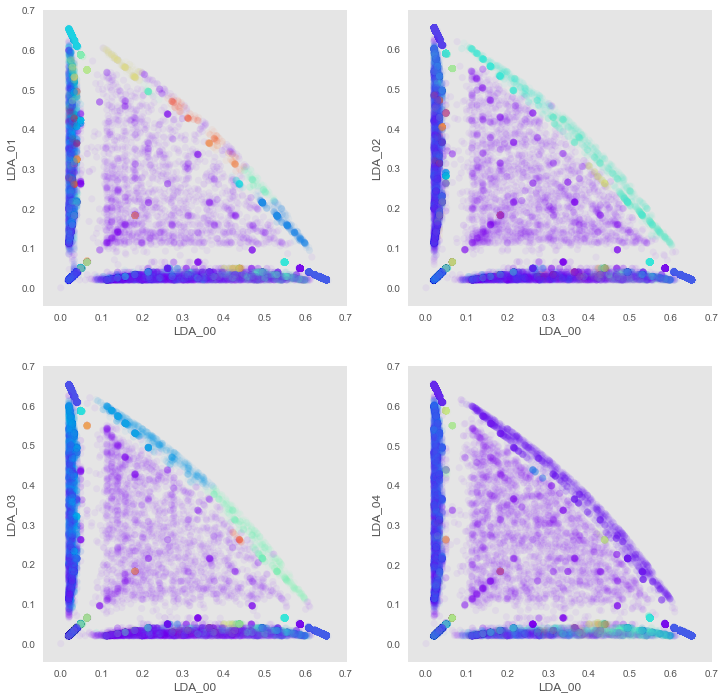

eps, min_pts, nclusters =  0.02 50 56
silhouette =  0.101426571856


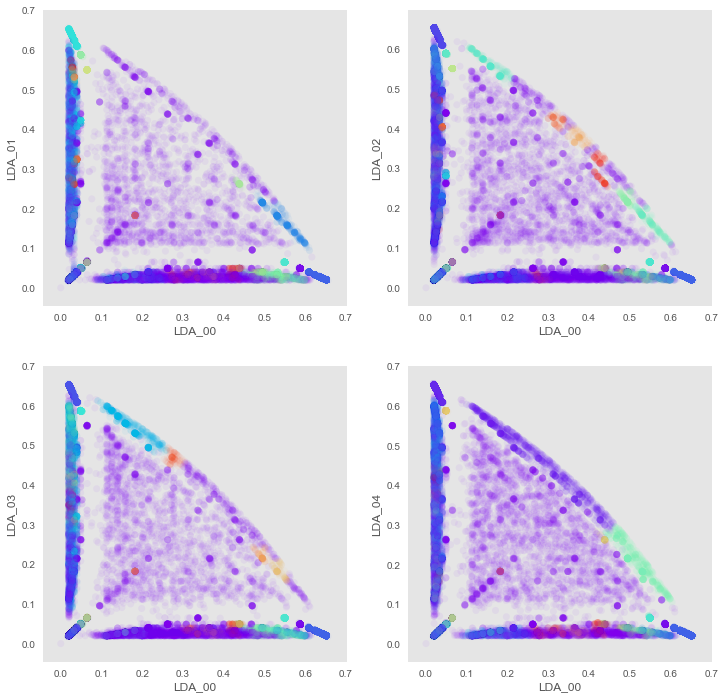

eps, min_pts, nclusters =  0.02 70 48
silhouette =  0.0771194097828


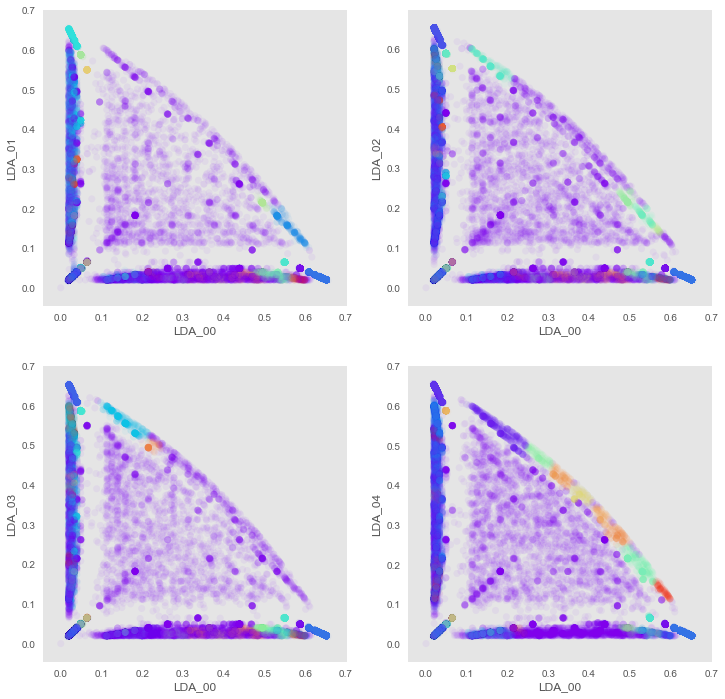

eps, min_pts, nclusters =  0.02 90 41
silhouette =  0.036829602996


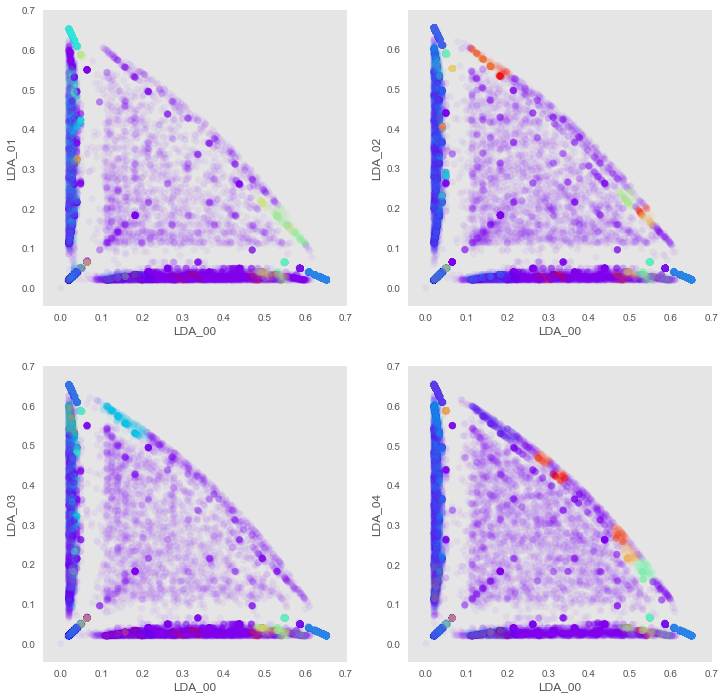

eps, min_pts, nclusters =  0.02 110 33
silhouette =  0.0431833243125


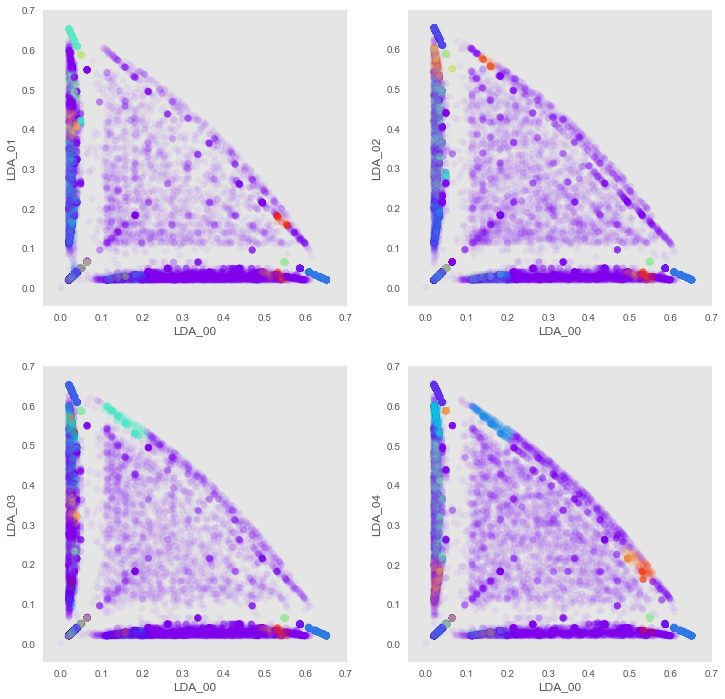

eps, min_pts, nclusters =  0.02 130 32
silhouette =  0.0250743431644


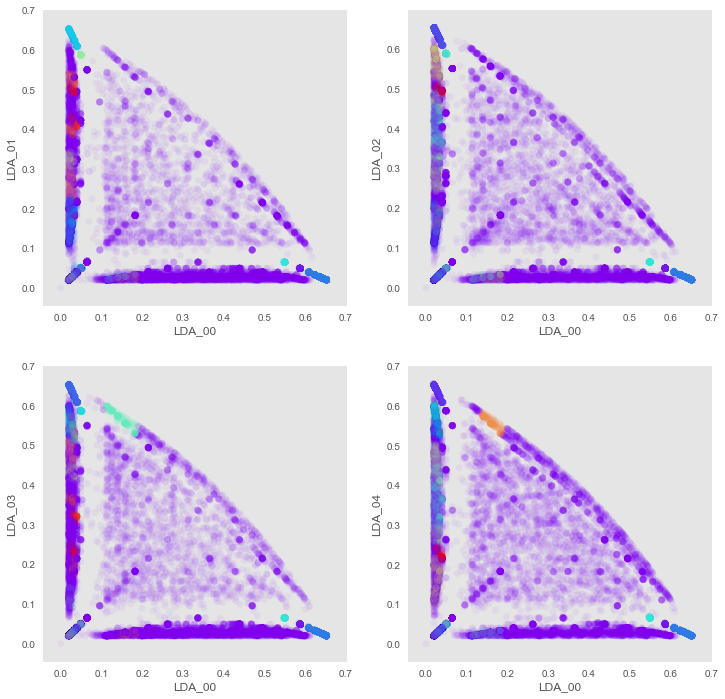

eps, min_pts, nclusters =  0.02 150 27
silhouette =  -0.012064911841


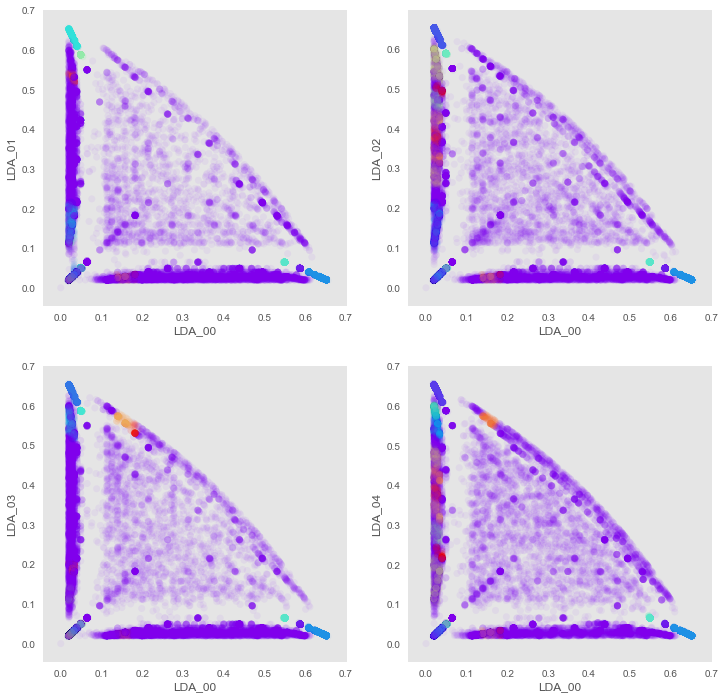

eps, min_pts, nclusters =  0.02 170 19
silhouette =  -0.0598985059903


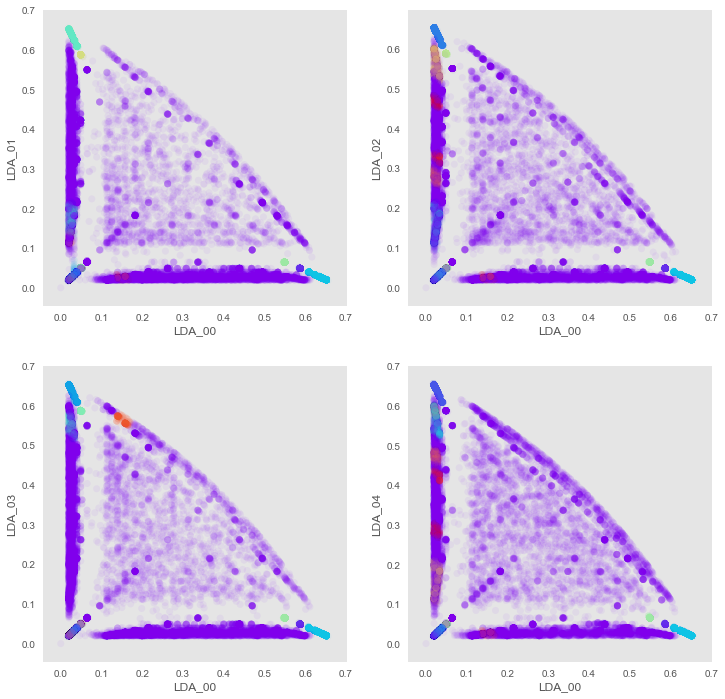

eps, min_pts, nclusters =  0.02 190 17
silhouette =  -0.0711635056725


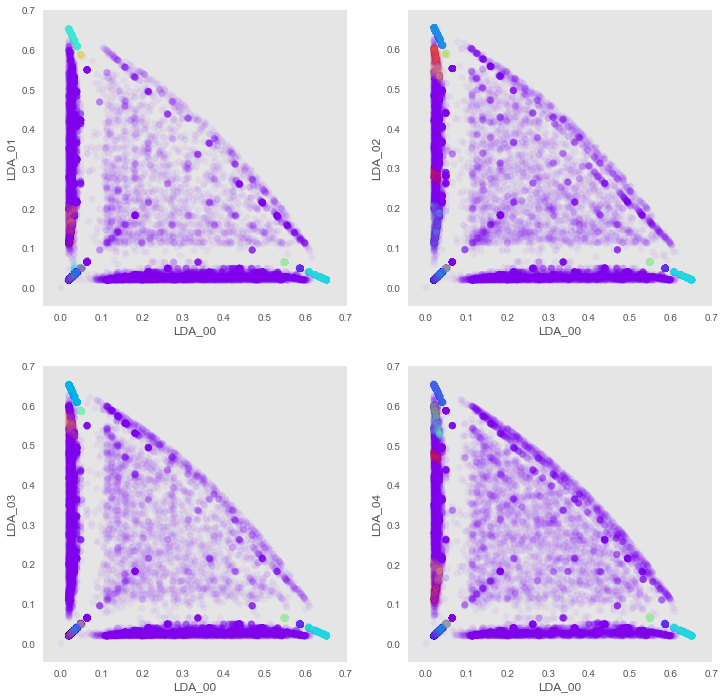

eps, min_pts, nclusters =  0.03 10 124
silhouette =  -0.210357563554


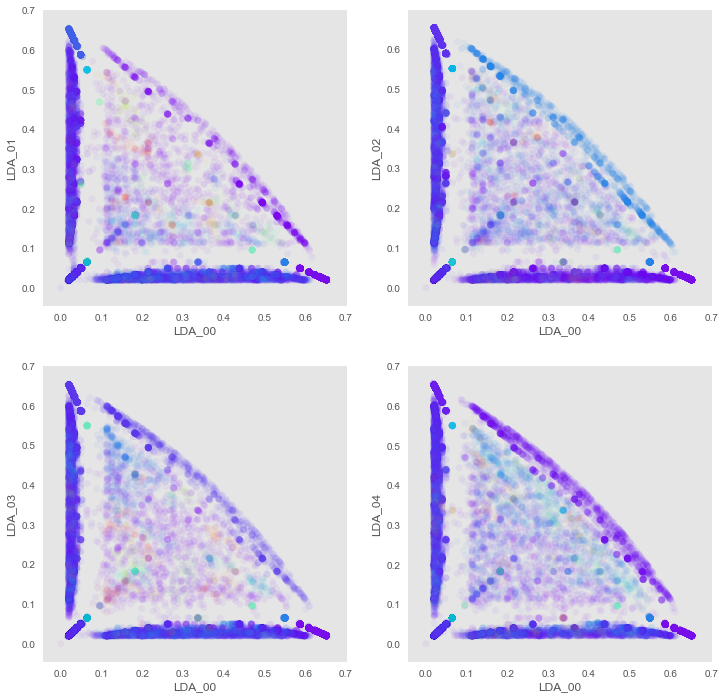

eps, min_pts, nclusters =  0.03 30 37
silhouette =  -0.0213734049662


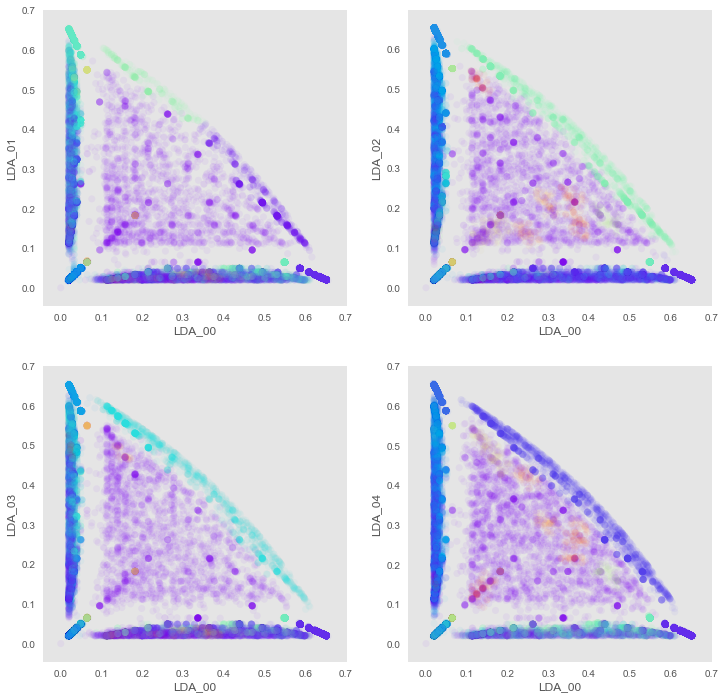

eps, min_pts, nclusters =  0.03 50 27
silhouette =  0.145458718953


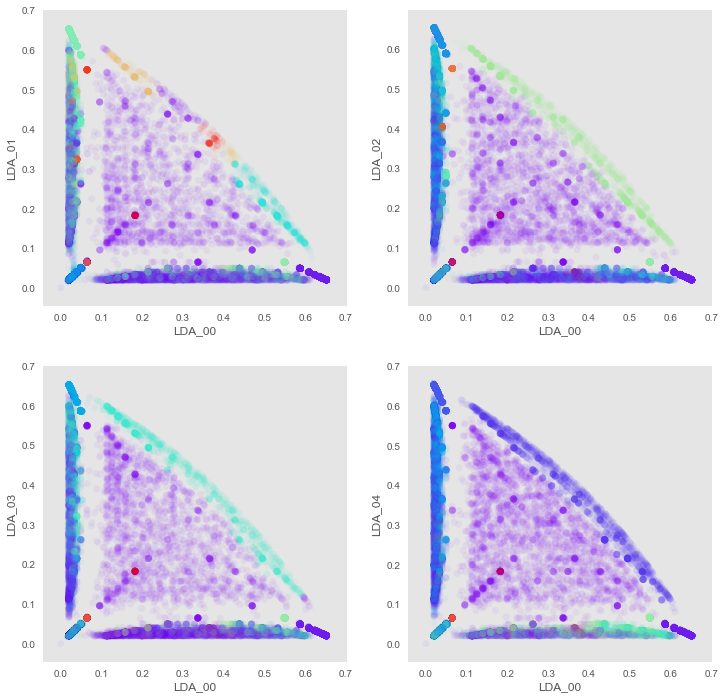

eps, min_pts, nclusters =  0.03 70 29
silhouette =  0.138460818714


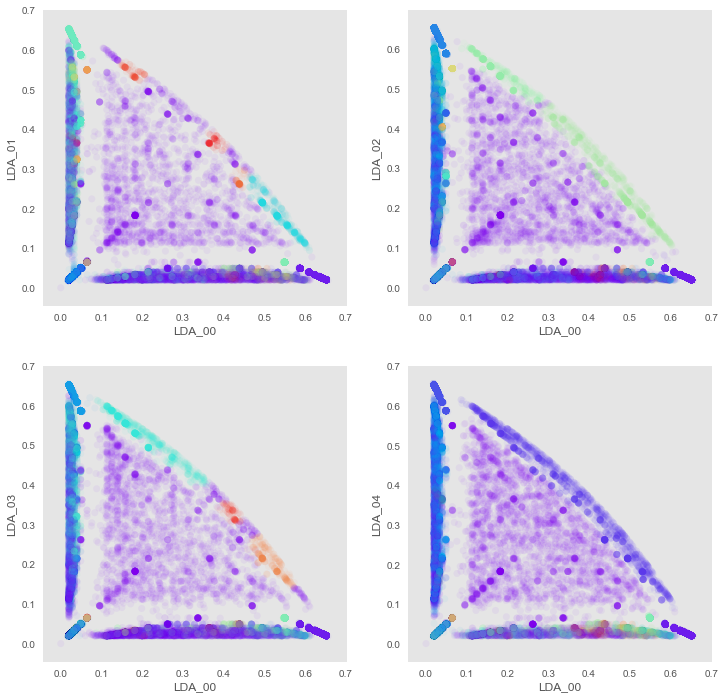

eps, min_pts, nclusters =  0.03 90 32
silhouette =  0.162128722293


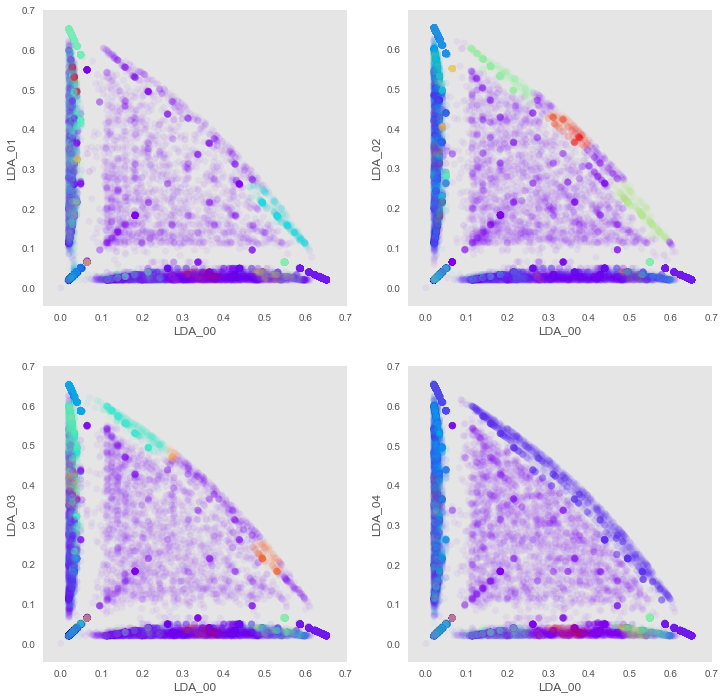

eps, min_pts, nclusters =  0.03 110 28
silhouette =  0.146650573747


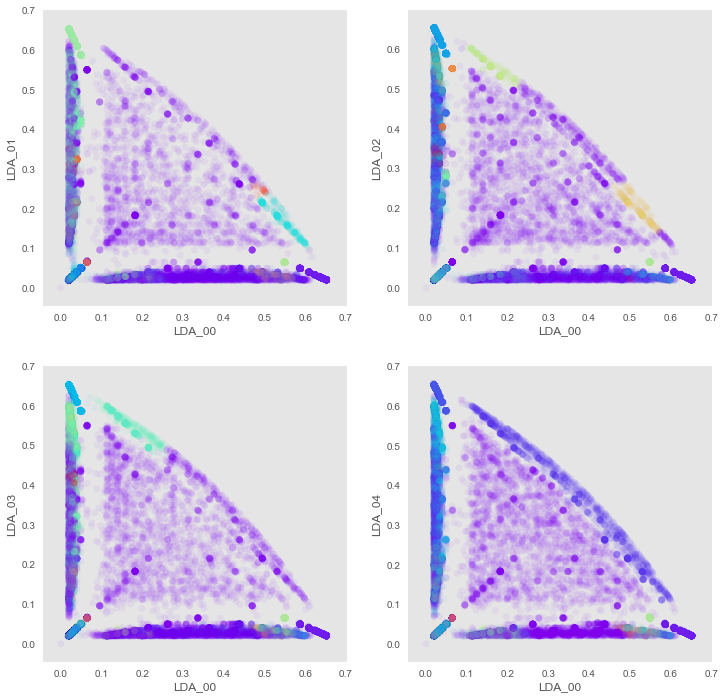

eps, min_pts, nclusters =  0.03 130 27
silhouette =  0.170528060286


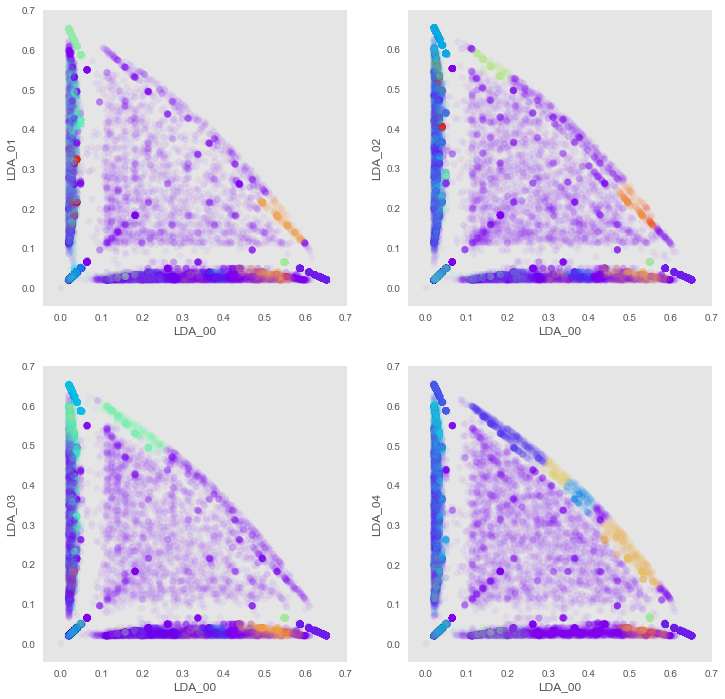

eps, min_pts, nclusters =  0.03 150 24
silhouette =  0.118947353013


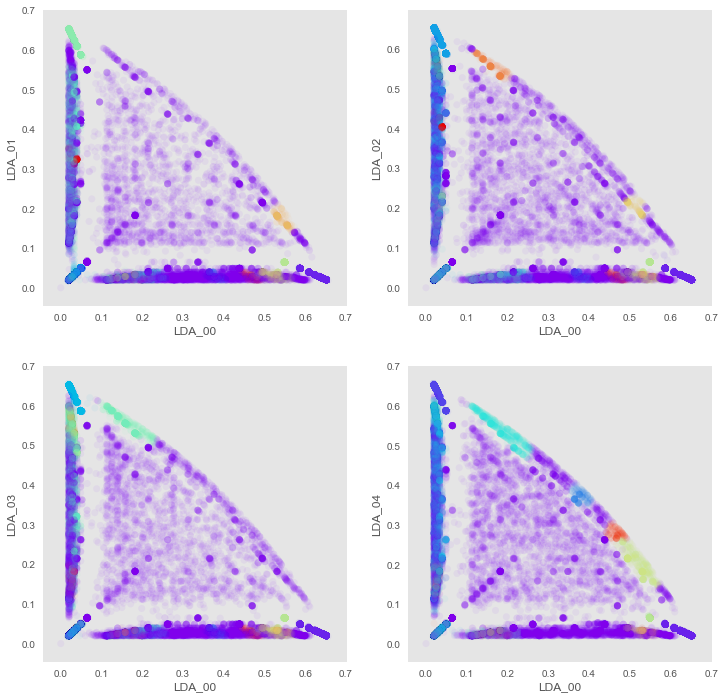

eps, min_pts, nclusters =  0.03 170 19
silhouette =  0.109054800548


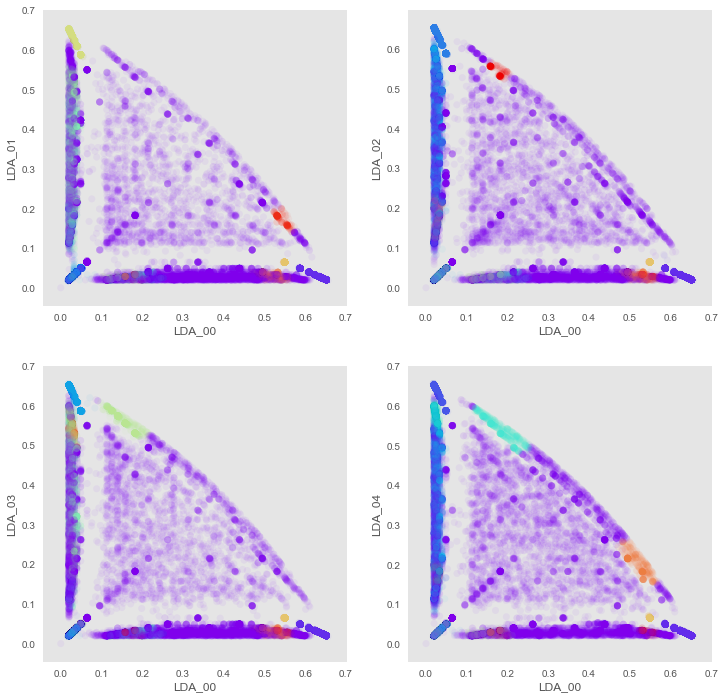

eps, min_pts, nclusters =  0.03 190 18
silhouette =  0.079039109307


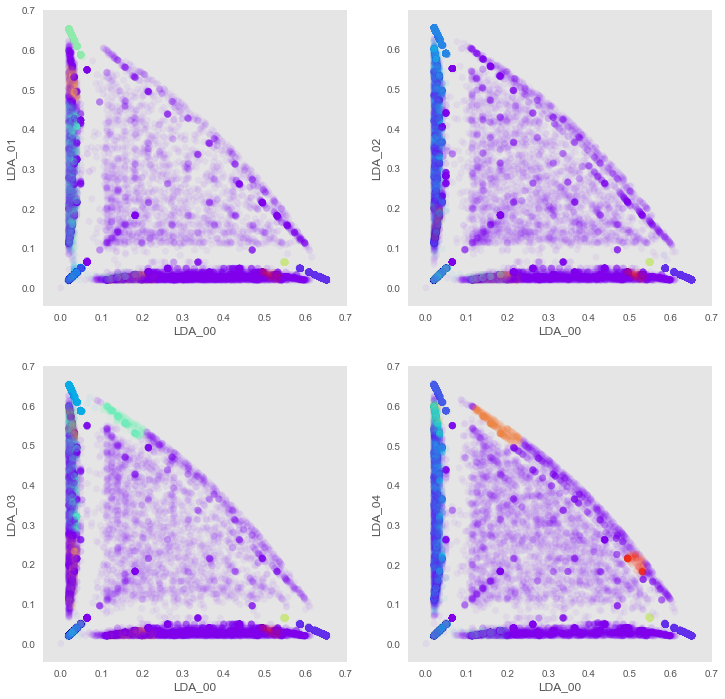

eps, min_pts, nclusters =  0.05 10 13
silhouette =  -0.554975391505


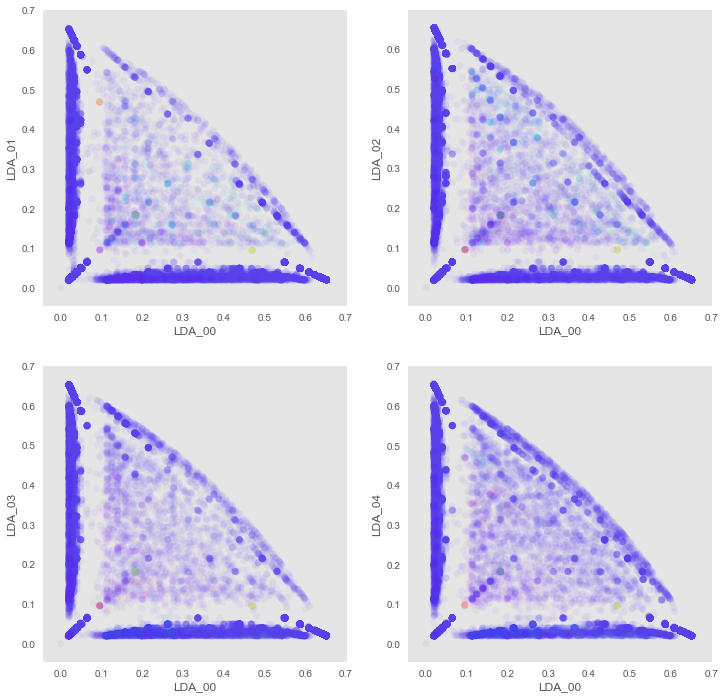

eps, min_pts, nclusters =  0.05 30 22
silhouette =  -0.583245695382


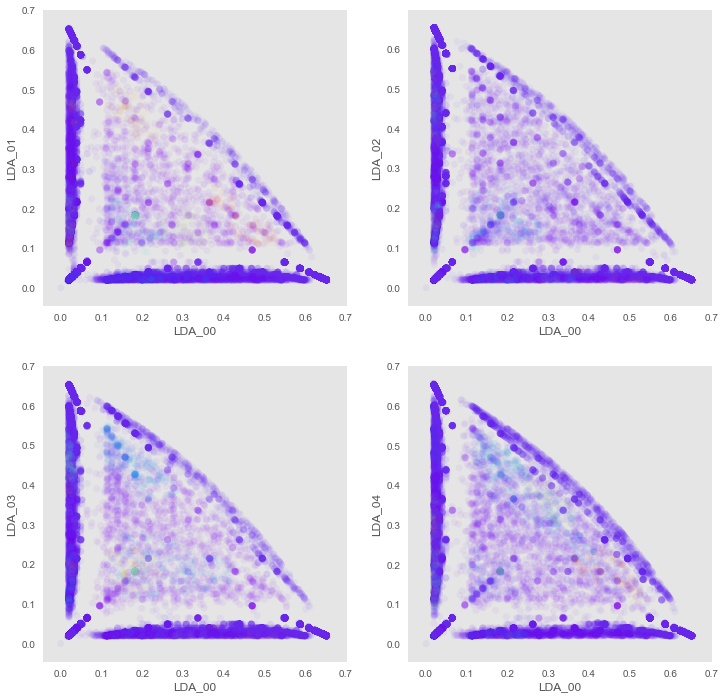

eps, min_pts, nclusters =  0.05 50 15
silhouette =  -0.508581617653


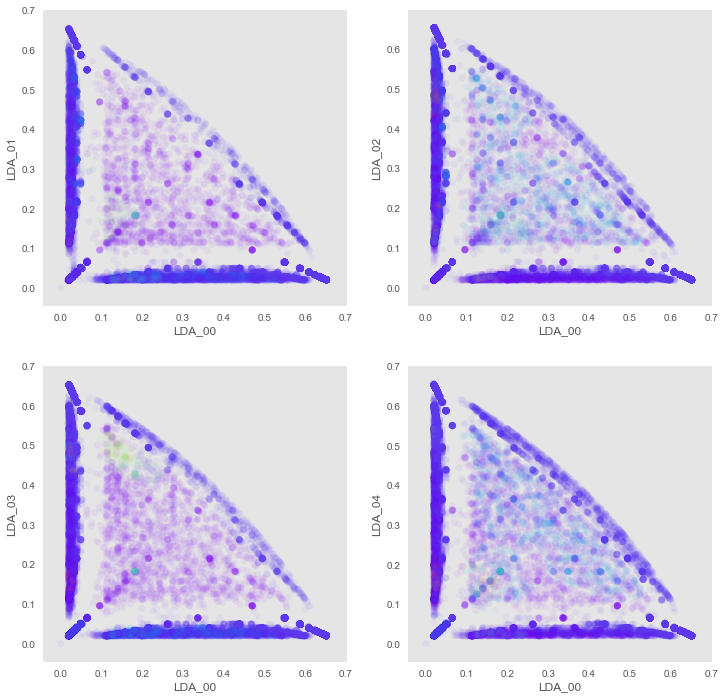

eps, min_pts, nclusters =  0.05 70 9
silhouette =  -0.384019284454


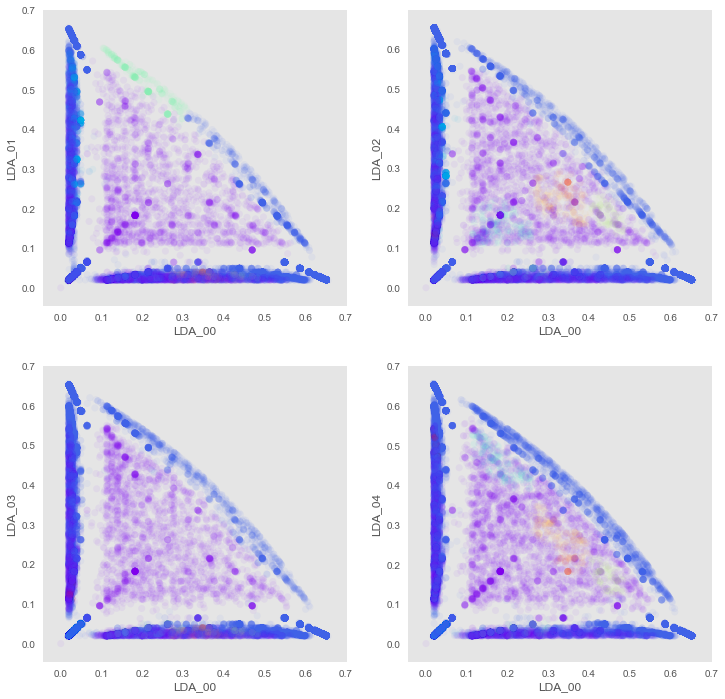

eps, min_pts, nclusters =  0.05 90 4
silhouette =  -0.143251757675


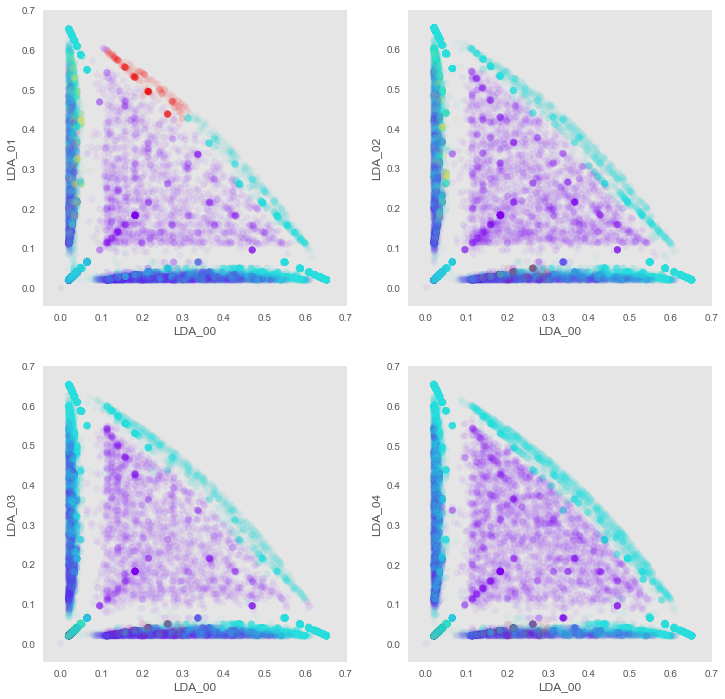

eps, min_pts, nclusters =  0.05 110 9
silhouette =  -0.266437896558


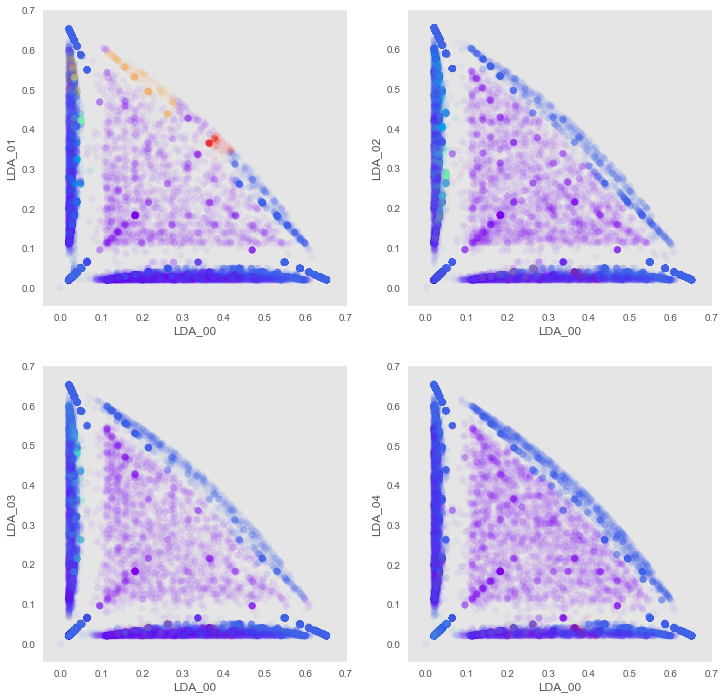

eps, min_pts, nclusters =  0.05 130 8
silhouette =  -0.291059815599


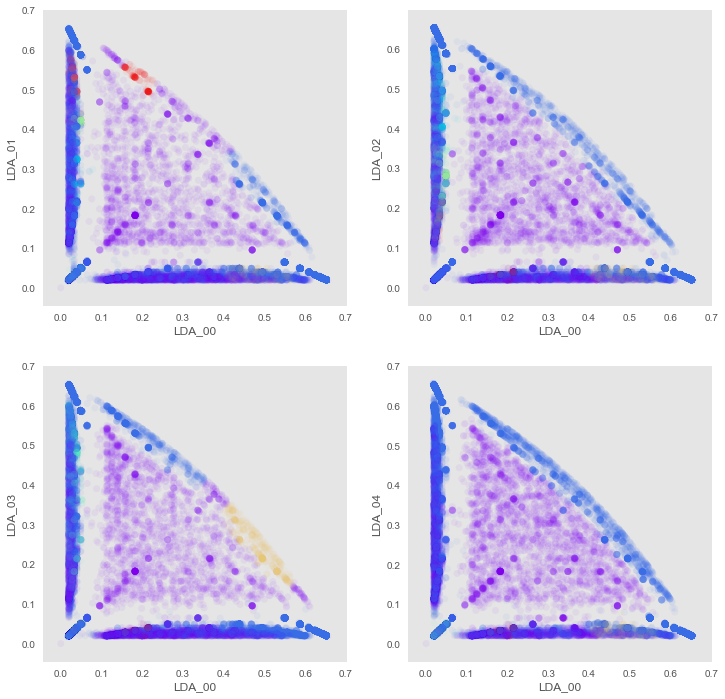

eps, min_pts, nclusters =  0.05 150 15
silhouette =  -0.0876455920594


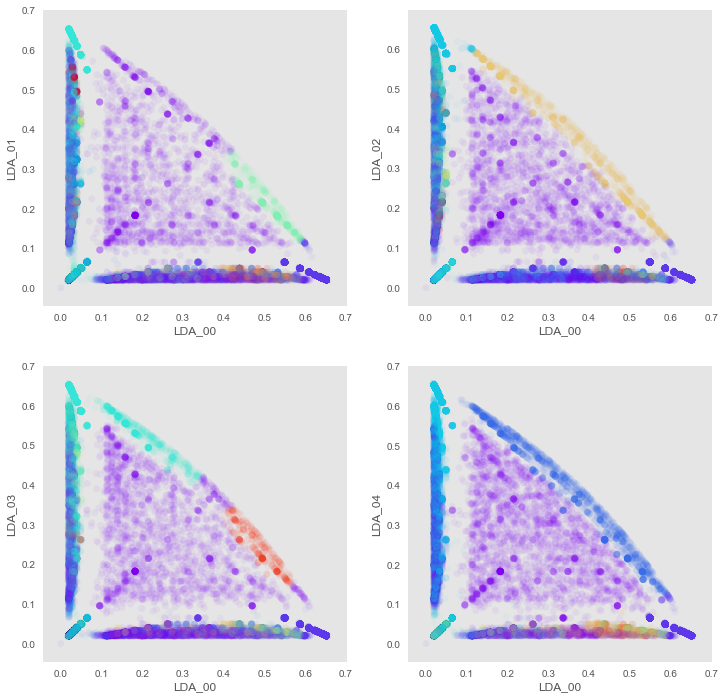

eps, min_pts, nclusters =  0.05 170 18
silhouette =  -0.00363225510685


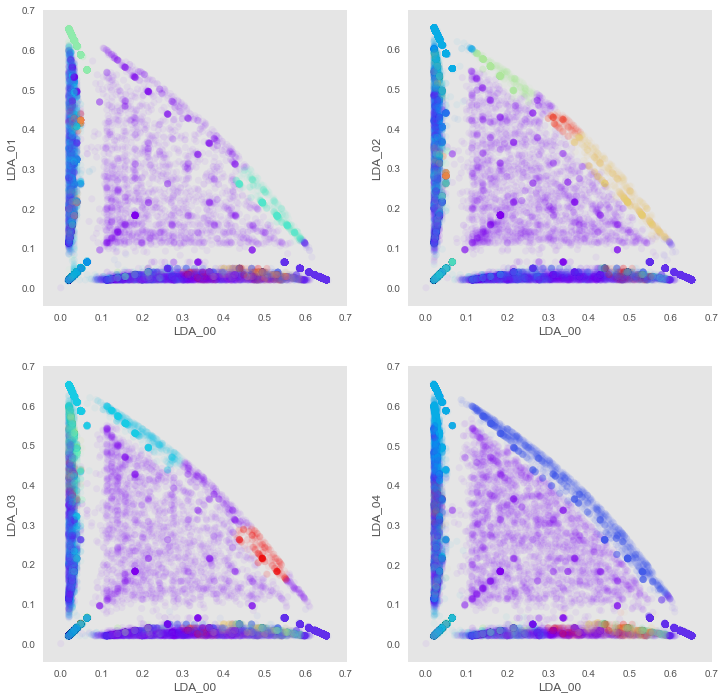

eps, min_pts, nclusters =  0.05 190 18
silhouette =  -0.0219842244597


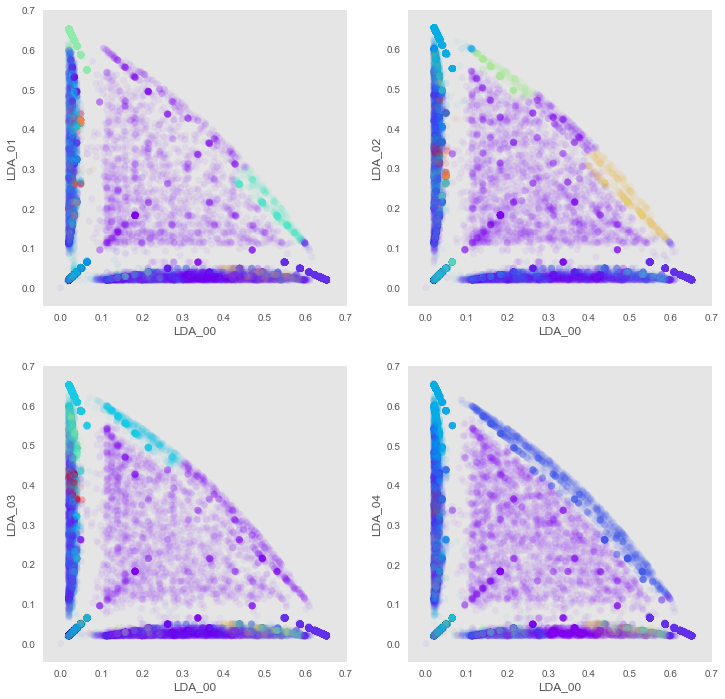

eps, min_pts, nclusters =  0.06 10 17
silhouette =  -0.625087159318


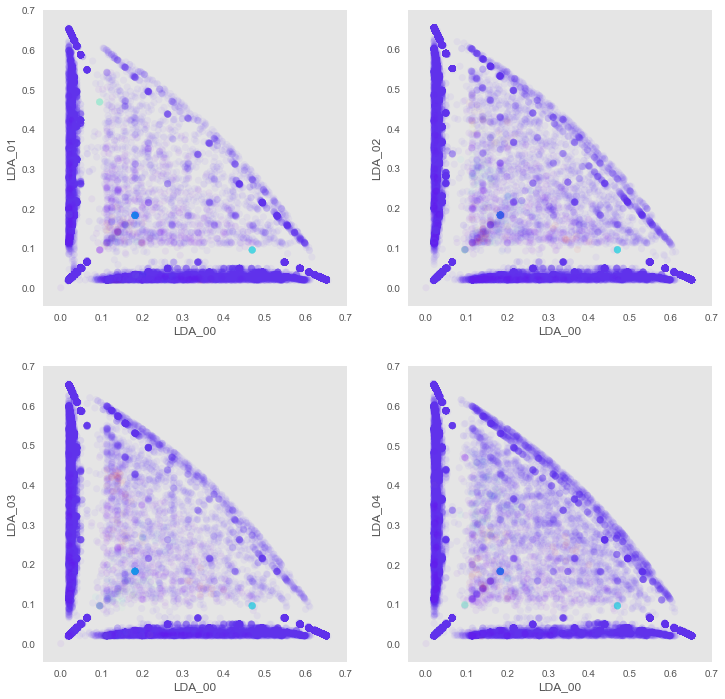

eps, min_pts, nclusters =  0.06 30 13
silhouette =  -0.509683854142


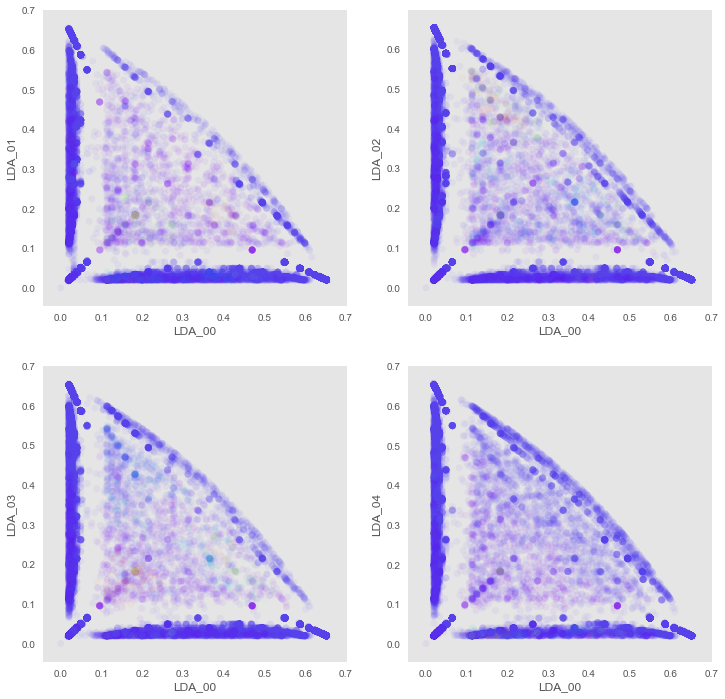

eps, min_pts, nclusters =  0.06 50 16
silhouette =  -0.547325246322


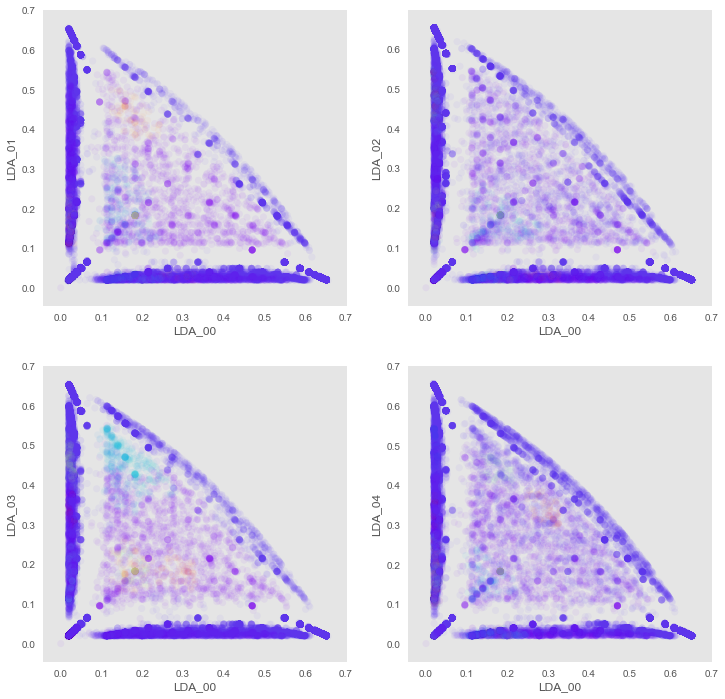

eps, min_pts, nclusters =  0.06 70 8
silhouette =  -0.458514547266


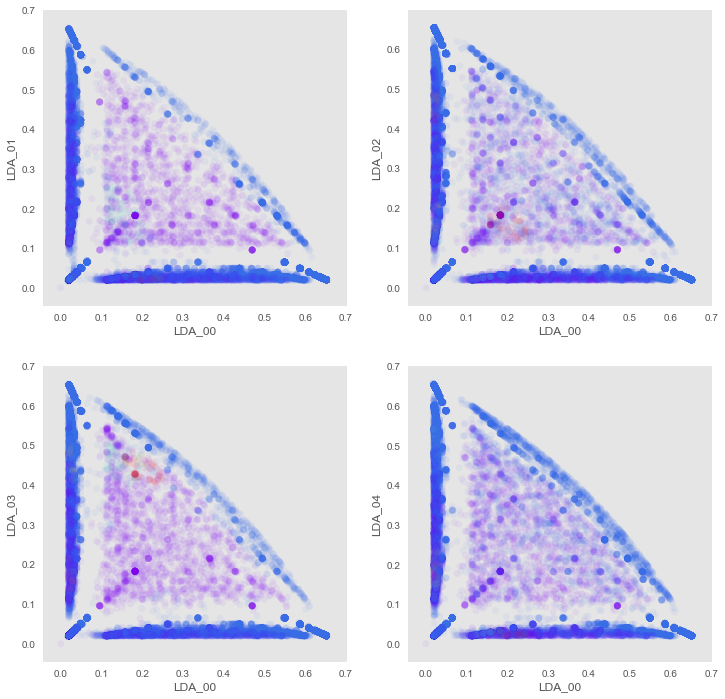

eps, min_pts, nclusters =  0.06 90 5
silhouette =  -0.294859343785


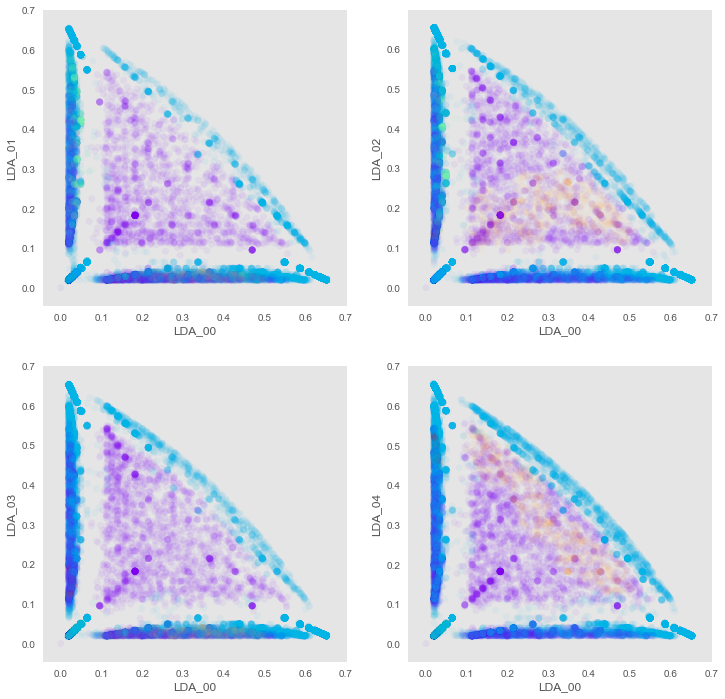

eps, min_pts, nclusters =  0.06 110 3
silhouette =  -0.115204301547


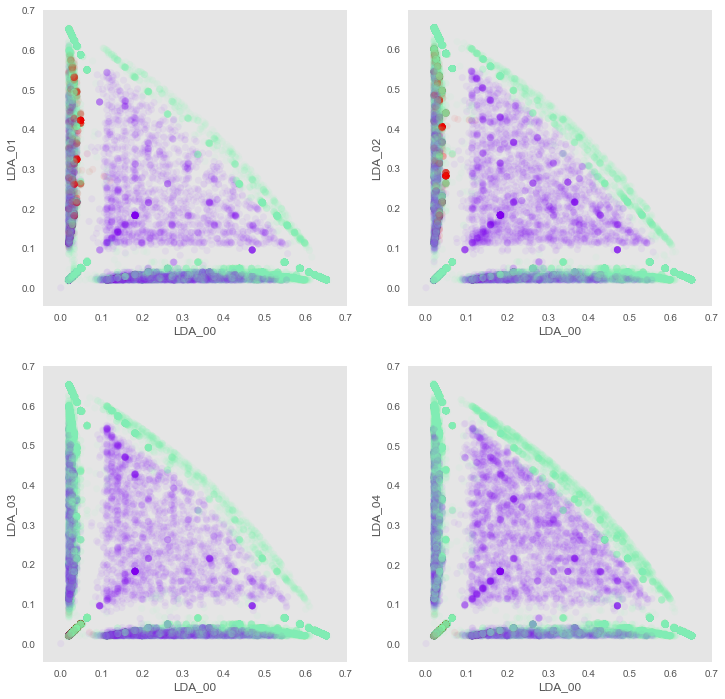

eps, min_pts, nclusters =  0.06 130 5
silhouette =  -0.162619911913


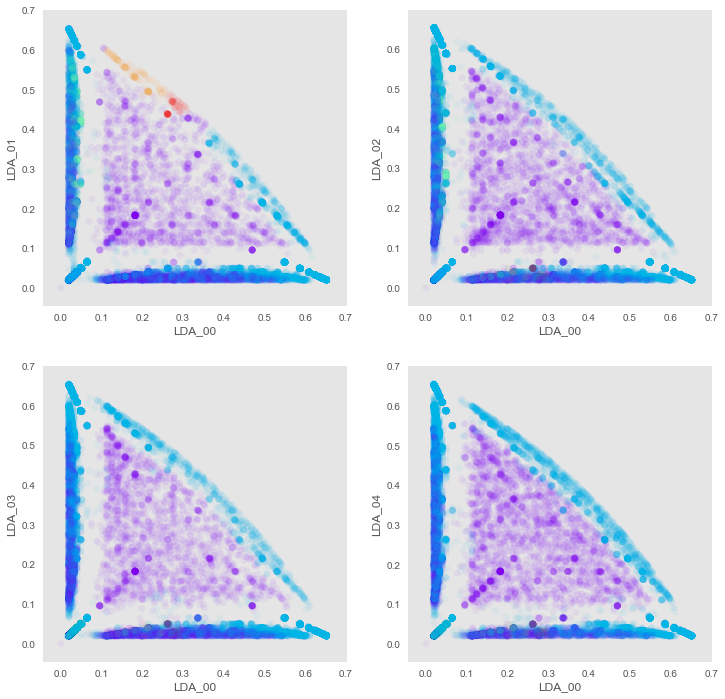

eps, min_pts, nclusters =  0.06 150 5
silhouette =  -0.236628413768


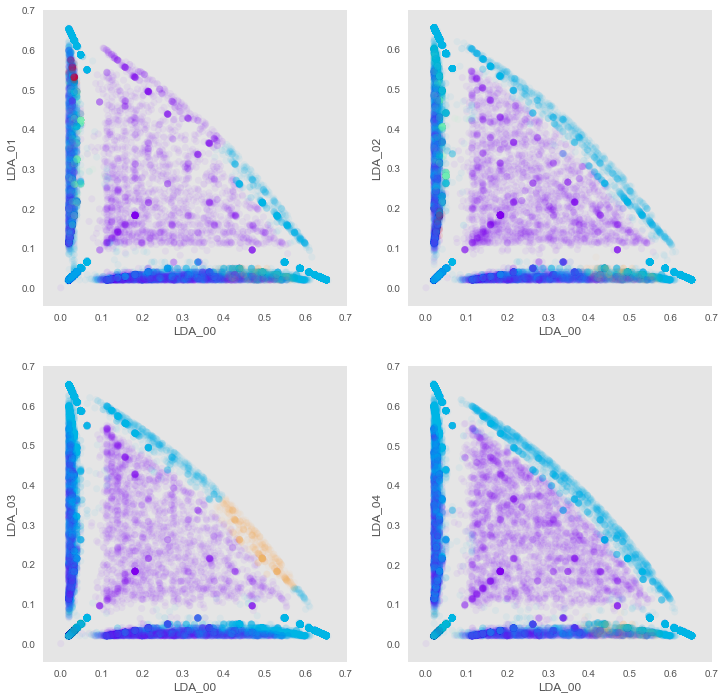

eps, min_pts, nclusters =  0.06 170 5
silhouette =  -0.240219582278


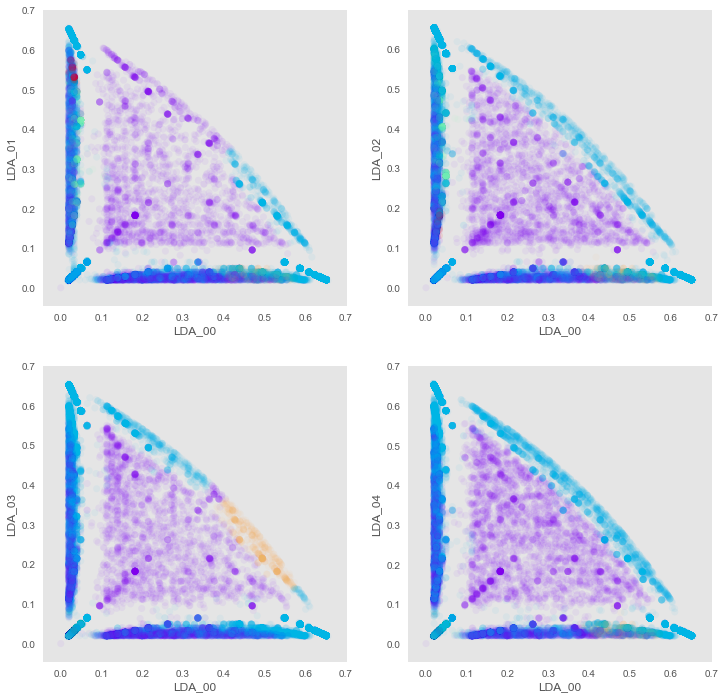

eps, min_pts, nclusters =  0.06 190 6
silhouette =  -0.328024893617


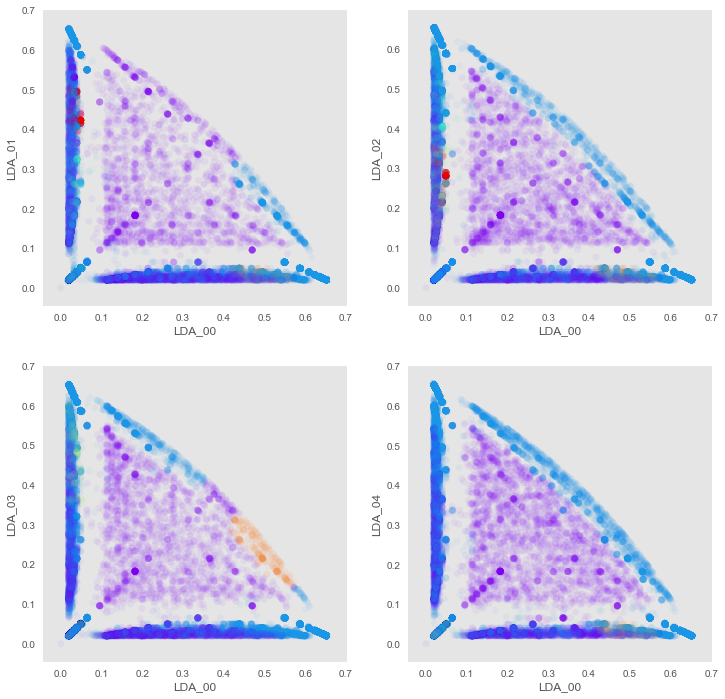

eps, min_pts, nclusters =  0.07 10 19
silhouette =  -0.593974977881


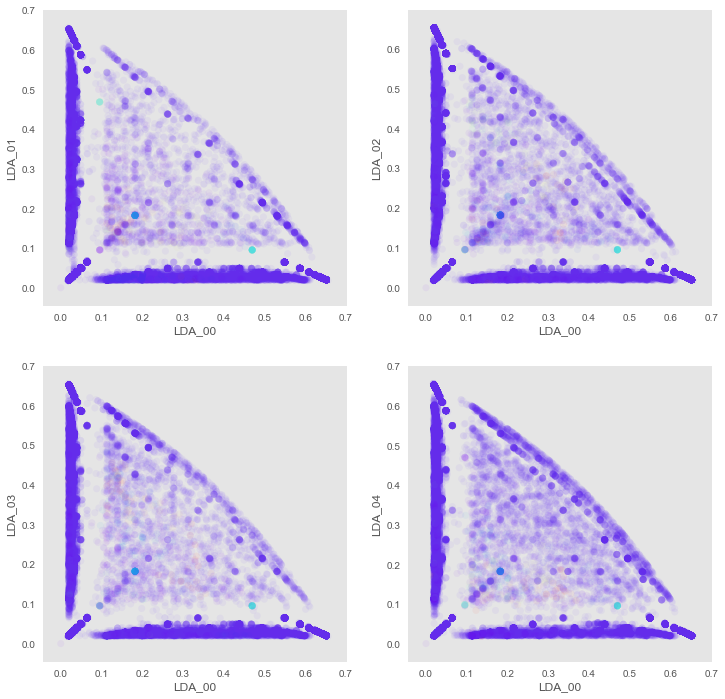

eps, min_pts, nclusters =  0.07 30 5
silhouette =  -0.331453669464


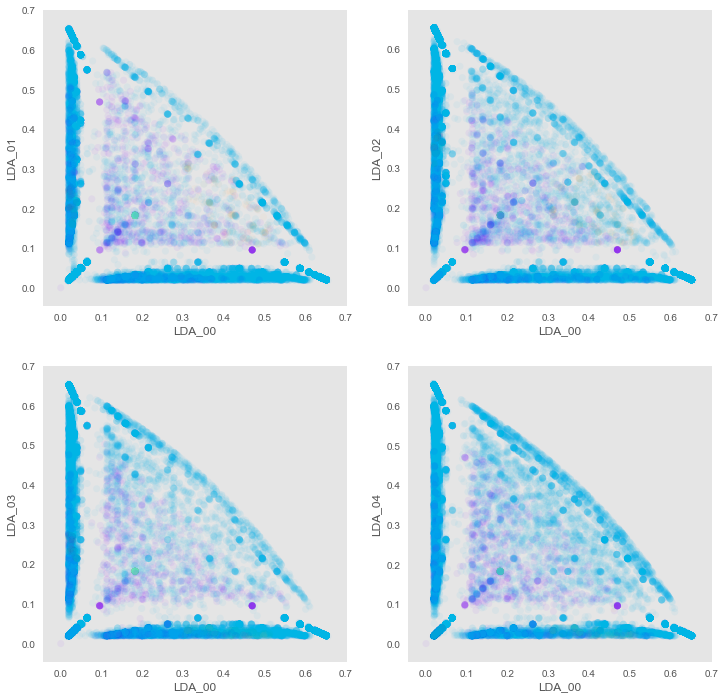

eps, min_pts, nclusters =  0.07 50 7
silhouette =  -0.391438906883


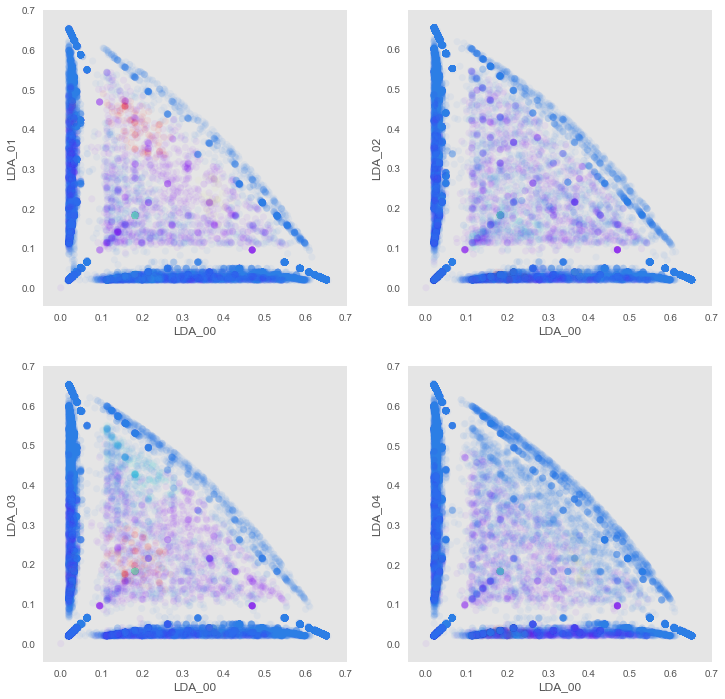

eps, min_pts, nclusters =  0.07 70 6
silhouette =  -0.357396694589


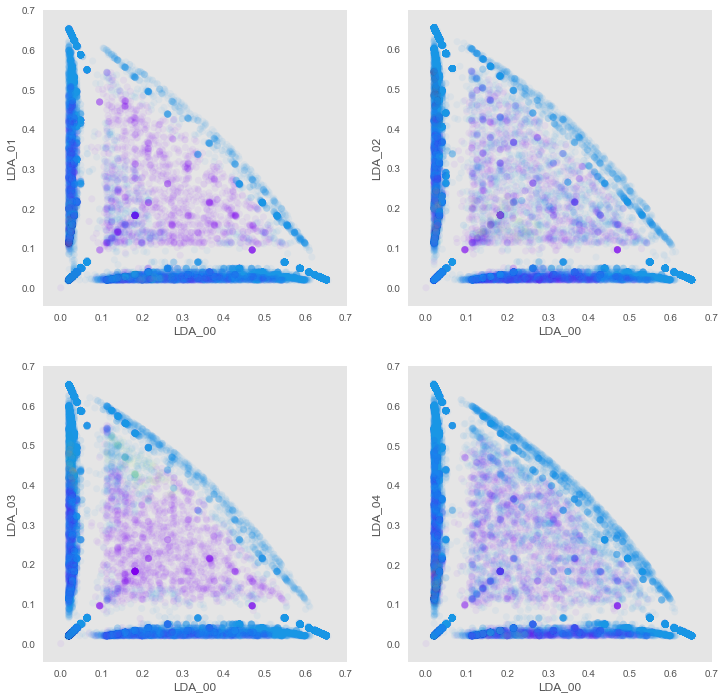

eps, min_pts, nclusters =  0.07 90 4
silhouette =  -0.327372947206


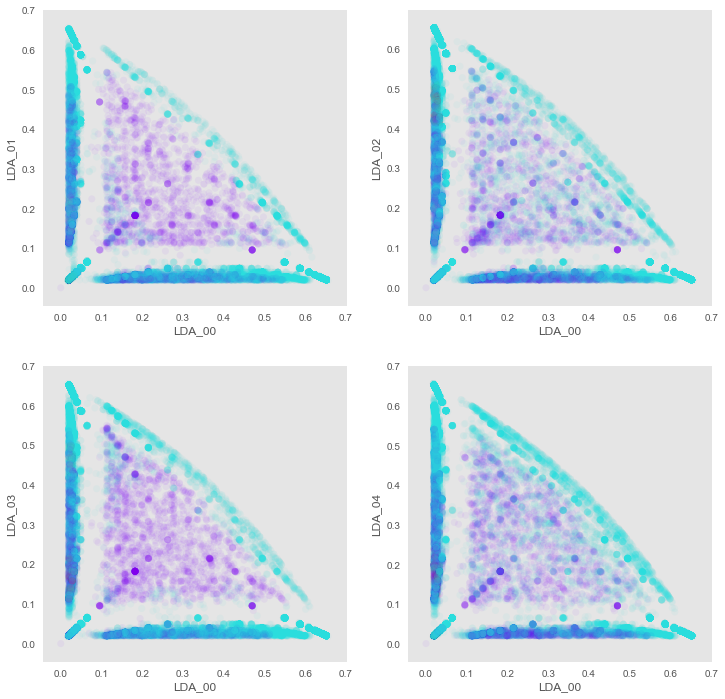

eps, min_pts, nclusters =  0.07 110 4
silhouette =  -0.249839903911


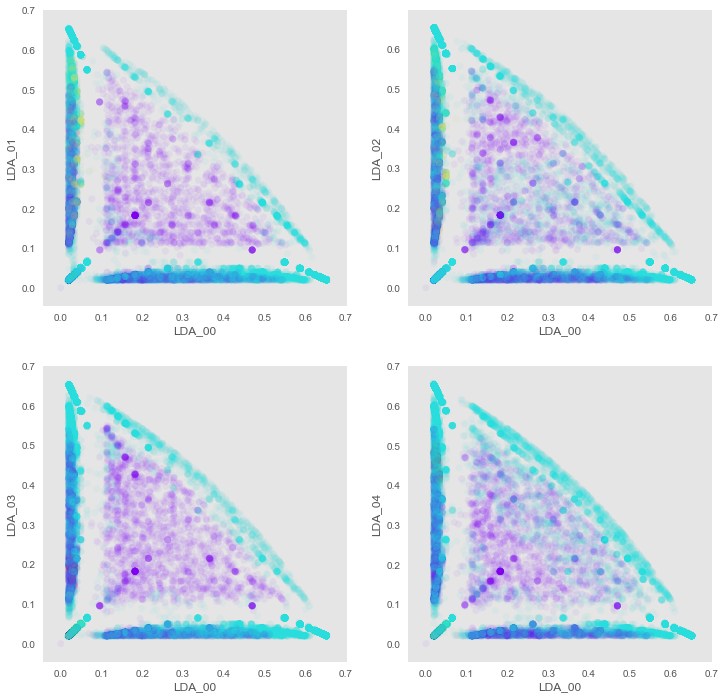

eps, min_pts, nclusters =  0.07 130 6
silhouette =  -0.340759262329


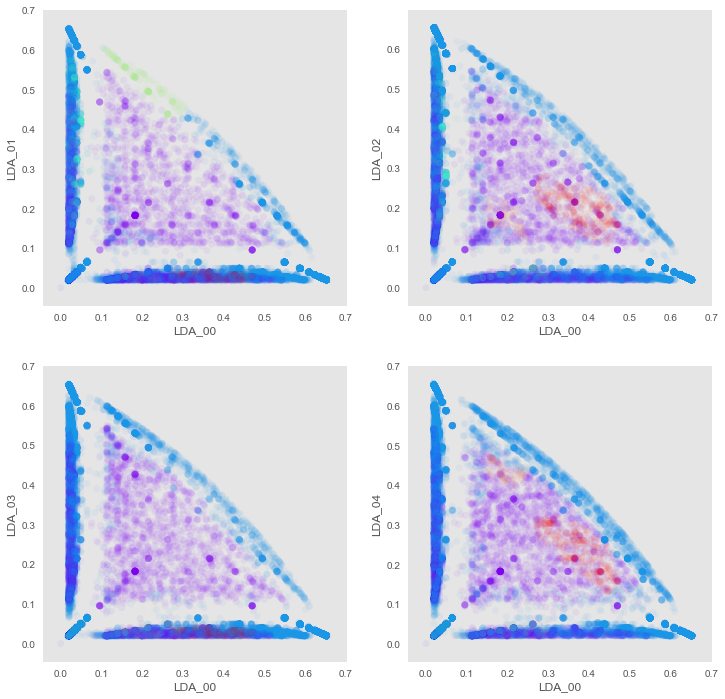

eps, min_pts, nclusters =  0.07 150 4
silhouette =  -0.148342782135


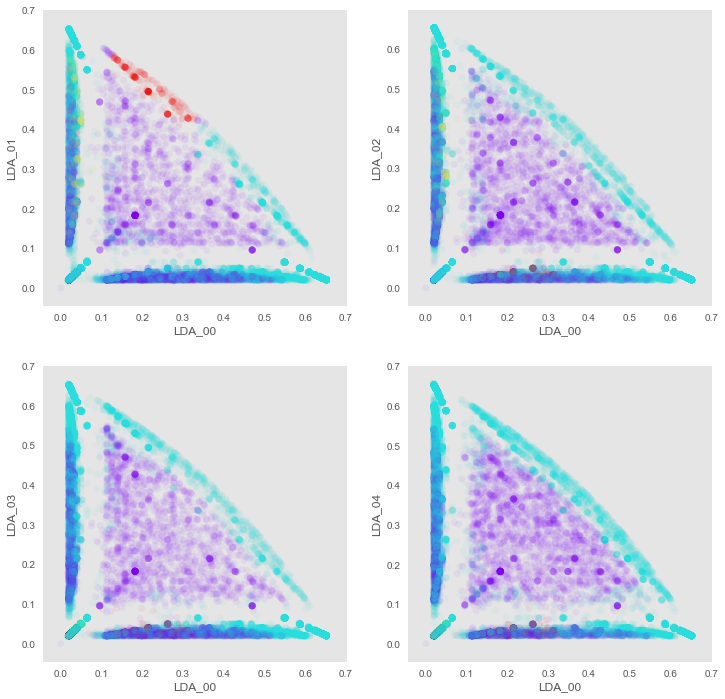

eps, min_pts, nclusters =  0.07 170 4
silhouette =  -0.152319241175


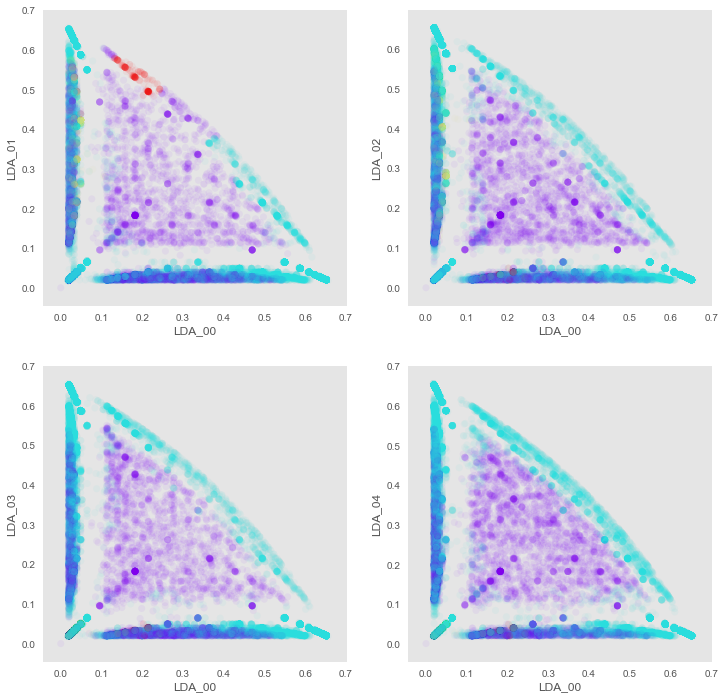

eps, min_pts, nclusters =  0.07 190 5
silhouette =  -0.242241225481


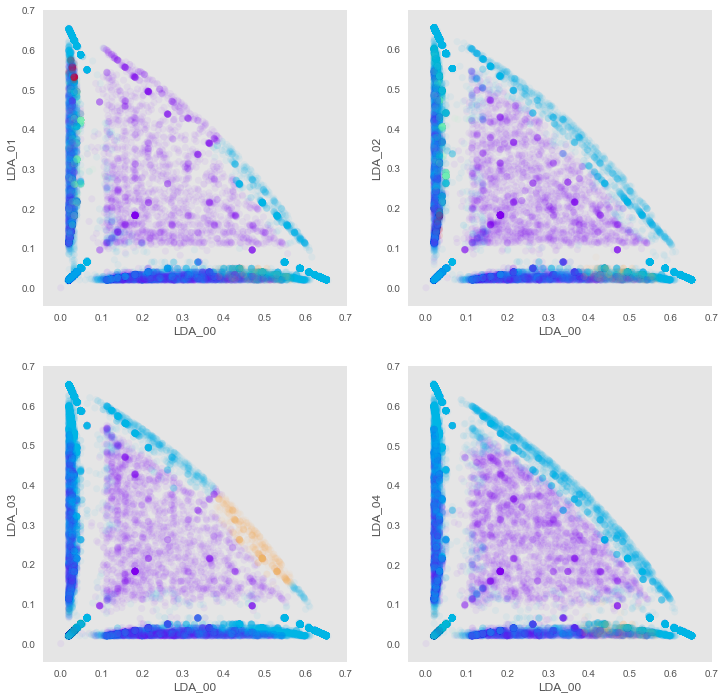

CPU times: user 6min 49s, sys: 10.8 s, total: 7min
Wall time: 6min 45s
Parser   : 124 ms


In [62]:
%%time 

from sklearn.cluster import DBSCAN

params = []
for epsilon in [0.020, 0.03, 0.05, 0.06, 0.07]:
    for min_pts in range (10, 200, 20):
        
        tic = time.clock()
        
        X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]

        # append on the clustering
        
        cls_fam = DBSCAN(eps = epsilon,
                        min_samples = min_pts,
                        n_jobs = -1)
        cls_fam.fit(X1)
        
        dbscan_labels = cls_fam.labels_ # the labels from kmeans clustering
        
        dbscan_nclusters = len(set(dbscan_labels))
       
        print ("eps, min_pts, nclusters = ", epsilon, min_pts, dbscan_nclusters)
        
        dbscan_silhouette = metrics.silhouette_score(X1,
                                                     dbscan_labels,
                                                     metric = 'euclidean',
                                                     sample_size = 10000)
        print ("silhouette = ", dbscan_silhouette)

        toc =  time.clock()
        
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

        exe_time = '{0:.4f}'.format(toc-tic)

        raw_data = {
        'model_name' : 'DBScan - LDA features',
        'n_clusters' : dbscan_nclusters,
        'epsilon' : epsilon,
        'min_points' : min_pts,
        'inertia': 0,
        'silhouette': dbscan_silhouette, 
        'process_time' : exe_time
        }

        df_tbl = pd.DataFrame(raw_data,
        columns = ['model_name', 'n_clusters', 'epsilon', 'min_points', 'inertia', 'silhouette', 'process_time'],
        index = [i_index + 1])

        dbscan_tbl = dbscan_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
        
        plt.figure(figsize=(12, 12))
        plt.subplot(221)
        X1 = X1.values
        plt.scatter(X1[:, 0], X1[:, 1],
                    c = dbscan_labels,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_01')
        plt.grid()

        plt.subplot(222)
        plt.scatter(X1[:, 0], X1[:, 2],
                    c = dbscan_labels,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_02')
        plt.grid()

        plt.subplot(223)
        plt.scatter(X1[:, 0], X1[:, 3],
                    c = dbscan_labels,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_03')
        plt.grid()

        plt.subplot(224)
        plt.scatter(X1[:, 0], X1[:, 4],
                    c = dbscan_labels,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_04')
        plt.grid()

        plt.show();
        
#        y = df_imputed['Survived']
#        X = df_imputed[['IsMale','Pclass','Fare']]
#        X = np.column_stack((X,pd.get_dummies(newfeature_fam)))

#        acc = cross_val_score(clf,X,y=y,cv=cv)
#        params.append((n_fare,n_fam,acc.mean()*100,acc.std()*100)) # save state

#        print (eps,mpts,"Average accuracy = ", acc.mean()*100, "+-", acc.std()*100)
 

In [63]:
dbscan_tbl

,model_name,n_clusters,epsilon,min_points,inertia,silhouette,process_time
1,DBScan - LDA features,153,0.02,10,0,-0.085596,5.4238
1,DBScan - LDA features,60,0.02,30,0,0.031906,4.1262
1,DBScan - LDA features,56,0.02,50,0,0.101427,3.9388
1,DBScan - LDA features,48,0.02,70,0,0.077119,3.9319
1,DBScan - LDA features,41,0.02,90,0,0.036830,3.7415
1,DBScan - LDA features,33,0.02,110,0,0.043183,3.6792
1,DBScan - LDA features,32,0.02,130,0,0.025074,3.6319
1,DBScan - LDA features,27,0.02,150,0,-0.012065,3.5670
1,DBScan - LDA features,19,0.02,170,0,-0.059899,3.4972
1,DBScan - LDA features,17,0.02,190,0,-0.071164,3.4778


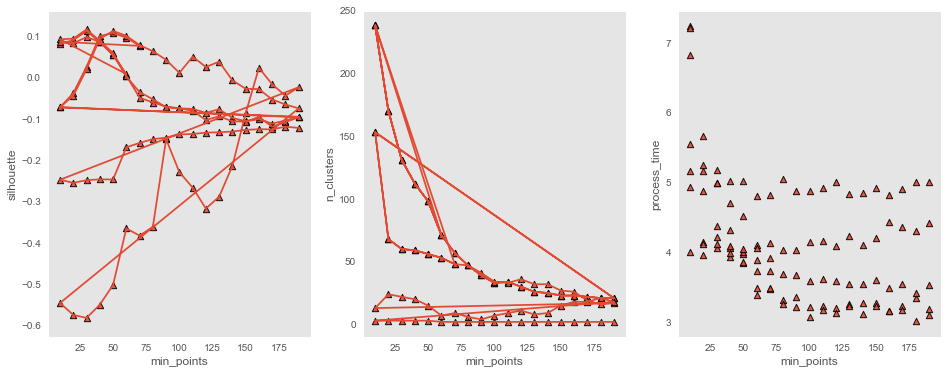

In [60]:


# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(131);
plt.scatter(dbscan_tbl['min_points'],
            dbscan_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(dbscan_tbl['min_points'],
         dbscan_tbl['silhouette'])

plt.xlabel('min_points'), plt.ylabel('silhouette');
plt.grid();

# ... inertia values

plt.subplot(132);
plt.scatter(dbscan_tbl['min_points'],
            dbscan_tbl['n_clusters'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(dbscan_tbl['min_points'],
         dbscan_tbl['n_clusters'])

plt.xlabel('min_points'), plt.ylabel('n_clusters');
plt.grid();

# ... process time

plt.subplot(133);
plt.scatter(dbscan_tbl['min_points'],
            dbscan_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(dbscan_tbl['n_clusters'],
#         dbscan_tbl['process_time'])

plt.xlabel('min_points'), plt.ylabel('process_time');
plt.grid();


plt.show();


<a href='#toc'> Table of Contents</a>

<a name='spectral_clustering'></a>
<font color="blue" size=3>  Spectral Clustering

### Spectral Clustering  - 5 selected features


In [80]:
# set required variables for model comparison

spc_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

n_clusters =  2


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:234: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


silhouette =  0.513948316463


(<matplotlib.text.Text at 0x7f4b77307dd8>,
 <matplotlib.text.Text at 0x7f4b91e4fac8>)

(<matplotlib.text.Text at 0x7f4b91e93cf8>,
 <matplotlib.text.Text at 0x7f4b805a39b0>)

(<matplotlib.text.Text at 0x7f4b77762dd8>,
 <matplotlib.text.Text at 0x7f4b91e2db38>)

(<matplotlib.text.Text at 0x7f4b8029f828>,
 <matplotlib.text.Text at 0x7f4b9002df60>)

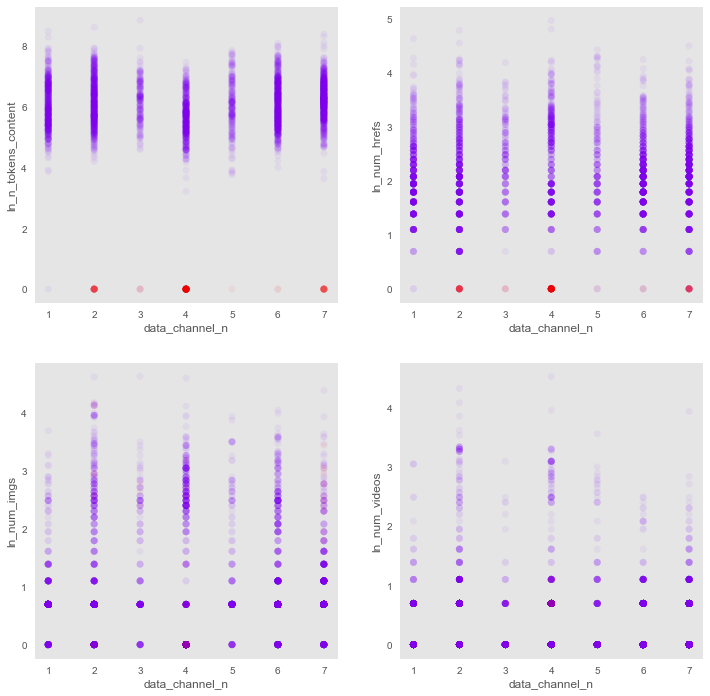

n_clusters =  3
silhouette =  0.469157506079


(<matplotlib.text.Text at 0x7f4b92bbc518>,
 <matplotlib.text.Text at 0x7f4b9058f4a8>)

(<matplotlib.text.Text at 0x7f4b7743ff28>,
 <matplotlib.text.Text at 0x7f4b805575f8>)

(<matplotlib.text.Text at 0x7f4b774dec50>,
 <matplotlib.text.Text at 0x7f4b900d4f98>)

(<matplotlib.text.Text at 0x7f4b91e67048>,
 <matplotlib.text.Text at 0x7f4b91e67668>)

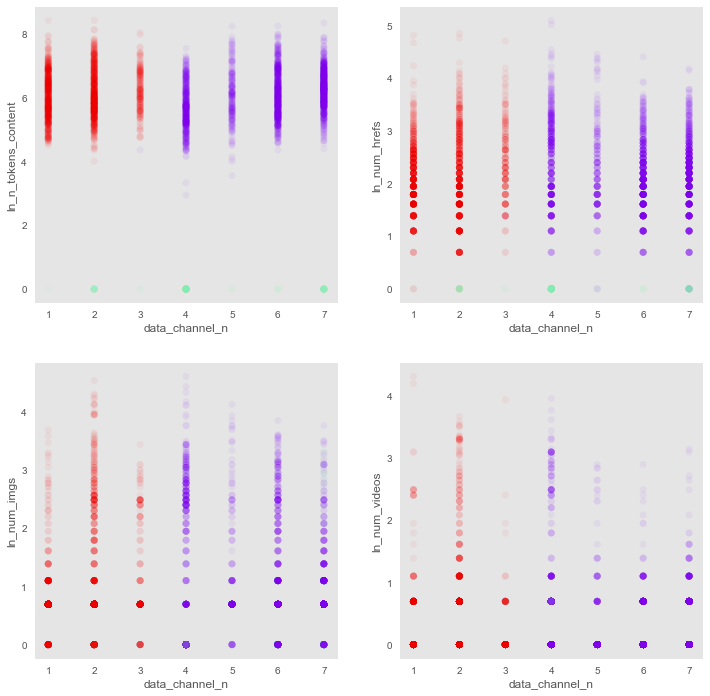

n_clusters =  4
silhouette =  0.277642447465


(<matplotlib.text.Text at 0x7f4b777e4048>,
 <matplotlib.text.Text at 0x7f4b91bd9400>)

(<matplotlib.text.Text at 0x7f4b775d88d0>,
 <matplotlib.text.Text at 0x7f4b773c2b00>)

(<matplotlib.text.Text at 0x7f4b91f520b8>,
 <matplotlib.text.Text at 0x7f4b91f55438>)

(<matplotlib.text.Text at 0x7f4b92cc5eb8>,
 <matplotlib.text.Text at 0x7f4b92ce0748>)

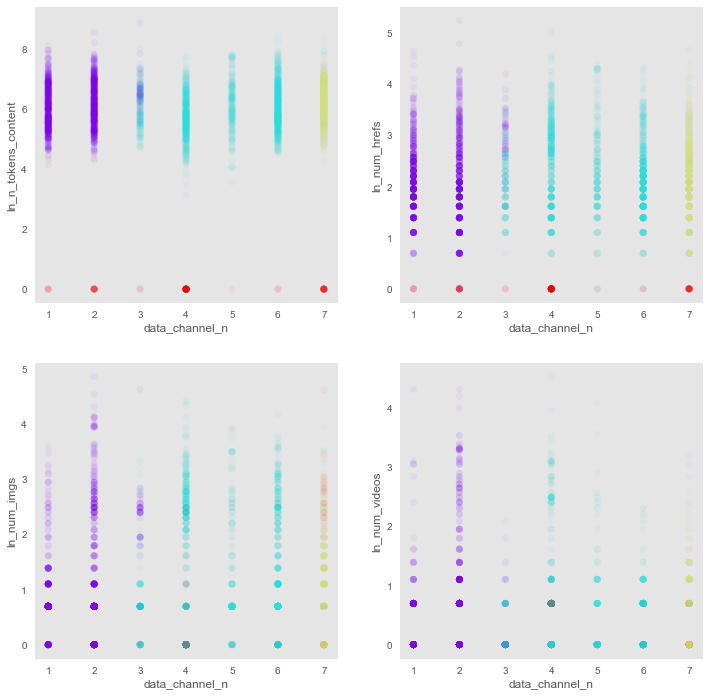

n_clusters =  5
silhouette =  0.137926081974


(<matplotlib.text.Text at 0x7f4b91ea0e10>,
 <matplotlib.text.Text at 0x7f4b91dc70f0>)

(<matplotlib.text.Text at 0x7f4b91ccae48>,
 <matplotlib.text.Text at 0x7f4b91cb31d0>)

(<matplotlib.text.Text at 0x7f4b91adf630>,
 <matplotlib.text.Text at 0x7f4b91aeb860>)

(<matplotlib.text.Text at 0x7f4b91c98588>,
 <matplotlib.text.Text at 0x7f4b91dc37f0>)

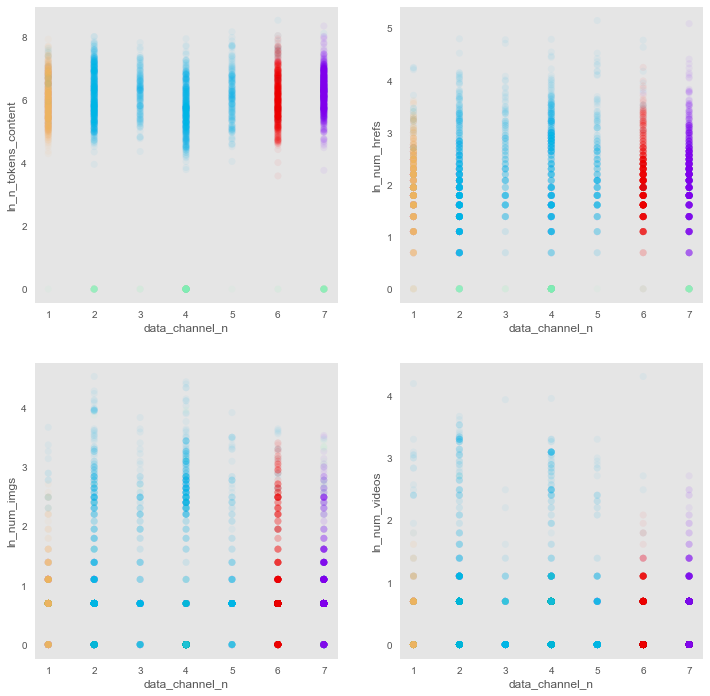

n_clusters =  6
silhouette =  0.166255692316


(<matplotlib.text.Text at 0x7f4b91ba94a8>,
 <matplotlib.text.Text at 0x7f4b91bc7cf8>)

(<matplotlib.text.Text at 0x7f4b775a4550>,
 <matplotlib.text.Text at 0x7f4b92cc6940>)

(<matplotlib.text.Text at 0x7f4b9037a630>,
 <matplotlib.text.Text at 0x7f4b91f5d198>)

(<matplotlib.text.Text at 0x7f4b8002ee80>,
 <matplotlib.text.Text at 0x7f4b775b9470>)

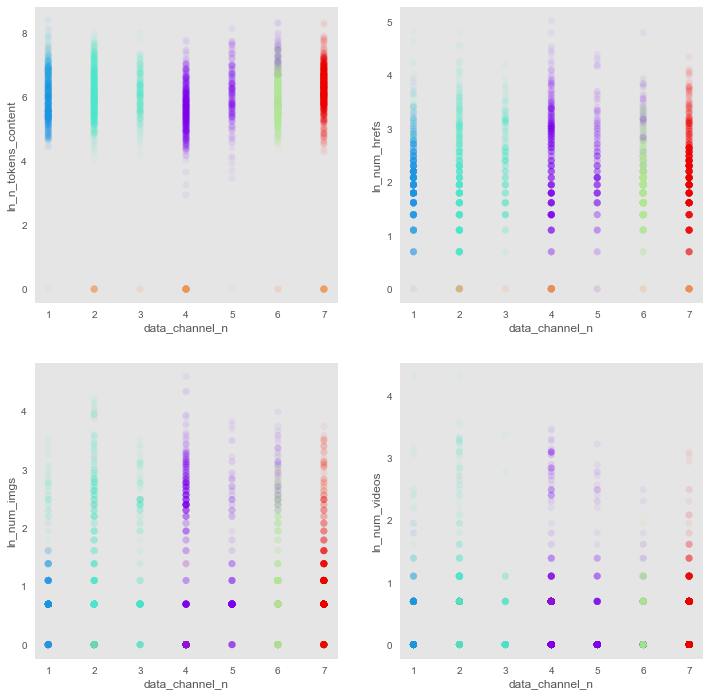

n_clusters =  7
silhouette =  0.12099864669


(<matplotlib.text.Text at 0x7f4b91d71c88>,
 <matplotlib.text.Text at 0x7f4b926079b0>)

(<matplotlib.text.Text at 0x7f4b777625c0>,
 <matplotlib.text.Text at 0x7f4b776f27f0>)

(<matplotlib.text.Text at 0x7f4b770f64e0>,
 <matplotlib.text.Text at 0x7f4b91e4f240>)

(<matplotlib.text.Text at 0x7f4b91e4f860>,
 <matplotlib.text.Text at 0x7f4b91b8cc88>)

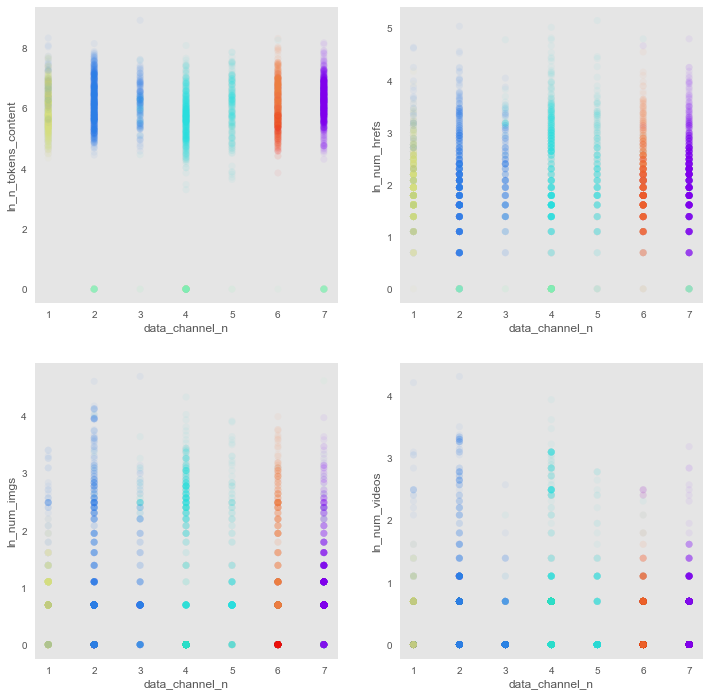

n_clusters =  8
silhouette =  0.104695361366


(<matplotlib.text.Text at 0x7f4b926aad68>,
 <matplotlib.text.Text at 0x7f4b90046fd0>)

(<matplotlib.text.Text at 0x7f4b80190b38>,
 <matplotlib.text.Text at 0x7f4b804f3630>)

(<matplotlib.text.Text at 0x7f4b8040eeb8>,
 <matplotlib.text.Text at 0x7f4b91f25d30>)

(<matplotlib.text.Text at 0x7f4b91f251d0>,
 <matplotlib.text.Text at 0x7f4b804d1908>)

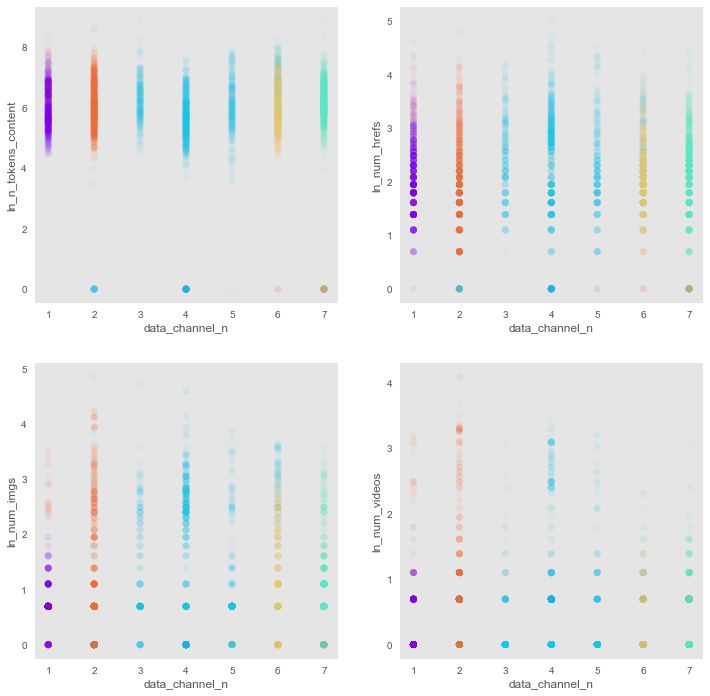

n_clusters =  9
silhouette =  0.143887177055


(<matplotlib.text.Text at 0x7f4b804256d8>,
 <matplotlib.text.Text at 0x7f4b92c32a58>)

(<matplotlib.text.Text at 0x7f4b77385cf8>,
 <matplotlib.text.Text at 0x7f4b771562b0>)

(<matplotlib.text.Text at 0x7f4b773f4278>,
 <matplotlib.text.Text at 0x7f4b92bb82b0>)

(<matplotlib.text.Text at 0x7f4b92c50080>,
 <matplotlib.text.Text at 0x7f4b92c507f0>)

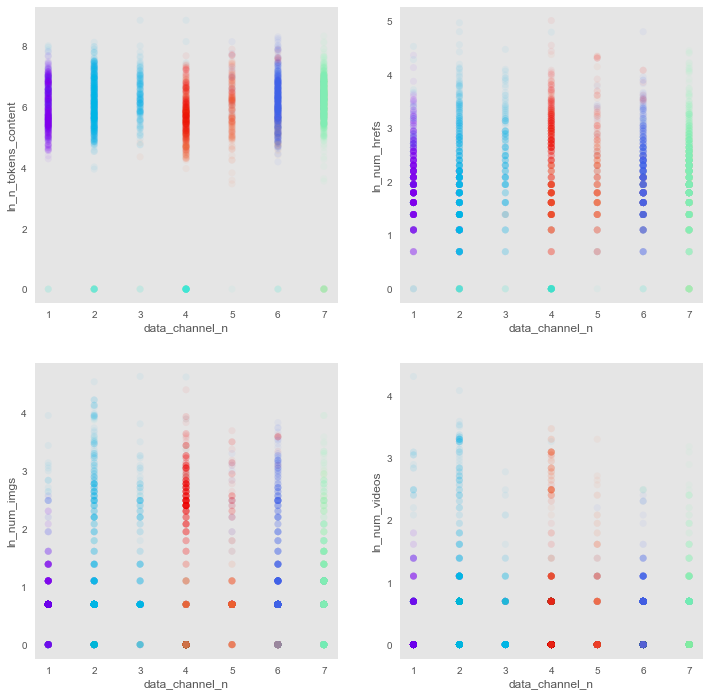

n_clusters =  10
silhouette =  0.00688832942488


(<matplotlib.text.Text at 0x7f4b802d4588>,
 <matplotlib.text.Text at 0x7f4b904299e8>)

(<matplotlib.text.Text at 0x7f4b775b9ba8>,
 <matplotlib.text.Text at 0x7f4b7772b780>)

(<matplotlib.text.Text at 0x7f4b900a4940>,
 <matplotlib.text.Text at 0x7f4b805da748>)

(<matplotlib.text.Text at 0x7f4b8029fcc0>,
 <matplotlib.text.Text at 0x7f4b91b9fcf8>)

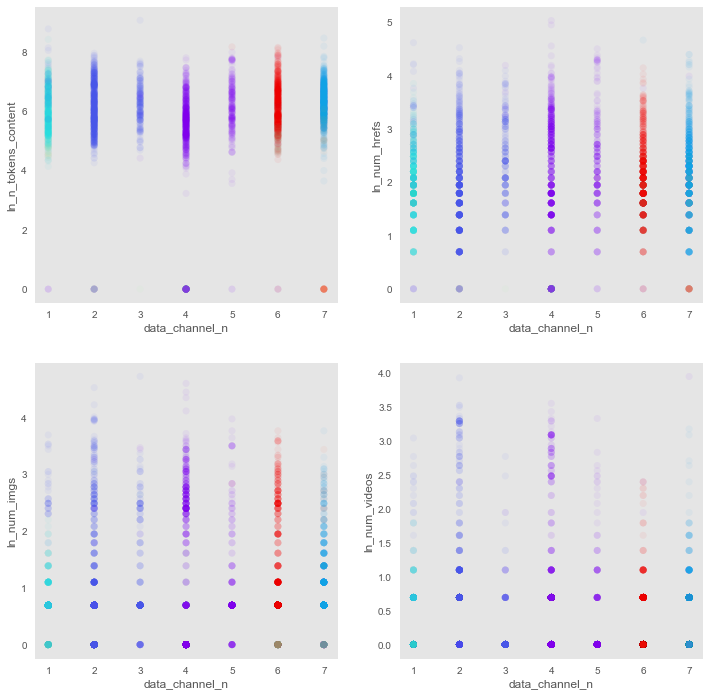

n_clusters =  11
silhouette =  0.107343619097


(<matplotlib.text.Text at 0x7f4b92c47cf8>,
 <matplotlib.text.Text at 0x7f4b92645080>)

(<matplotlib.text.Text at 0x7f4b92bbae10>,
 <matplotlib.text.Text at 0x7f4b91f7f080>)

(<matplotlib.text.Text at 0x7f4b92cc35f8>,
 <matplotlib.text.Text at 0x7f4b91ee1828>)

(<matplotlib.text.Text at 0x7f4b91ed5470>,
 <matplotlib.text.Text at 0x7f4b91ed5cf8>)

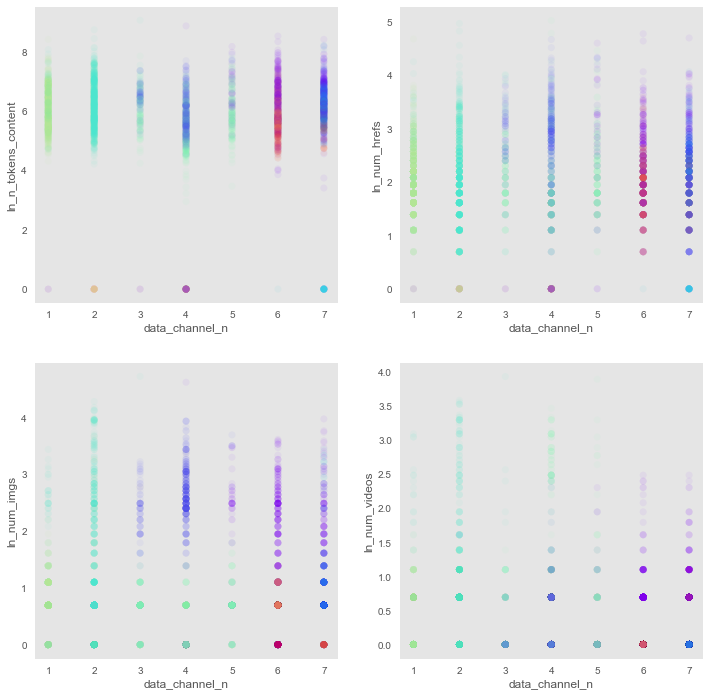

,model_name,n_clusters,inertia,silhouette,process_time
1,spc - LDA features,2,0,0.513948,3.0362
1,spc - LDA features,3,0,0.469158,2.2964
1,spc - LDA features,4,0,0.277642,2.5837
1,spc - LDA features,5,0,0.137926,2.4575
1,spc - LDA features,6,0,0.166256,2.3021
1,spc - LDA features,7,0,0.120999,2.6126
1,spc - LDA features,8,0,0.104695,2.4773
1,spc - LDA features,9,0,0.143887,2.5353
1,spc - LDA features,10,0,0.006888,2.4749
1,spc - LDA features,11,0,0.107344,2.7446


In [81]:
from sklearn.cluster import SpectralClustering

# If a string, this may be one of 
#  ‘nearest_neighbors’, ‘precomputed’, ‘rbf’ 
#  or one of the kernels supported by sklearn.metrics.pairwise_kernels

for n_clstr in range(2, 12):   

    tic = time.clock()
    
    print ("n_clusters = ", n_clstr)

    X1 = df_cluster[['data_channel_n',
                     'ln_n_tokens_content',
                     'ln_num_hrefs',
                     'ln_num_imgs',
                     'ln_num_videos',]]
    
    X1 = X1.sample(frac = 0.1)

    spc = SpectralClustering(n_clusters = n_clstr,
                             affinity = 'nearest_neighbors')

    spc_labels = spc.fit_predict(X1)
    
    spc_silhouette = metrics.silhouette_score(X1,
                                                 spc_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", spc_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'spc - LDA features',
    'n_clusters' : n_clstr,
    'inertia': 0,
    'silhouette': spc_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    spc_tbl = spc_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize=(12, 12));
    
    plt.subplot(221);
    X1 = X1.values;
    plt.scatter(X1[:, 0], X1[:, 1],
                c = spc_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.xlabel('data_channel_n'), plt.ylabel('ln_n_tokens_content');
    plt.grid();

    plt.subplot(222);
    plt.scatter(X1[:, 0], X1[:, 2],
                c = spc_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.xlabel('data_channel_n'), plt.ylabel('ln_num_hrefs');
    plt.grid();

    plt.subplot(223);
    plt.scatter(X1[:, 0], X1[:, 3],
                c = spc_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.xlabel('data_channel_n'), plt.ylabel('ln_num_imgs');
    plt.grid();

    plt.subplot(224);
    plt.scatter(X1[:, 0], X1[:, 4],
                c = spc_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.xlabel('data_channel_n'), plt.ylabel('ln_num_videos');
    plt.grid();

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - print out comparison table
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

spc_tbl


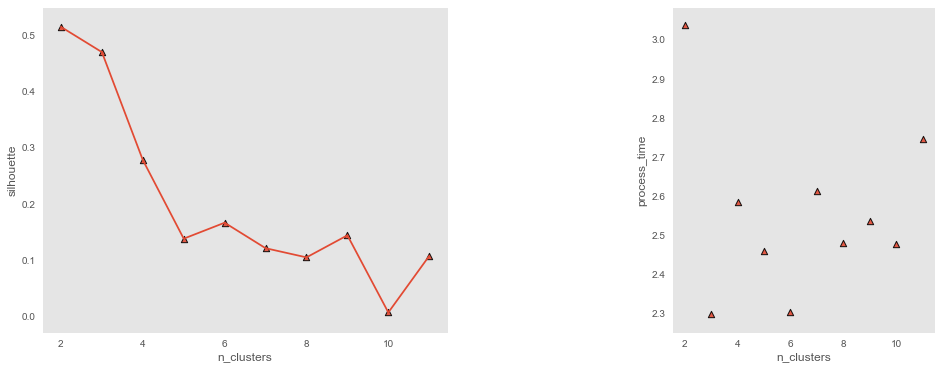

In [82]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(121);
plt.scatter(spc_tbl['n_clusters'],
            spc_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(spc_tbl['n_clusters'],
         spc_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.grid();


# ... process time

plt.subplot(133);
plt.scatter(spc_tbl['n_clusters'],
            spc_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(spc_tbl['n_clusters'],
#         spc_tbl['process_time'])

plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.grid();


plt.show();


<a href='#toc'> Table of Contents</a>

<a name='t-sne'></a>
<font color="blue" size=3> t-SNE

### t-SNE  


In [10]:
from sklearn.manifold import TSNE

X1 = df_cluster
X1['ln_shares'] = df_ONP['ln_shares']
X1['popular'] = df_ONP['popular']
                     
X1 = X1.sample(frac = 0.30)

X1_ln_shares = X1['ln_shares']
X1_popular = X1['popular']

columns_to_drop = ['ln_shares', 'popular']
X1.drop(columns_to_drop, axis = 1, inplace = True)

tic = time.clock()

tsne = TSNE(n_components = 2, verbose = 1, perplexity = 20, n_iter = 300)

tsne_results = tsne.fit_transform(X1)

toc = time.clock()
print (toc - tic)

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 11893 samples in 0.031s...
[t-SNE] Computed neighbors for 11893 samples in 7.117s...
[t-SNE] Computed conditional probabilities for sample 1000 / 11893
[t-SNE] Computed conditional probabilities for sample 2000 / 11893
[t-SNE] Computed conditional probabilities for sample 3000 / 11893
[t-SNE] Computed conditional probabilities for sample 4000 / 11893
[t-SNE] Computed conditional probabilities for sample 5000 / 11893
[t-SNE] Computed conditional probabilities for sample 6000 / 11893
[t-SNE] Computed conditional probabilities for sample 7000 / 11893
[t-SNE] Computed conditional probabilities for sample 8000 / 11893
[t-SNE] Computed conditional probabilities for sample 9000 / 11893
[t-SNE] Computed conditional probabilities for sample 10000 / 11893
[t-SNE] Computed conditional probabilities for sample 11000 / 11893
[t-SNE] Computed conditional probabilities for sample 11893 / 11893
[t-SNE] Mean sigma: 1.020327
[t-SNE] KL divergence

In [11]:
tsne_results


array([[-0.16156054, -1.02522528],
       [-4.831635  , -9.05488968],
       [-3.46958184,  5.65509605],
       ..., 
       [-5.53555012, -2.43374944],
       [ 1.78576636, -3.68728805],
       [ 4.49238443,  2.70392346]], dtype=float32)

/home/mcdevitt/anaconda3/lib/python3.6/site-packages/ggplot/utils.py:81: FutureWarning: pandas.tslib is deprecated and will be removed in a future version.
You can access Timestamp as pandas.Timestamp
  pd.tslib.Timestamp,
/home/mcdevitt/anaconda3/lib/python3.6/site-packages/ggplot/stats/smoothers.py:4: FutureWarning: The pandas.lib module is deprecated and will be removed in a future version. These are private functions and can be accessed from pandas._libs.lib instead
  from pandas.lib import Timestamp
/home/mcdevitt/anaconda3/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


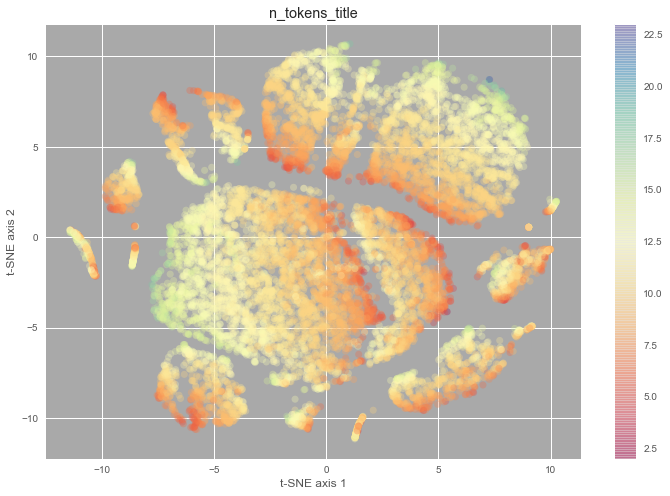

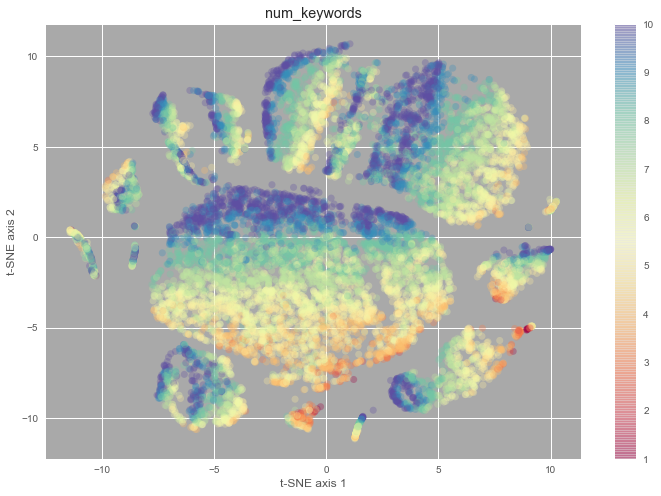

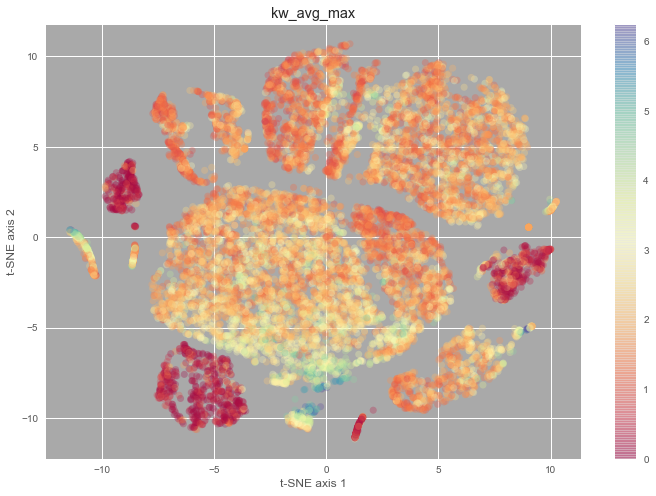

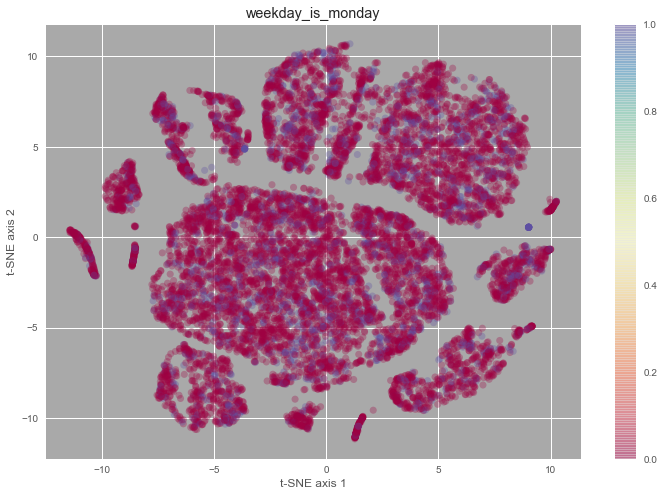

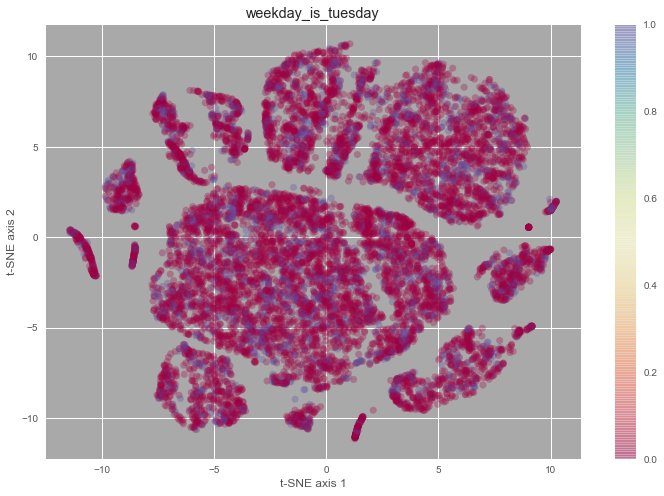

...

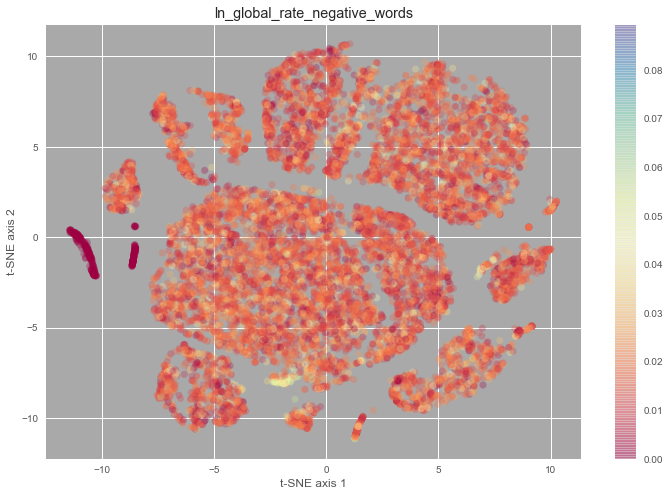

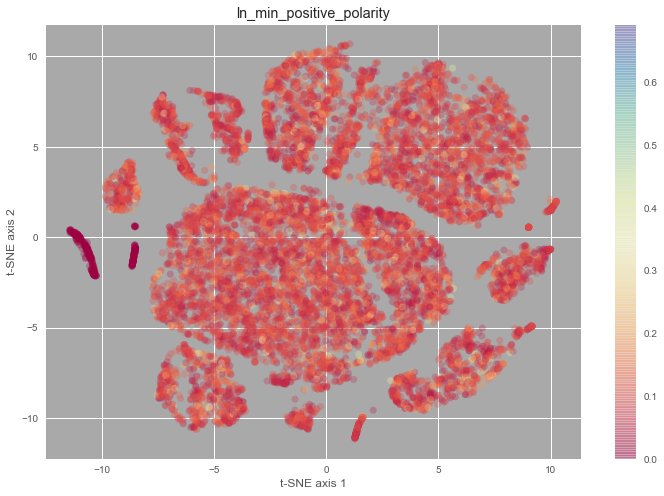

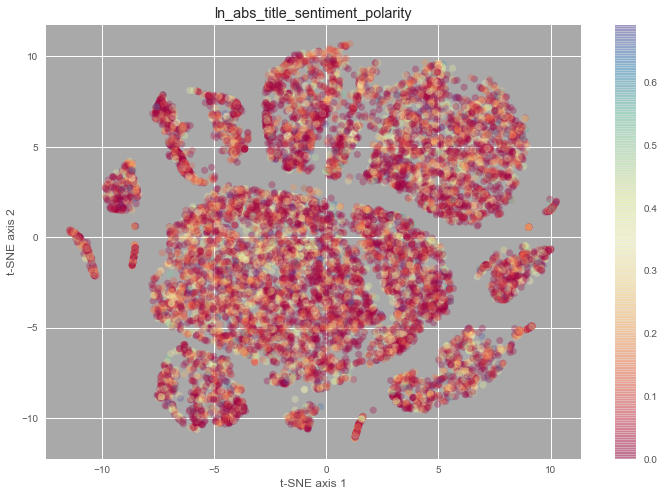

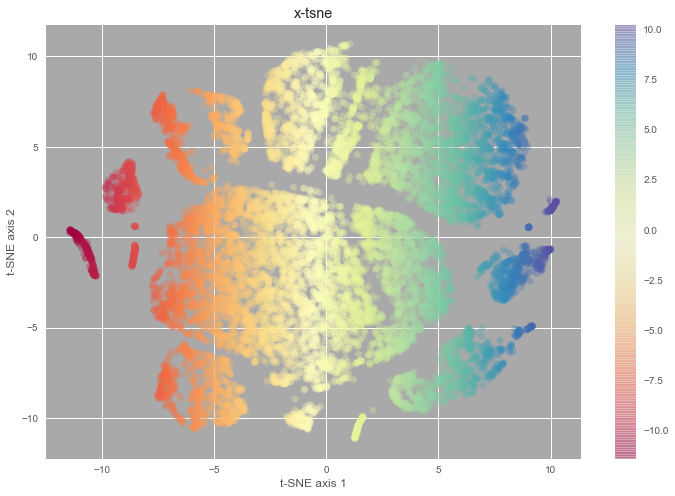

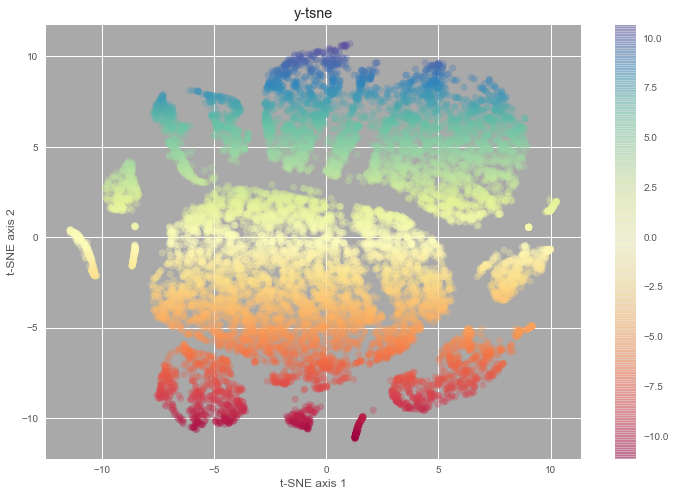

In [12]:
from ggplot import *
from ggplot import scale_fill_brewer
from matplotlib import cm

df_tsne = X1.copy()
df_tsne['x-tsne'] = tsne_results[:,0]
df_tsne['y-tsne'] = tsne_results[:,1]

col_names = df_tsne.columns.values.tolist()

for col in col_names :
    plt.figure(figsize=(12, 8));
    plt.subplot(111, axisbg='darkgrey');
    plt.scatter(df_tsne['x-tsne'], df_tsne['y-tsne'],
                 c = df_tsne[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    plt.colorbar()
    plt.xlabel('t-SNE axis 1')
    plt.ylabel('t-SNE axis 2')
    plt.title(col)
    plt.grid(True)
    plt.show();


In [53]:
tsne_results
len(tsne_results)

array([[-7.27036047, -7.39203596],
       [-4.30204678, -2.78878784],
       [-7.23836279, -7.35845089],
       ..., 
       [-0.13344206,  7.75149632],
       [-5.45805693, -2.01106119],
       [ 7.89149857, -0.15999043]], dtype=float32)

11893

In [54]:
# set required variables for model comparison

tsne_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

n_lda =  2


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  335687.828242
silhouette =  0.353539


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -1.03165426843 4.1743577841 0


1 0.900705417709 -3.92963016631 1


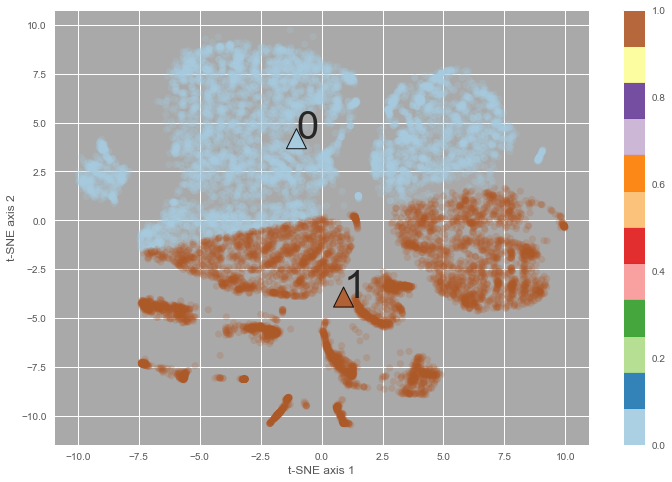

n_lda =  3


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  197070.547982
silhouette =  0.407763


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 5.4812830081 1.27232140538 0


1 -1.47865734874 -4.96504604009 1


2 -3.49967700205 4.07594977745 2


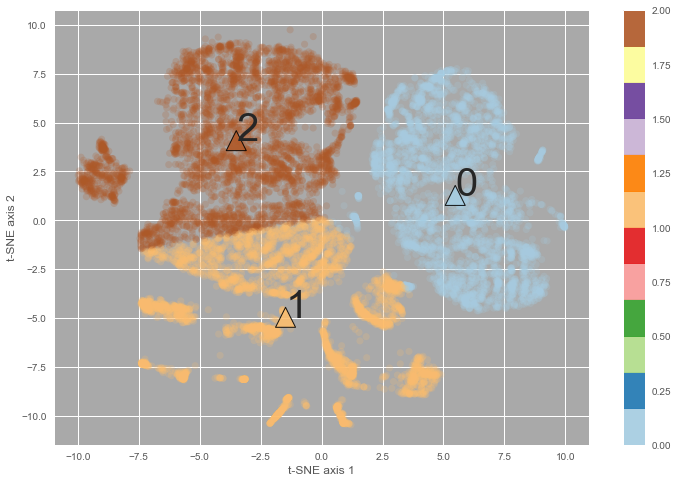

n_lda =  4


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  151591.022476
silhouette =  0.382155


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 5.54905077868 1.21755934531 0


1 0.232004956361 -6.23244368109 1


2 -2.30215296706 5.60549030982 2


3 -4.8111945568 -1.11849547519 3


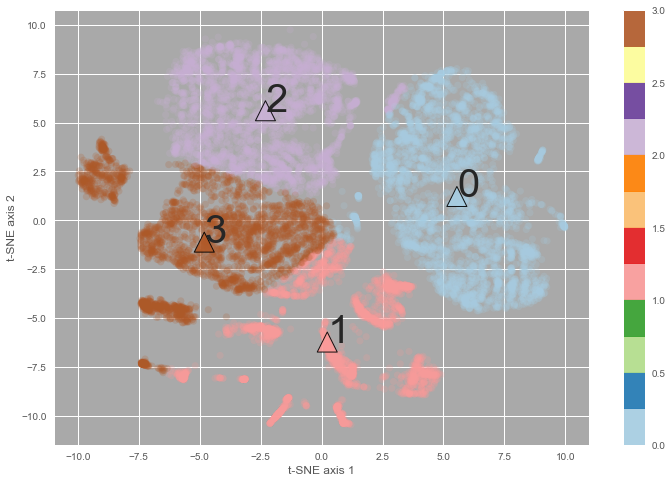

n_lda =  5


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  115876.170601
silhouette =  0.392659


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -4.45183880154 -1.33220604816 0


1 4.63503021315 4.44832428926 1


2 -0.102683130085 -7.01390057728 2


3 -2.73680689613 5.49568583913 3


4 5.68177812817 -1.85442543002 4


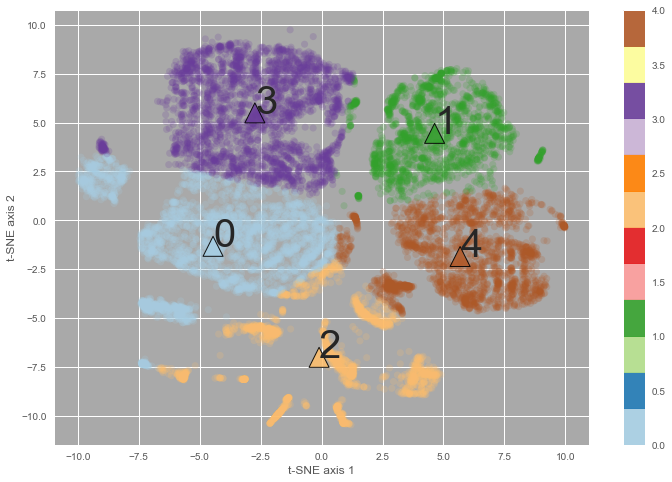

n_lda =  6


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  93820.9459092
silhouette =  0.414505


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -2.80649476443 5.95896874766 0


1 -1.44801908998 -0.656519062768 1


2 5.95559341832 -1.93743832204 2


3 4.64986264663 4.47296982166 3


4 -6.70142044416 -1.41715232161 4


5 -0.0423947248285 -7.34376894003 5


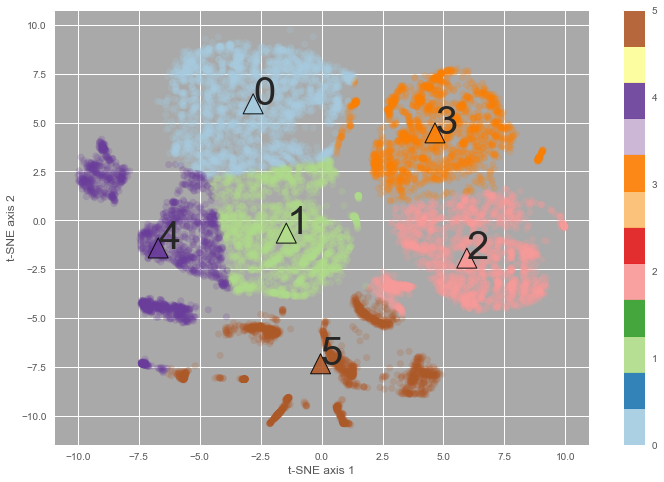

n_lda =  7


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  74467.7153564
silhouette =  0.424657


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -1.32119551779 -0.343912747468 0


1 4.6578459023 4.46872936404 1


2 -6.45553154486 1.39196775122 2


3 1.37094324652 -7.49070327807 3


4 6.04254513147 -1.86808144807 4


5 -4.69599767569 -5.35718735155 5


6 -2.57234578505 6.51239243662 6


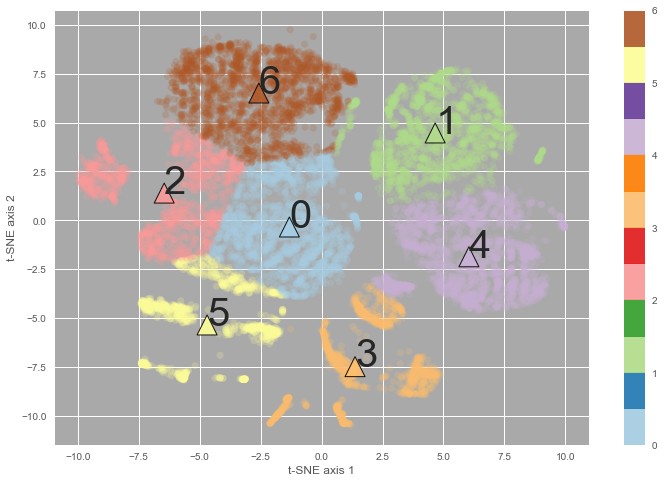

n_lda =  8


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  66794.7117337
silhouette =  0.413839


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -2.6136818747 7.04942494317 0


1 -2.17184392596 2.96366591915 1


2 4.7022978791 4.47172965965 2


3 6.042614532 -1.86974997735 3


4 -6.96803921643 1.01779368492 4


5 -4.94239803464 -5.87773297385 5


6 -1.66362966865 -1.51219136132 6


7 1.36968351483 -7.49943917208 7


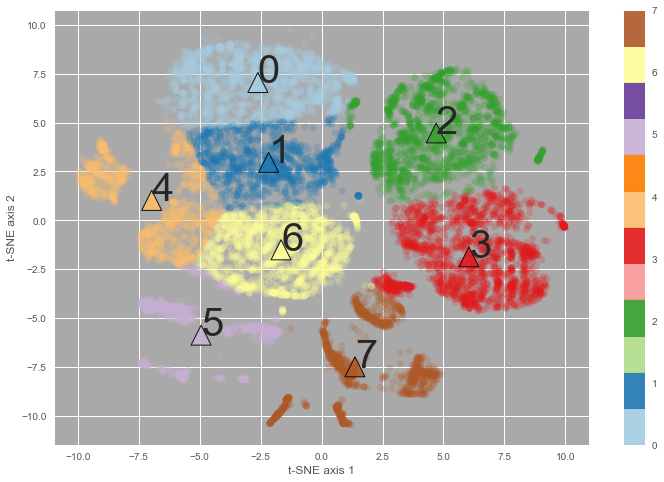

n_lda =  9


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  60000.6049461
silhouette =  0.403291


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 1.13480821548 -8.39665322402 0


1 -1.60356671154 2.24672451989 1


2 4.70177096458 4.47099553352 2


3 1.20247448651 -2.9137323246 3


4 -4.96424731474 -6.04213807693 4


5 -2.58528947123 6.91060389583 5


6 6.54002468479 -1.70795002554 6


7 -3.92425004719 -1.3989959305 7


8 -7.25608062003 2.40402208881 8


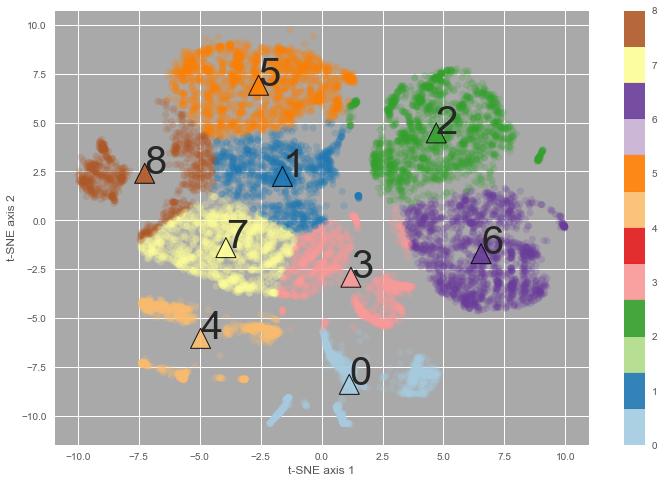

n_lda =  10


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  54062.0015123
silhouette =  0.39865


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -0.581822726575 6.82129794208 0


1 1.12950516322 -8.38618197281 1


2 -1.91036866302 2.57371801178 2


3 1.93679286903 -2.91486781495 3


4 -4.96424731474 -6.04213807693 4


5 4.81125487106 4.41751961776 5


6 6.68427594121 -1.76062234929 6


7 -4.31800218843 6.72506977822 7


8 -7.38343791835 1.34412686347 8


9 -2.77203755256 -1.56401038684 9


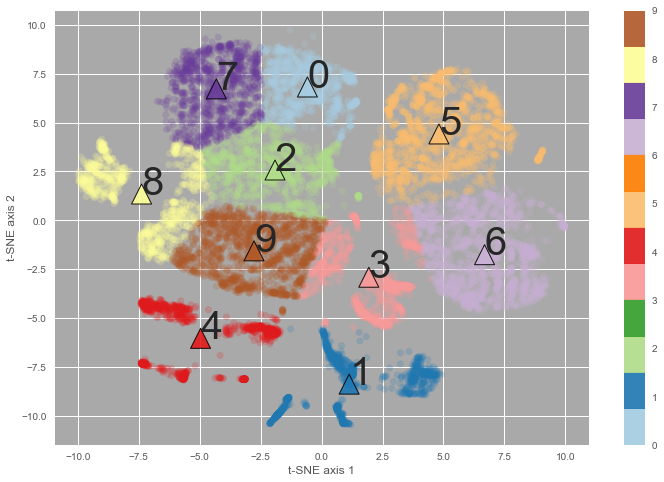

n_lda =  11


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  48632.3017057
silhouette =  0.396865


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 5.29253851797 5.14582166736 0


1 -2.17689848558 2.78956933927 1


2 -4.34312067247 6.82534588474 2


3 7.01599781253 -2.22452090907 3


4 -1.94835365308 -1.63346717914 4


5 -6.25377192114 -5.76725302025 5


6 -7.14609577524 1.0174148644 6


7 -0.819064789035 -7.79631449559 7


8 -0.569240644262 6.83102541789 8


9 3.86019426507 1.25078421126 9


10 2.99804763438 -5.53300721227 10


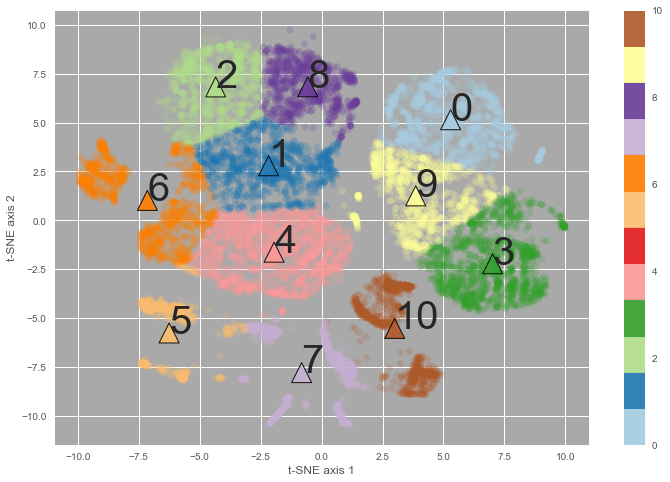

n_lda =  12


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=12, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  44627.6868242
silhouette =  0.41481


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -4.34527255423 6.95818749581 0


1 -0.722907644539 -1.15017332885 1


2 4.80835046659 4.40694116143 2


3 -4.93481727996 -0.938318440004 3


4 6.8547541606 -1.6861982693 4


5 1.16344949256 -8.4678321362 5


6 -2.37059725776 -5.49022615084 6


7 -2.48419946447 2.97012602711 7


8 -8.68582447264 2.50114440415 8


9 -6.47146285141 -5.87470115427 9


10 3.0220386814 -3.41295025505 10


11 -0.56434323678 6.80437769095 11


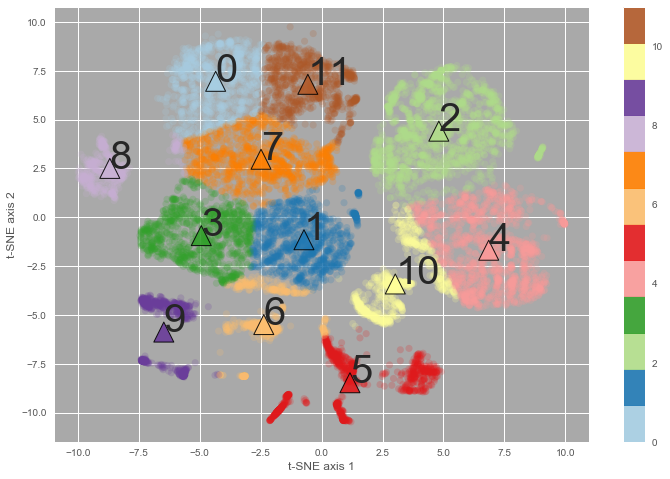

n_lda =  13


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=13, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  40630.4759383
silhouette =  0.40444


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 -4.31677607317 7.28120626596 0


1 1.71995656903 -3.72971830188 1


2 -2.73484970344 -1.43658630192 2


3 5.25323719971 4.98700530211 3


4 -2.30628386162 -7.49883007324 4


5 7.21516920332 -2.82706956205 5


6 -3.44570596525 3.22517207761 6


7 1.98454855664 -8.08836719948 7


8 1.26773330949 2.11312696844 8


9 -6.47019938429 -5.86224633885 9


10 5.41666605386 0.00602804142662 10


11 -0.612650501143 6.83774385197 11


12 -7.80492378998 1.0690214229 12


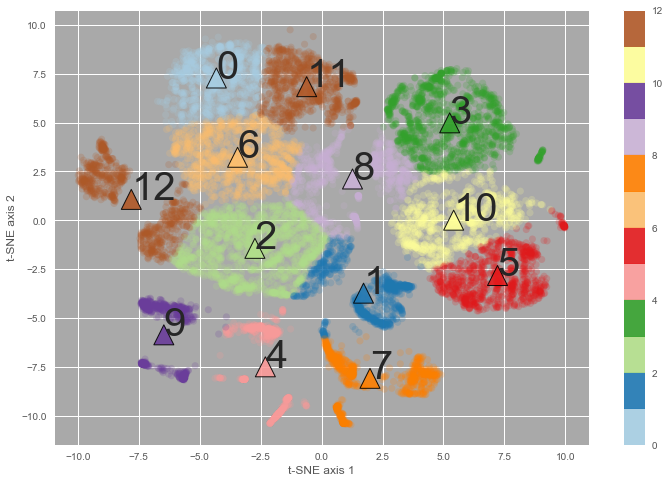

n_lda =  14


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=14, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  35879.5959729
silhouette =  0.417925


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


0 5.61181717981 5.19433555148 0


1 -0.780279818644 -0.988804669689 1


2 -0.6219833058 6.8708448664 2


3 7.22026693589 -2.82787781359 3


4 -2.32455368481 -4.51199740298 4


5 -6.43904622666 -5.90003095454 5


6 -8.98675151412 2.39172568609 6


7 -0.367046495284 -8.53562755039 7


8 2.47937383577 3.15474596415 8


9 5.43459015971 -0.054095353317 9


10 2.99849318645 -5.52566122433 10


11 -5.06552144315 -0.830108781277 11


12 -3.27087866817 3.21593872387 12


13 -4.3299538749 7.26390221491 13


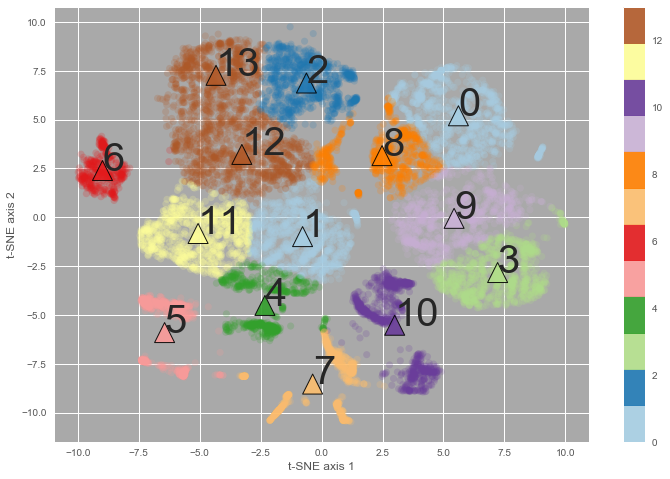

In [62]:
# ... k-means on the t-sne vectors

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = tsne_results[:,0]
X_tsne['t2'] = tsne_results[:,1]

for n_lda in range(2, 15):  

    tic = time.clock()
    
    print ("n_lda = ", n_lda)

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    
    cls_lda.fit(X_tsne)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_

    kmeans_inertia = cls_lda.inertia_
    print ("inertia = ", kmeans_inertia)
    
    kmeans_silhouette = metrics.silhouette_score(X_tsne,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'KMeans - LDA features',
    'n_clusters' : n_lda,
    'inertia': kmeans_inertia,
    'silhouette': kmeans_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    tsne_tbl = tsne_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize=(12, 8));
    plt.subplot(111, axisbg='darkgrey');
    
    X_tsne_values = X_tsne.values;
    plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.Paired,
                s = 50,
                linewidths = 0,
                alpha = 0.20);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.Paired,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    
    for ii in range(n_lda) :                                       
        plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 40)
        print(ii, kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii)
    
    plt.xlabel('t-SNE axis 1')
    plt.ylabel('t-SNE axis 2');
    plt.grid(True);

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - 
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-



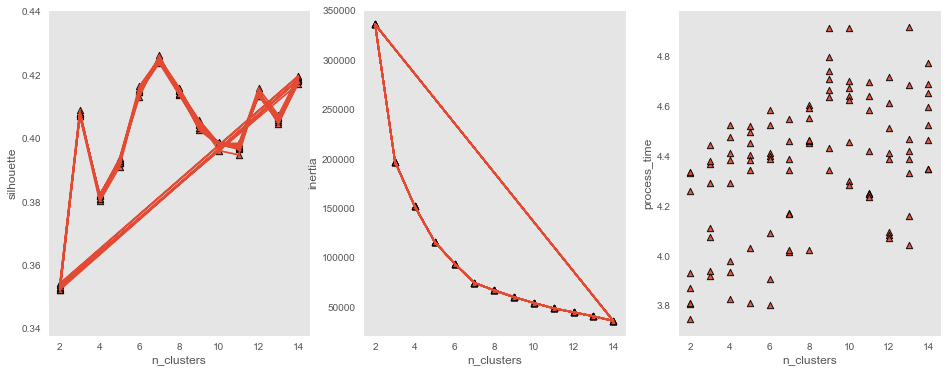

In [63]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(131);
plt.scatter(tsne_tbl['n_clusters'],
            tsne_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(tsne_tbl['n_clusters'],
         tsne_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.grid();

# ... inertia values

plt.subplot(132);
plt.scatter(tsne_tbl['n_clusters'],
            tsne_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(tsne_tbl['n_clusters'],
         tsne_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.grid();

# ... process time

plt.subplot(133);
plt.scatter(tsne_tbl['n_clusters'],
            tsne_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

#plt.plot(tsne_tbl['n_clusters'],
#         tsne_tbl['process_time'])

plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.grid();


plt.show();


### - choose kmeans clustering with preferred number of clusters  


n_lda =  12


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=12, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  44627.6868242
silhouette =  0.413521


0 -4.34527255423 6.95818749581 0


1 -0.722907644539 -1.15017332885 1


2 4.80835046659 4.40694116143 2


3 -4.93481727996 -0.938318440004 3


4 6.8547541606 -1.6861982693 4


5 1.16344949256 -8.4678321362 5


6 -2.37059725776 -5.49022615084 6


7 -2.48419946447 2.97012602711 7


8 -8.68582447264 2.50114440415 8


9 -6.47146285141 -5.87470115427 9


10 3.0220386814 -3.41295025505 10


11 -0.56434323678 6.80437769095 11
[ 9  3  9 ..., 11  3  4]
[[-4.34527255  6.9581875 ]
 [-0.72290764 -1.15017333]
 [ 4.80835047  4.40694116]
 [-4.93481728 -0.93831844]
 [ 6.85475416 -1.68619827]
 [ 1.16344949 -8.46783214]
 [-2.37059726 -5.49022615]
 [-2.48419946  2.97012603]
 [-8.68582447  2.5011444 ]
 [-6.47146285 -5.87470115]
 [ 3.02203868 -3.41295026]
 [-0.56434324  6.80437769]]


(<matplotlib.text.Text at 0x7fe40936cc18>,
 <matplotlib.text.Text at 0x7fe409394cc0>)

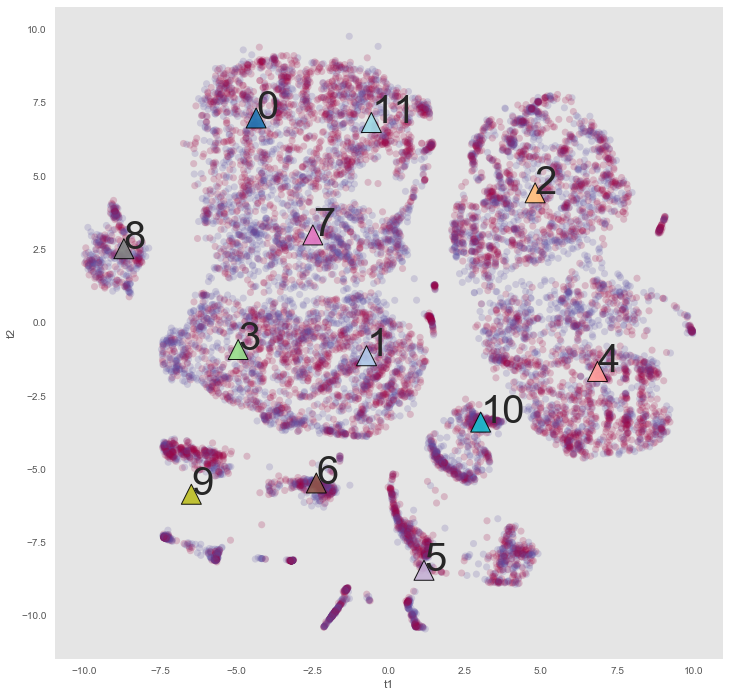

In [95]:

n_clusters_chosen = 12

for n_lda in range (n_clusters_chosen, n_clusters_chosen+1) :

    tic = time.clock()
    
    print ("n_lda = ", n_lda)

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    
    cls_lda.fit(X_tsne)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_

    kmeans_inertia = cls_lda.inertia_
    print ("inertia = ", kmeans_inertia)
    
    kmeans_silhouette = metrics.silhouette_score(X_tsne,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize=(12, 12));
    ax = plt.gca();
    
    X_tsne_values = X_tsne.values;
    plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = X1_popular,
                cmap = plt.cm.Spectral,
                s = 50,
                linewidths = 0,
                alpha = 0.20);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.tab20,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);    
    for ii in range(n_lda) :                                       
        plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 40)
        print(ii, kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii)

    print(kmeans_labels)
    print(kmeans_centers)
    
    
    plt.xlabel('t1'), plt.ylabel('t2');
    plt.grid();

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - print out comparison table
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-




In [66]:
len(kmeans_labels)
len(tsne_results)
len(X1)

11893

11893

11893

In [96]:

X_all_together = copy.deepcopy(X1)

len(X_all_together)

X_all_together['ln_shares'] = X1_ln_shares
X_all_together['popular'] = X1_popular
X_all_together['kmeans_labels'] = kmeans_labels


X_all_together['t1'] = tsne_results[:,0]
X_all_together['t2'] = tsne_results[:,1]

X_all_together.describe().T;


In [97]:
col_names = X_all_together.columns.values.tolist()


In [7]:
# boxplot across clusters for each feature ...

col_names = df_tsne.columns.values.tolist()

for col in col_names :
    
    plt.figure(figsize=(12, 8));
    
# ... feature distribution color map 

    plt.subplot(131, axisbg='darkgrey');
    plt.scatter(X_all_together['t1'], X_all_together['t2'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
#    plt.colorbar()
    
# ... cluster color map

    plt.subplot(132, axisbg='darkgrey');
    plt.scatter(X_all_together['t1'], X_all_together['t2'],
                 c = kmeans_labels,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.tab20b,
                s = 200,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);    
    for ii in range(n_lda) :                                       
        plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 20)
    plt.xlabel('t-SNE axis 1')
    plt.ylabel('t-SNE axis 2')
    plt.title(col)

    # ... feature boxplots 
    
#    plt.subplot(133);
#    bx_plt_data = X_all_together.groupby('kmeans_labels')
#    plt.boxplot(bx_plt_data)

    plt.show();
    

NameError: name 'df_tsne' is not defined

In [94]:
bx_plt_data = X_all_together.groupby('kmeans_labels')
bx_plt_data

bx_plt_data.describe().T

kmeans_labels                               0            1            2  \
abs_title_subjectivity     count  1954.000000  1813.000000  1351.000000   
                           mean      0.342157     0.348586     0.355655   
                           std       0.189257     0.186967     0.186592   
                           min       0.000000     0.000000     0.000000   
                           25%       0.166667     0.166667     0.166667   
                           50%       0.500000     0.500000     0.500000   
                           75%       0.500000     0.500000     0.500000   
                           max       0.500000     0.500000     0.500000   
data_channel_n             count  1954.000000  1813.000000  1351.000000   
                           mean      5.825998     6.200772     4.633605   
                           std       1.208614     1.049261     1.660351   
                           min       1.000000     1.000000     1.000000   
                           25%       5.000000     6.000000     4.000000   
                           50%       6.000000     6.000000     5.000000   
                           75%       7.000000     7.000000     6.000000   
                           max       7.000000     7.000000     7.000000   
global_rate_positive_words count  1954.000000  1813.000000  1351.000000   
                           mean      0.036570     0.037631     0.043518   
                           std       0.016350     0.014677     0.016750   
                           min       0.000000     0.000000     0.000000   
                           25%       0.025241     0.027190     0.031939   
                           50%       0.034483     0.036481     0.042781   
                           75%       0.045820     0.047170     0.053892   
                           max       0.118750     0.105023     0.115942   
global_subjectivity        count  1954.000000  1813.000000  1351.000000   
                           mean      0.447500     0.439775     0.479406   
                           std       0.097421     0.081461     0.089501   
                           min       0.000000     0.133333     0.108838   
                           25%       0.381755     0.388579     0.423212   
                           50%       0.445315     0.443186     0.478817   
...                                       ...          ...          ...   
rate_positive_words        std       0.159939     0.149051     0.148254   
                           min       0.000000     0.000000     0.000000   
                           25%       0.571429     0.600000     0.650000   
                           50%       0.681818     0.709302     0.745455   
                           75%       0.785714     0.800000     0.823529   
                           max       1.000000     1.000000     1.000000   
t1                         count  1954.000000  1813.000000  1351.000000   
                           mean     -1.321220     4.657845    -6.454998   
                           std       1.445940     1.770292     1.897817   
                           min      -4.516392     0.617022    -9.983528   
                           25%      -2.403664     3.310823    -8.481771   
                           50%      -1.248012     4.549400    -6.012424   
                           75%      -0.193706     5.968730    -4.886455   
                           max       1.529113     9.087383    -3.168415   
t2                         count  1954.000000  1813.000000  1351.000000   
                           mean     -0.342106     4.468728     1.394546   
                           std       1.848397     1.600217     1.798380   
                           min      -3.906058     0.998299    -2.128301   
                           25%      -1.768988     3.146281    -0.185233   
                           50%      -0.515659     4.351022     1.877557   
                           75%       0.897438     5.861271     2.815490   
                         

<a href='#toc'> Table of Contents</a>

<a name='end_of_file'></a>
<font color="blue" size=3>  end of file